In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib
import pandas as pd

from IPython.display import Image, display
import glob

#setting matplotlib parameters
matplotlib.rc('xtick', labelsize=14) 
matplotlib.rc('ytick', labelsize=14)


In [2]:
#set matplotlib global font size
matplotlib.rcParams['font.size']=14

In [3]:
def display_images(df, QA_path):
    flen= len(df['filename'].values)

    filenames = df['filename'].values
    tags = df['tags'].values

    print('About to show 4 * {} images, proceed? (y/n)'.format(flen))

    dec = input()

    if dec == 'y' or dec == 'Y':


        for filename, tag in zip(filenames, tags):

            fname = filename[:-5]
            
            fpath = QA_path + fname

            fpath1 = fpath + '/*standardComparison*'
            fpath2 = fpath + '/*spec*'
            fpath3 = fpath + '/Halpha_EW_measurement*'
            fpath4 = fpath + '/LiI_EW_measurement*'

            file1 = glob.glob(fpath1)[0]
            file2 = glob.glob(fpath2)[0]
            file3 = glob.glob(fpath3)[0]
            file4 = glob.glob(fpath4)[0]

            display(Image(filename=file1), Image(filename=file2), Image(filename=file3), Image(filename=file4))

            print(filename)
            print(tag)

    else:
        return

In [4]:
def find_in_tag_arr(df, qtag):
    tag_arr = np.array([ ( (tag is not np.nan ) and ( qtag in tag ) ) for tag in df['tags'].values ])
    
    return tag_arr

In [5]:
QA_path = '/home/ryan/projects/CoolStars/paper/png/20200716/'
dfa = pd.read_csv('/home/ryan/projects/CoolStars/paper/csv/Kastclassify_spectra_calculations_20200716 - Kastclassify_spectra_calculations_20200716.csv')

In [6]:
dfa

,name,filename,tags,RA,DEC,OBSDATE,spt,subtype,spt_chi2,spt_scale,...,gizis_CaH2_spt_err,gizis_CaH3_spt,gizis_CaH3_spt_err,lepine_spt,lepine_spt_err,zeta,zeta_err,metallicity_class,L_Halpha/L_bol,L_Halpha/L_bol_err
0,J0225+6229,kastRED_J0225+6229_20200203.fits,"lto, scq, spt_fixed",2:25:26,62:29:58,2020-02-04T02:55:25.18,M7.0,7.0,6.041301e+05,5.880000e-15,...,0.054384,5.110205,0.126098,4.567336,0.064775,1.076942,0.010493,Dwarf,-4.28E-05,1.99E-07
1,J1300+3038,kastRED_J1300+3038_20200305.fits,None,13:00:07,30:38:58,2020-03-06T11:10:41.12,M6.0,6.0,8.623883e+04,7.330000e-15,...,0.062521,6.924109,0.114539,5.801550,0.058665,0.971940,0.008203,Dwarf,-6.89E-05,8.84E-08
2,J1733+1655,kastRED_J1733+1655_20180717.fits,None,17:33:53,16:55:13,2018-07-18T08:19:45.17,M6.0,6.0,1.646057e+06,3.040000e-13,...,0.008222,4.898452,0.018464,4.293615,0.009145,1.037346,0.001561,Dwarf,-0.0001158947319,1.44E-07
3,J0813-1522,kastRED_J0813-1522_20200204.fits,"lto, !",8:13:19,-15:22:38,2020-02-05T07:12:29.07,M5.0,5.0,2.849465e+05,3.370000e-14,...,0.025675,2.512415,0.047323,2.393990,0.024869,1.022973,0.007507,Dwarf,-9.46E-05,1.82E-07
4,J0120+3302,kastRED_J0120+3302_20190918.fits,None,1:20:29,33:02:39,2019-09-18T09:34:34.14,M7.0,7.0,1.263492e+05,9.930000e-15,...,0.054607,5.503352,0.069161,4.878508,0.044596,1.037826,0.007411,Dwarf,-6.02E-05,2.25E-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236,J0730-0339,kastRED_J0730-0339B_20200206.fits,"S/N, NO",7:30:30,-3:39:34,2020-02-07T08:52:25.85,M0.0,0.0,8.711075e+03,6.140000e-17,...,4.334505,-13.666174,19.884730,-4.574286,6.454904,-4.601281,30.116135,usd,-0.0001931698224,7.12E-07
237,0002+0115,kastRED_J0002+0115_20170813.fits,None,0:02:07,1:15:36,2017-08-13T09:55:11.60,M9.0,9.0,3.030489e+05,7.350000e-15,...,0.043697,4.851991,0.096675,4.484323,0.040508,1.077229,0.007425,Dwarf,-2.79E-05,3.09E-08
238,2340+3433,kastRED_J2340+3433_20170813.fits,None,23:40:23,34:33:15,2017-08-13T08:15:13.38,M6.0,6.0,4.024712e+05,5.900000e-14,...,0.023647,4.246150,0.053451,3.866284,0.024603,1.043384,0.004994,Dwarf,-3.41E-05,2.79E-08
239,0914+1809,kastRED_J0914+1809_20180307.fits,None,9:14:41,18:09:44,2018-03-07T06:46:56.69,M5.0,5.0,1.787404e+04,9.350000e-15,...,0.139273,4.309733,0.234214,3.482445,0.127881,1.163668,0.035658,Dwarf,-5.36E-05,3.45E-07


In [7]:
dfa['tags'].values

array(['lto, scq, spt_fixed', 'None', 'None', 'lto, !', 'None', 'lto',
       'None', 'S/N, OO', 'OO', 'None', 'S/N, NO', 'lto', 'S/N, NO',
       'None', 'None', 'None', 'S/N, NO', 'lto', 'None', 'None',
       'lto, scq, spt_fixed', 'lto', 'None', 'S/N, NO', 'lto, S/N, scq',
       'None', 'None', 'None', '!, lto', 'None', 'S/N, NO', 'lto, S/N',
       'S/N, NO', 'None', '!, lto', 'lto, scq, spt_fixed', 'S/N, NO',
       'lto, scq, !', 'None', 'S/N, OO, ?', 'S/N, NO', 'lto', 'None',
       'None', 'None', 'None', 'None', 'lto, S/N', 'OO', 'S/N, NO',
       'None', 'None', 'None', 'S/N, NO', 'OO', 'None',
       'lto, scq, spt_fixed', 'None', 'lto, S/N, scq', 'None', 'None',
       'None', 'S/N, NO', 'None', 'None', 'None', 'None', 'None', 'None',
       'None', 'None', 'None', 'S/N, NO', 'lto, S/N', 'S/N, NO', 'None',
       'OO', 'lto, S/N, scq, ?', 'lto', 'None', 'lto, mcq, !',
       'lto, scq, spt_fixed, !', 'None', 'None', 'OO', 'OO, !', 'None',
       'lto, S/N, scq, ?', 'None'

In [8]:
arr = find_in_tag_arr(dfa, 'scq')

display_images(dfa[arr], QA_path)

About to show 2 * 20 images, proceed? (y/n)
n


In [8]:
arr1 = find_in_tag_arr(dfa, 'NO')
arr2 = find_in_tag_arr(dfa, 'OO')

truth_arr = ~(arr1 | arr2)

truth_arr

array([ True,  True,  True,  True,  True,  True,  True, False, False,
        True, False,  True, False,  True,  True,  True, False,  True,
        True,  True,  True,  True,  True, False,  True,  True,  True,
        True,  True,  True, False,  True, False,  True,  True,  True,
       False,  True,  True, False, False,  True,  True,  True,  True,
        True,  True,  True, False, False,  True,  True,  True, False,
       False,  True,  True,  True,  True,  True,  True,  True, False,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
       False,  True, False,  True, False,  True,  True,  True,  True,
        True,  True,  True, False, False,  True,  True,  True,  True,
        True, False,  True,  True, False,  True, False,  True,  True,
       False,  True,  True,  True, False,  True, False,  True,  True,
        True,  True, False, False, False,  True,  True,  True, False,
        True,  True,  True,  True, False, False,  True, False,  True,
        True,  True,

In [13]:
display_images(dfa[ truth_arr ], QA_path)


About to show 2 * 179 images, proceed? (y/n)
n


In [9]:
df = dfa[truth_arr]

In [10]:
CaH1 = df['lepine2003_CaH1'].values
CaH1_err = df['lepine2003_CaH1_err'].values

CaH2 = df['lepine2003_CaH2'].values
CaH2_err = df['lepine2003_CaH2_err'].values
med_CaH2_err = np.median(CaH2_err)

CaH3 = df['lepine2003_CaH3'].values
CaH3_err = df['lepine2003_CaH3_err'].values
med_CaH3_err = np.median(CaH3_err)

TiO5 = df['lepine2003_TiO5'].values
TiO5_err = df['lepine2003_TiO5_err'].values
med_TiO5_err = np.median(TiO5_err)

spt = df['subtype'].values


In [11]:
CaH1_mod = []
CaH1_mod_err = []
for val, err in zip(CaH1, CaH1_err):
    try:
        res = float(val)
        res_err = float(err)
    except:
        res = np.nan
        res_err = np.nan
    CaH1_mod.append(res)
    CaH1_mod_err.append(res_err)
    
CaH1 = np.array(CaH1_mod)
CaH1_err = np.array(CaH1_mod_err)
med_CaH1_err = np.nanmedian(CaH1_err)

med_CaH1_err

0.012227850265

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in less
  
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in less
  import sys
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in greater
  if __name__ == '__main__':
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in greater
  # Remove the CWD from sys.path while we load stuff.
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in greater
  # This is added back by InteractiveShellApp.init_path()
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in greater
  if sys.path[0] == '':


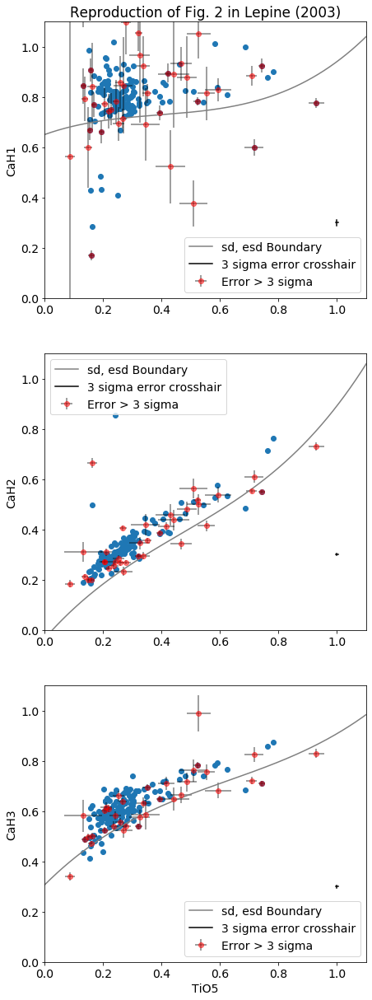

In [12]:
fig, ax = plt.subplots(3,1, figsize=[7,21])

x = np.linspace(0,1.5,1000)

ax[0].set_title('Reproduction of Fig. 2 in Lepine (2003)')
ax[0].scatter(TiO5[ (TiO5_err < 3 * med_TiO5_err) | (CaH1_err < 3 * med_CaH1_err) ],\
              CaH1[ (TiO5_err < 3 * med_TiO5_err) | (CaH1_err < 3 * med_CaH1_err) ],\
             )
ax[0].errorbar(TiO5[ (TiO5_err > 3 * med_TiO5_err) | (CaH1_err > 3 * med_CaH1_err) ],\
              CaH1[ (TiO5_err > 3 * med_TiO5_err) | (CaH1_err > 3 * med_CaH1_err) ],\
              yerr=CaH1_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH1_err > 3 * med_CaH1_err) ],\
              xerr=TiO5_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH1_err > 3 * med_CaH1_err) ],\
              fmt='ro', ecolor='k', alpha=0.5, label='Error > 3 sigma')
ax[0].set_xlim(0, 1.1)
ax[0].set_ylim(0,1.1)
ax[0].set_ylabel('CaH1')

ax[0].plot(x, 0.695 * x**3 - 0.818 * x**2 + 0.413 * x + 0.651, color='gray', label='sd, esd Boundary')

ax[0].plot([1 - med_TiO5_err, 1 + med_TiO5_err], [0.3, 0.3], color='k', label='3 sigma error crosshair')
ax[0].plot([1, 1], [0.3- med_CaH1_err, 0.3 + med_CaH1_err], color='k')

ax[0].legend()

ax[1].scatter(TiO5[ (TiO5_err < 3 * med_TiO5_err) | (CaH2_err < 3 * med_CaH2_err) ],\
              CaH2[ (TiO5_err < 3 * med_TiO5_err) | (CaH2_err < 3 * med_CaH2_err) ],\
             )
ax[1].errorbar(TiO5[ (TiO5_err > 3 * med_TiO5_err) | (CaH2_err > 3 * med_CaH2_err) ],\
              CaH2[ (TiO5_err > 3 * med_TiO5_err) | (CaH2_err > 3 * med_CaH2_err) ],\
              yerr=CaH2_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH2_err > 3 * med_CaH2_err) ],\
              xerr=TiO5_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH2_err > 3 * med_CaH2_err) ],\
              fmt='ro', ecolor='k', alpha=0.5, label='Error > 3 sigma')
ax[1].set_xlim(0, 1.1)
ax[1].set_ylim(0,1.1)
ax[1].set_ylabel('CaH2')

ax[1].plot(x, 0.968 * x**3 - 1.358 * x**2 + 1.315 * x - 0.033, color='gray', label='sd, esd Boundary')

ax[1].plot([1 - med_TiO5_err, 1 + med_TiO5_err], [0.3, 0.3], color='k', label='3 sigma error crosshair')
ax[1].plot([1, 1], [0.3- med_CaH2_err, 0.3 + med_CaH2_err], color='k')

ax[1].legend()

ax[2].scatter(TiO5[ (TiO5_err < 3 * med_TiO5_err) | (CaH3_err < 3 * med_CaH3_err) ],\
              CaH3[ (TiO5_err < 3 * med_TiO5_err) | (CaH3_err < 3 * med_CaH3_err) ],\
             )
ax[2].errorbar(TiO5[ (TiO5_err > 3 * med_TiO5_err) | (CaH3_err > 3 * med_CaH3_err) ],\
              CaH3[ (TiO5_err > 3 * med_TiO5_err) | (CaH3_err > 3 * med_CaH3_err) ],\
              yerr=CaH3_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH3_err > 3 * med_CaH3_err) ],\
              xerr=TiO5_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH3_err > 3 * med_CaH3_err) ],\
              fmt='ro', ecolor='k', alpha=0.5, label='Error > 3 sigma')
ax[2].set_xlim(0, 1.1)
ax[2].set_ylim(0,1.1)
ax[2].set_ylabel('CaH3')

ax[2].plot(x, 0.639 * x**3 - 1.199 * x**2 + 1.161 * x + 0.307, color='gray', label='sd, esd Boundary')
ax[2].plot([1 - med_TiO5_err, 1 + med_TiO5_err], [0.3, 0.3], color='k', label='3 sigma error crosshair')
ax[2].plot([1, 1], [0.3- med_CaH3_err, 0.3 + med_CaH3_err], color='k')

ax[2].set_xlabel('TiO5')

ax[2].legend()

fig.savefig('Lepine_TiO5_relation.png')

plt.show()

Text(0.5, 0, 'TiO5')

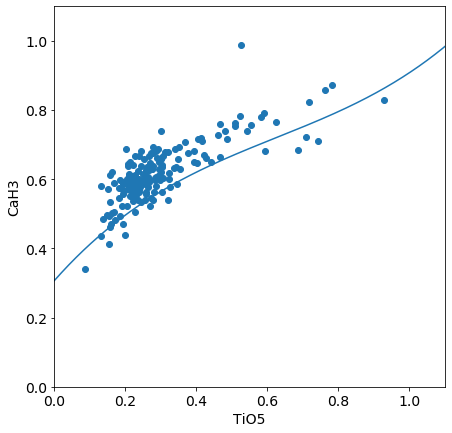

In [17]:
x = np.linspace(0,1.5,1000)

fig, ax = plt.subplots(1,1, figsize=[7,7])
#ax.set_title('Reproduction of Fig. 2 in Lepine (2003)')
ax.scatter(TiO5, CaH3)

ax.plot(x, 0.639 * x**3 - 1.199 * x**2 + 1.161 * x + 0.307)

ax.set_xlim(0, 1.1)
ax.set_ylim(0,1.1)
ax.set_ylabel('CaH3')
ax.set_xlabel('TiO5')
#fig.savefig('Lepine_TiO5_relation_2.png')

Text(0, 0.5, 'CaH2')

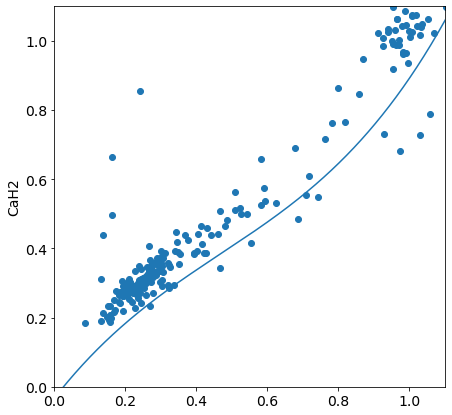

In [11]:
fig, ax = plt.subplots(1,1, figsize=[7,7])
#ax.set_title('Reproduction of Fig. 2 in Lepine (2003)')
ax.scatter(TiO5, CaH2)

ax.plot(x, 0.968 * x**3 - 1.358 * x**2 + 1.315 * x - 0.033)

ax.set_xlim(0, 1.1)
ax.set_ylim(0,1.1)
ax.set_ylabel('CaH2')
#fig.savefig('Lepine_TiO5_relation_1.png')

Text(0, 0.5, 'CaH1')

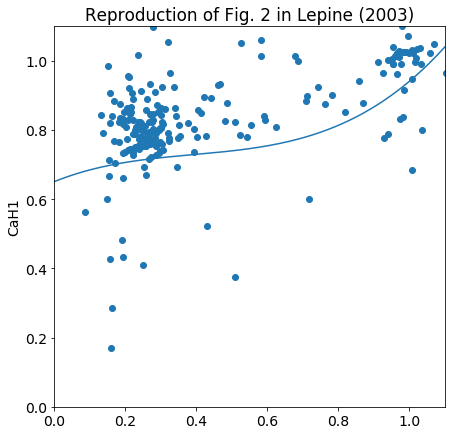

In [12]:
fig, ax = plt.subplots(1,1, figsize=[7,7])
ax.set_title('Reproduction of Fig. 2 in Lepine (2003)')
ax.scatter(TiO5, CaH1)

ax.plot(x, 0.695 * x**3 - 0.818 * x**2 + 0.413 * x + 0.651)

ax.set_xlim(0, 1.1)
ax.set_ylim(0,1.1)
ax.set_ylabel('CaH1')
#fig.savefig('Lepine_TiO5_relation_0.png')

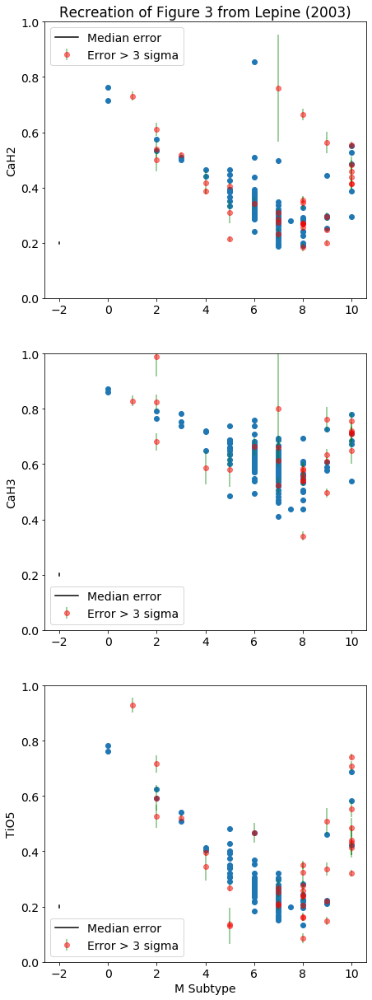

In [13]:
fig, ax = plt.subplots(3, 1, figsize=[7,21])

ax[0].scatter(spt[ (CaH2_err < 3 * med_CaH2_err) ], CaH2[ (CaH2_err < 3 * med_CaH2_err) ])
ax[0].errorbar(spt[ (CaH2_err > 3 * med_CaH2_err) ], CaH2[ (CaH2_err > 3 * med_CaH2_err)],\
               #xerr=0.5 * np.ones(len(CaH2_err[ (CaH2_err > 3 * med_CaH2_err) ])),\
               yerr=CaH2_err[ (CaH2_err > 3 * med_CaH2_err) ],\
               fmt='ro', ecolor='g', alpha=0.5, label='Error > 3 sigma')
ax[0].set_ylim(0, 1)
#ax[0].set_xlabel('M Subtype')
ax[0].set_ylabel('CaH2')
ax[0].set_title('Recreation of Figure 3 from Lepine (2003)')

#ax[0].plot( [-2 - 0.5, -2 + 0.5], [0.2, 0.2], color='k')
ax[0].plot( [-2, -2], [0.2 - med_CaH2_err, 0.2 + med_CaH2_err], color='k', label='Median error')
ax[0].legend()

ax[1].scatter(spt[ (CaH3_err < 3 * med_CaH3_err) ], CaH3[ (CaH3_err < 3 * med_CaH3_err) ])
ax[1].errorbar(spt[ (CaH3_err > 3 * med_CaH3_err) ], CaH3[ (CaH3_err > 3 * med_CaH3_err)],\
               #xerr=0.5 * np.ones(len(CaH2_err[ (CaH2_err > 3 * med_CaH2_err) ])),\
               yerr=CaH3_err[ (CaH3_err > 3 * med_CaH3_err) ],\
               fmt='ro', ecolor='g', alpha=0.5, label='Error > 3 sigma')
ax[1].set_ylim(0, 1)
#ax[1].set_xlabel('M Subtype')
ax[1].set_ylabel('CaH3')

#ax[0].plot( [-2 - 0.5, -2 + 0.5], [0.2, 0.2], color='k')
ax[1].plot( [-2, -2], [0.2 - med_CaH3_err, 0.2 + med_CaH3_err], color='k', label='Median error')
ax[1].legend()

ax[2].scatter(spt[ (TiO5_err < 3 * med_TiO5_err) ], TiO5[ (TiO5_err < 3 * med_TiO5_err) ])
ax[2].errorbar(spt[ (TiO5_err > 3 * med_TiO5_err) ], TiO5[ (TiO5_err > 3 * med_TiO5_err)],\
               #xerr=0.5 * np.ones(len(CaH2_err[ (CaH2_err > 3 * med_CaH2_err) ])),\
               yerr=TiO5_err[ (TiO5_err > 3 * med_TiO5_err) ],\
               fmt='ro', ecolor='g', alpha=0.5, label='Error > 3 sigma')
ax[2].set_ylim(0, 1)
ax[2].set_xlabel('M Subtype')
ax[2].set_ylabel('TiO5')

#ax[0].plot( [-2 - 0.5, -2 + 0.5], [0.2, 0.2], color='k')
ax[2].plot( [-2, -2], [0.2 - med_TiO5_err, 0.2 + med_TiO5_err], color='k', label='Median error')
ax[2].legend()

fig.savefig('Lepine_index_spt_relation.png')

plt.show()

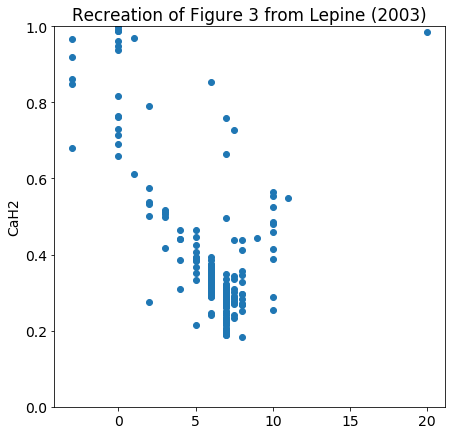

In [15]:
plt.figure(figsize=[7,7])
plt.scatter(spt, CaH2)
plt.title('Recreation of Figure 3 from Lepine (2003)')
plt.ylim(0, 1)
#plt.xlabel('M Subtype')
plt.ylabel('CaH2')

#plt.savefig('Lepine_spt_relation_0.png')
plt.show()

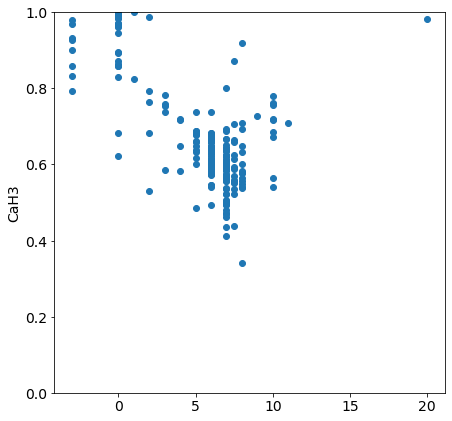

In [16]:
plt.figure(figsize=[7,7])
plt.scatter(spt, CaH3)
#plt.title('Recreation of Figure 3 from Lepine (2003)')
plt.ylim(0, 1)
#plt.xlabel('M Subtype')
plt.ylabel('CaH3')

#plt.savefig('Lepine_spt_relation_1.png')
plt.show()

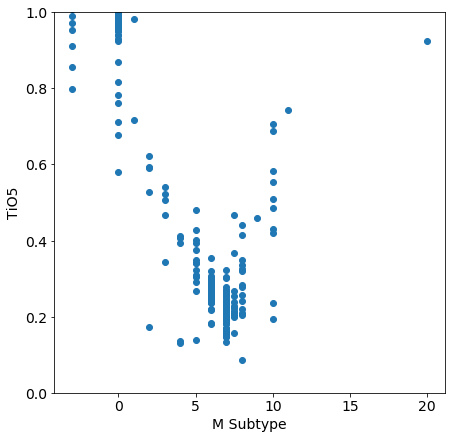

In [17]:
plt.figure(figsize=[7,7])
plt.scatter(spt, TiO5)
#plt.title('Recreation of Figure 3 from Lepine (2003)')
plt.ylim(0, 1)
plt.xlabel('M Subtype')
plt.ylabel('TiO5')

#plt.savefig('Lepine_spt_relation_2.png')
plt.show()

In [48]:
def y(x, z1):
    return 1.36179 - (250.22) * z1 * np.power(a * z1**2 - a * x * z1**2 - b * z1**3 + np.sqrt( (a - a*x - b*z1)**2 * z1**4 - \
     c*z1**6), -1/3) - \
    (1/z1)* (0.00161321) * np.power(a * z1**2 - a * x * z1**2 - b * z1**3 + np.sqrt( (a - a*x - b*z1)**2 * z1**4 - \
     c*z1**6), 1/3)

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in sqrt
  This is separate from the ipykernel package so we can avoid doing imports until
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in power
  This is separate from the ipykernel package so we can avoid doing imports until
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in sqrt
  """
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in power
  """


(0, 2.1)

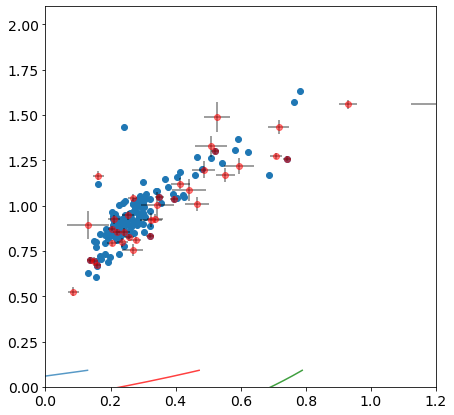

In [49]:
a = 9.0774 * 10**7
b = 3.47085 * 10**7
c = 3.73156 * 10**15

z1 = 0.2

z2 = 0.5

z3 = 0.825

CaH = CaH2 + CaH3

CaH_err = np.sqrt(CaH2_err**2 + CaH3_err**2)

med_CaH_err = np.nanmedian(CaH_err)

plt.figure(figsize=[7, 7])

plt.scatter(TiO5[ (TiO5_err < 3 * med_TiO5_err) | (CaH_err < 3 * med_CaH_err) ],\
              CaH[ (TiO5_err < 3 * med_TiO5_err) | (CaH_err < 3 * med_CaH_err) ],\
             )
plt.errorbar(TiO5[ (TiO5_err > 3 * med_TiO5_err) | (CaH_err > 3 * med_CaH_err) ],\
              CaH[ (TiO5_err > 3 * med_TiO5_err) | (CaH_err > 3 * med_CaH_err) ],\
              yerr=CaH_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH_err > 3 * med_CaH_err) ],\
              xerr=TiO5_err[ (TiO5_err > 3 * med_TiO5_err) | (CaH_err > 3 * med_CaH_err) ],\
              fmt='ro', ecolor='k', alpha=0.5, label='Error > 3 sigma')

x = np.linspace(0, 1.5, 10000)

y1 = y(x, z1)
y2 = y(x, z2)
y3 = y(x, z3)

plt.plot(x, y1, alpha=0.75, color='g')
plt.plot(x, y2, alpha=0.75, color='r')
plt.plot(x, y3, alpha=0.75)

plt.xlim(0, 1.2)
plt.ylim(0, 2.1)



In [13]:
Rba = df['kirkpatrick_Rb-a'].values

In [14]:
Rbb = df['kirkpatrick_Rb-b'].values

In [15]:
Naa = df['kirkpatrick_Na-a'].values

In [16]:
Nab = df['kirkpatrick_Na-b'].values

In [17]:
Csa = df['kirkpatrick_Cs-a'].values

In [18]:
Csb = df['kirkpatrick_Cs-b'].values

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


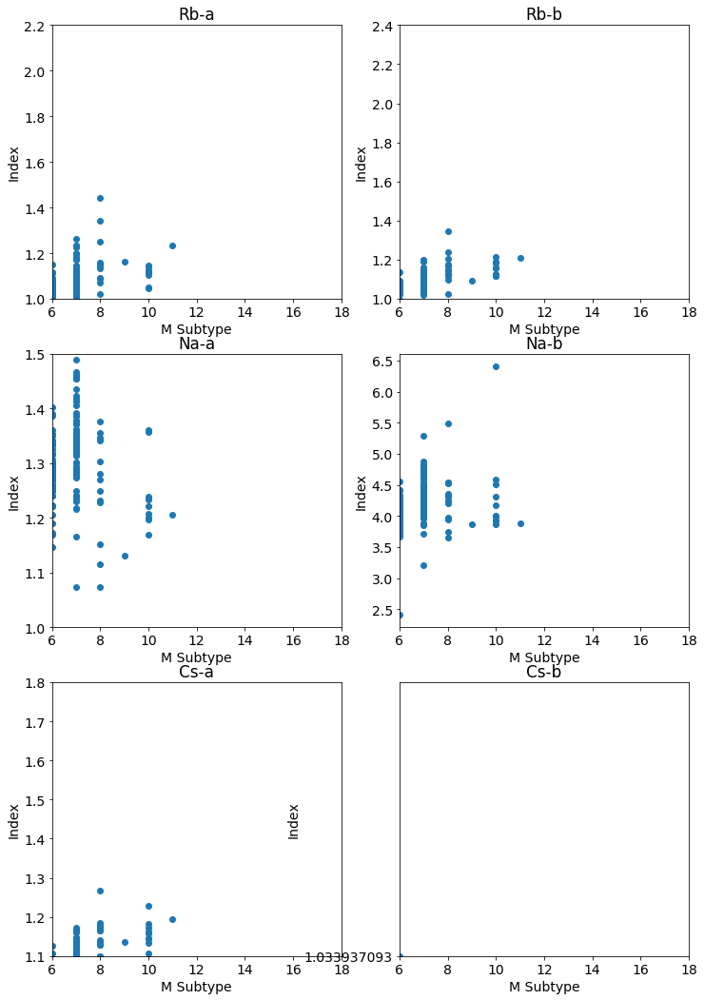

In [19]:

fig, ax = plt.subplots(3,2, figsize=[12, 18])


for axis in ax:
    for a in axis:
        a.set_xlim(6, 18)
        a.set_xlabel('M Subtype')
        a.set_ylabel('Index')

ax[0][0].scatter(spt, Rba)
ax[0][0].set_title('Rb-a')
ax[0,0].set_ylim(1, 2.2)

ax[0][1].scatter(spt, Rbb)
ax[0,1].set_title('Rb-b')
ax[0,1].set_ylim(1, 2.4)

ax[1][0].scatter(spt, Naa)
ax[1,0].set_title('Na-a')
ax[1,0].set_ylim(1, 1.5)

ax[1][1].scatter(spt, Nab)
ax[1,1].set_title('Na-b')
#ax[1,1].set_ylim(1, 1.6)

ax[2][0].scatter(spt, Csa)
ax[2,0].set_title('Cs-a')
ax[2,0].set_ylim(1.1, 1.8)

ax[2][1].scatter(spt, Csb)
ax[2,1].set_title('Cs-b')
ax[2,1].set_ylim(1, 1.5)

#fig.savefig('kirkpatrick_alkali_lines.png')

fig.show()

In [20]:
TiOa = df['kirkpatrick_TiO-a'].values
TiOb = df['kirkpatrick_TiO-b'].values
VOa = df['kirkpatrick_VO-a'].values
VOb = df['kirkpatrick_VO-b'].values

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


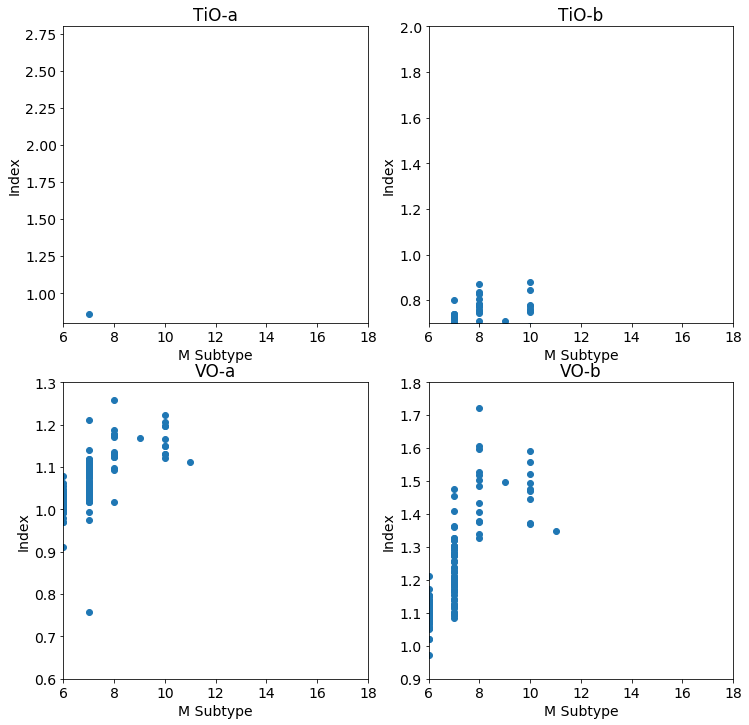

In [21]:
fig, ax = plt.subplots(2,2, figsize=[12, 12])


for axis in ax:
    for a in axis:
        a.set_xlim(6, 18)
        a.set_xlabel('M Subtype')
        a.set_ylabel('Index')
        
ax[0,0].scatter(spt, TiOa)
ax[0,0].set_title('TiO-a')
ax[0,0].set_ylim(0.8, 2.8)

ax[0,1].scatter(spt, TiOb)
ax[0,1].set_title('TiO-b')
ax[0,1].set_ylim(0.7, 2)

ax[1, 0].scatter(spt, VOa)
ax[1,0].set_title('VO-a')
ax[1,0].set_ylim(0.6,1.3)

ax[1,1].scatter(spt, VOb)
ax[1,1].set_title('VO-b')
ax[1,1].set_ylim(0.9, 1.8)

#fig.savefig('kirkpatrick_oxide_ratios.png')

fig.show()

In [22]:
CrHa = df['kirkpatrick_CrH-a'].values
CrHb = df['kirkpatrick_CrH-b'].values
FeHa = df['kirkpatrick_FeH-a'].values
FeHb = df['kirkpatrick_FeH-b'].values

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


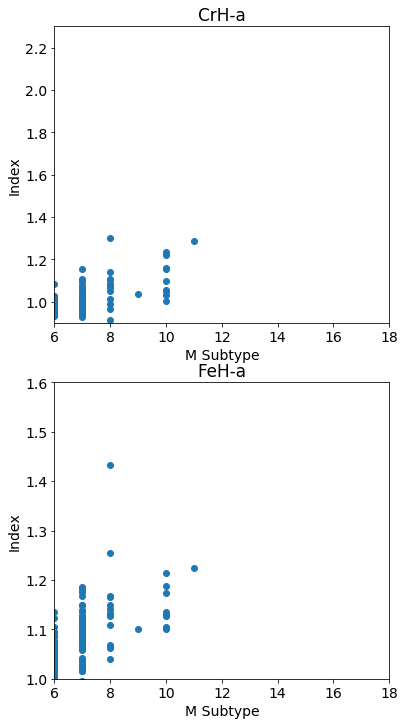

In [23]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=[6, 12])

ax1.scatter(spt, CrHa)
ax1.set_title('CrH-a')
ax1.set_xlim(6, 18)
ax1.set_ylim(0.9, 2.3)
ax1.set_ylabel('Index')
ax1.set_xlabel('M Subtype')

ax2.scatter(spt, FeHa)
ax2.set_title('FeH-a')
ax2.set_xlim(6, 18)
ax2.set_ylim(1, 1.6)
ax2.set_ylabel('Index')
ax2.set_xlabel('M Subtype')

#fig.savefig('kirkpatrick_hydride_ratios.png')

fig.show()

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


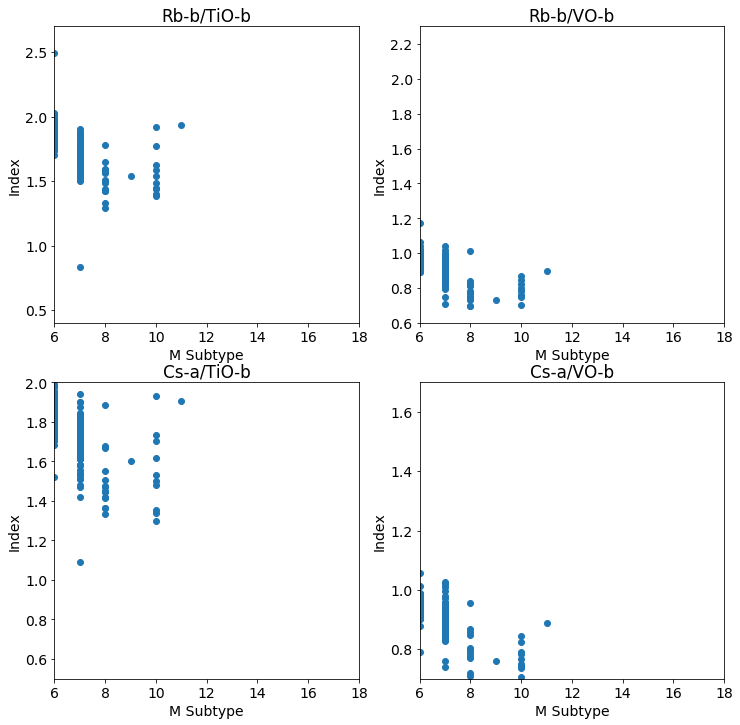

In [24]:
fig, ax = plt.subplots(2,2, figsize=[12, 12])


for axis in ax:
    for a in axis:
        a.set_xlim(6, 18)
        a.set_xlabel('M Subtype')
        a.set_ylabel('Index')
        
ax[0,0].scatter(spt, Rbb/TiOb)
ax[0,0].set_title('Rb-b/TiO-b')
ax[0,0].set_ylim(0.4, 2.7)

ax[0,1].scatter(spt, Rbb/VOb)
ax[0,1].set_title('Rb-b/VO-b')
ax[0,1].set_ylim(0.6, 2.3)

ax[1, 0].scatter(spt, Csa/TiOb)
ax[1,0].set_title('Cs-a/TiO-b')
ax[1,0].set_ylim(0.5,2)

ax[1,1].scatter(spt, Csa/VOb)
ax[1,1].set_title('Cs-a/VO-b')
ax[1,1].set_ylim(0.7, 1.7)

#fig.savefig('kirkpatrick_alkali_oxide_ratio.png')

fig.show()

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:87: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


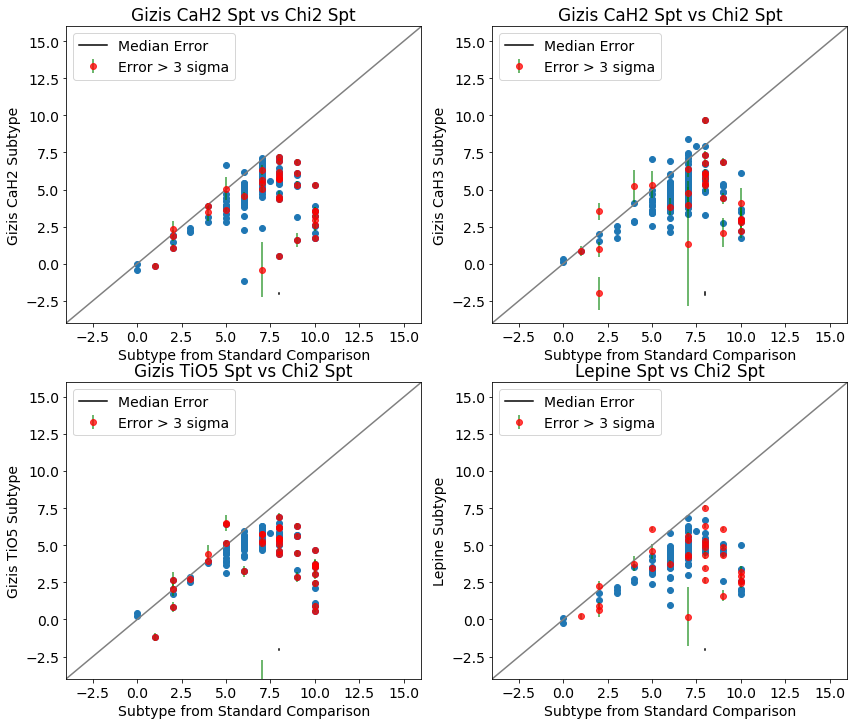

In [14]:
CaH = CaH2 + CaH3

CaH_err = np.sqrt(CaH2_err**2 + CaH3_err**2)

lepine_spt = df['lepine_spt']
lepine_spt_err = df['lepine_spt_err']
med_lepine_spt_err = np.nanmedian(lepine_spt_err)

gizis_CaH2_spt = df['gizis_CaH2_spt'].values
gizis_CaH2_spt_err = df['gizis_CaH2_spt_err'].values
med_gizis_CaH2_spt_err = np.nanmedian(gizis_CaH2_spt_err)

gizis_CaH3_spt = df['gizis_CaH3_spt'].values
gizis_CaH3_spt_err = df['gizis_CaH3_spt_err'].values
med_gizis_CaH3_spt_err = np.nanmedian(gizis_CaH3_spt_err)

gizis_TiO5_spt = df['gizis_TiO5_spt'].values
gizis_TiO5_spt_err = df['gizis_TiO5_spt_err'].values
med_gizis_TiO5_spt_err = np.nanmedian(gizis_TiO5_spt_err)

fig, ax = plt.subplots(2,2, figsize=[14, 12])

arr = np.linspace(-5, 100, 10000)

for axis in ax:
    
    for a in axis:
        
        a.plot(arr, arr, color='gray')
        a.set_xlabel('Subtype from Standard Comparison')
        a.set_ylim(-4, 16)
        a.set_xlim(-4, 16)

ax[0,0].scatter(spt[(gizis_CaH2_spt_err < 3 * med_gizis_CaH2_spt_err) | (gizis_CaH2_spt_err < 0.5)],\
                gizis_CaH2_spt[(gizis_CaH2_spt_err < 3 * med_gizis_CaH2_spt_err) | (gizis_CaH2_spt_err < 0.5)])
ax[0,0].errorbar(spt[(gizis_CaH2_spt_err > 3 * med_gizis_CaH2_spt_err) | (gizis_CaH2_spt_err > 0.5)],\
                gizis_CaH2_spt[(gizis_CaH2_spt_err > 3 * med_gizis_CaH2_spt_err) | (gizis_CaH2_spt_err > 0.5)],\
                yerr=gizis_CaH2_spt_err[(gizis_CaH2_spt_err > 3 * med_gizis_CaH2_spt_err) | (gizis_CaH2_spt_err > 0.5)],\
                fmt='ro', ecolor='g', label='Error > 3 sigma', alpha=0.75)

ax[0,0].plot([8,8], [-2 - med_gizis_CaH2_spt_err, -2 + med_gizis_CaH2_spt_err], color='k', label='Median Error')
ax[0,0].legend()

ax[0,0].set_ylabel('Gizis CaH2 Subtype')
ax[0,0].set_title('Gizis CaH2 Spt vs Chi2 Spt')


ax[0,1].scatter(spt[(gizis_CaH3_spt_err < 3 * med_gizis_CaH3_spt_err) | (gizis_CaH3_spt_err < 0.5)],\
                gizis_CaH3_spt[(gizis_CaH3_spt_err < 3 * med_gizis_CaH3_spt_err) | (gizis_CaH3_spt_err < 0.5)])
ax[0,1].errorbar(spt[(gizis_CaH3_spt_err > 3 * med_gizis_CaH3_spt_err) | (gizis_CaH3_spt_err > 0.5)],\
                gizis_CaH3_spt[(gizis_CaH3_spt_err > 3 * med_gizis_CaH3_spt_err) | (gizis_CaH3_spt_err > 0.5)],\
                yerr=gizis_CaH3_spt_err[(gizis_CaH3_spt_err > 3 * med_gizis_CaH3_spt_err) | (gizis_CaH3_spt_err > 0.5)],\
                fmt='ro', ecolor='g', label='Error > 3 sigma', alpha=0.75)

ax[0,1].plot([8,8], [-2 - med_gizis_CaH3_spt_err, -2 + med_gizis_CaH3_spt_err], color='k', label='Median Error')
ax[0,1].legend()

ax[0,1].set_ylabel('Gizis CaH3 Subtype')
ax[0,1].set_title('Gizis CaH2 Spt vs Chi2 Spt')

ax[1,0].scatter(spt[(gizis_TiO5_spt_err < 3 * med_gizis_TiO5_spt_err) | (gizis_TiO5_spt_err < 0.5)],\
                gizis_TiO5_spt[(gizis_TiO5_spt_err < 3 * med_gizis_TiO5_spt_err) | (gizis_TiO5_spt_err < 0.5)])
ax[1,0].errorbar(spt[(gizis_TiO5_spt_err > 3 * med_gizis_TiO5_spt_err) | (gizis_TiO5_spt_err > 0.5)],\
                gizis_TiO5_spt[(gizis_TiO5_spt_err > 3 * med_gizis_TiO5_spt_err) | (gizis_TiO5_spt_err > 0.5)],\
                yerr=gizis_TiO5_spt_err[(gizis_TiO5_spt_err > 3 * med_gizis_TiO5_spt_err) | (gizis_TiO5_spt_err > 0.5)],\
                fmt='ro', ecolor='g', label='Error > 3 sigma', alpha=0.75)

ax[1,0].plot([8,8], [-2 - med_gizis_TiO5_spt_err, -2 + med_gizis_TiO5_spt_err], color='k', label='Median Error')
ax[1,0].legend()
ax[1,0].set_ylabel('Gizis TiO5 Subtype')
ax[1,0].set_title('Gizis TiO5 Spt vs Chi2 Spt')

ax[1,1].scatter(spt[(lepine_spt_err < 3 * med_lepine_spt_err)],\
                lepine_spt[(lepine_spt_err < 3 * med_lepine_spt_err)])
ax[1,1].errorbar(spt[(lepine_spt_err > 3 * med_lepine_spt_err)],\
                lepine_spt[(lepine_spt_err > 3 * med_lepine_spt_err)],\
                yerr=lepine_spt_err[(lepine_spt_err > 3 * med_lepine_spt_err)],\
                fmt='ro', ecolor='g', label='Error > 3 sigma', alpha=0.75)

ax[1,1].plot([8,8], [-2 - med_lepine_spt_err, -2 + med_lepine_spt_err], color='k', label='Median Error')
ax[1,1].legend()
ax[1,1].set_ylabel('Lepine Subtype')
ax[1,1].set_title('Lepine Spt vs Chi2 Spt')

fig.savefig('spt_comparison.png')

fig.show()

In [41]:
df[ df['subtype'] == 0]

,name,filename,RA,DEC,OBSDATE,spt,subtype,spt_chi2,spt_scale,lepine2007_CaH3,...,gizis_CaH2_spt_err,gizis_CaH3_spt,gizis_CaH3_spt_err,lepine_spt,lepine_spt_err,zeta,zeta_err,metallicity_class,L_Halpha/L_bol,L_Halpha/L_bol_err
7,J1856-0822,kastRED_J1856-0822B_20190920.fits,18:56:08.91,-8:22:56.2,2019-09-20T04:49:58.53,M0.0,0.0,6.047891e+04,3.899974e-16,1.050499,...,0.137730,-3.108977,0.647110,-2.422038,0.217721,0.261975,0.312548,esd,-4.785963060204454e-05,1.8125703341543714e-07
8,SN2018gv,kastRED_SN2018GV_20180121.fits,08:05:34.60,-11:26:15.8,2018-01-21T08:39:47.25,M0.0,0.0,6.158483e+06,1.092745e-14,1.012287,...,0.016178,-2.421163,0.084094,-2.588113,0.028728,0.063915,0.034853,usd,-0.0001025447774567602,1.1981766161177773e-07
16,J0335+4525,kastRED_J0355+4525B_20200205.fits,03:55:56.51,45:25:10.1,2020-02-06T04:00:53.68,M0.0,0.0,1.168535e+05,1.085921e-15,1.007610,...,0.072556,-2.336988,0.251560,-2.104515,0.092975,0.318329,0.230950,esd,-3.7837637569220336e-05,9.595612599139032e-08
23,1755+3958,kastRED_J1755+3958B_20170813.fits,17:55:55.41,39:58:44.4,2017-08-13T05:32:18.48,M0.0,0.0,9.699707e+04,5.170485e-16,0.964856,...,0.114733,-1.567411,0.378117,-1.799809,0.160390,-0.839337,1.687235,usd,2.861408652591884e-05,1.1690716542714751e-07
30,J1740-1650,kastRED_J1740-1650E_20190920.fits,17:40:43.35,-16:50:35.2,2019-09-20T03:34:50.43,M0.0,0.0,3.270642e+05,6.771731e-16,0.945175,...,0.149014,-1.213144,0.370745,-1.578288,0.171305,-0.729197,39.358314,usd,-8.988261232993524e-05,4.620567122894874e-07
32,J0335+4525,kastRED_J0355+4525D_20200205.fits,03:55:56.51,45:25:10.1,2020-02-06T04:00:53.68,M0.0,0.0,3.863135e+04,2.210467e-16,0.895317,...,0.346205,-0.315698,1.103787,-1.274165,0.343975,7.058593,75.542760,Dwarf,-4.872086013340252e-05,2.0271027273207488e-07
36,J1833+2225,kastRED_J1833+2225D_20190918.fits,18:33:39.91,22:25:10.0,2019-09-18T04:41:20.74,M0.0,0.0,5.710327e+04,4.071705e-16,1.018542,...,0.133877,-2.533759,0.512543,-2.027473,0.178081,-0.357019,0.516376,usd,-3.8012776073049806e-05,1.9902081257149707e-07
37,J0906-0848 A,kastRED_J0906-0848A_20191209.fits,09:06:44.81,-8:48:26.1,2019-12-09T12:33:42.38,M0.0,0.0,9.372592e+06,3.880357e-12,0.859101,...,0.010984,0.336186,0.027121,0.127442,0.010799,1.104392,0.010000,Dwarf,-8.027099513562455e-05,4.1073863951419184e-08
39,J0416+1310,kastRED_J0416+1310B_20200204.fits,04:16:42.79,13:10:59.4,2020-02-05T04:31:57.96,M0.0,0.0,3.339002e+06,4.363110e-14,0.989377,...,0.010412,-2.008791,0.038558,-1.968621,0.012858,-0.372711,0.034025,usd,-4.823756829871707e-05,5.751739300513454e-08
40,J1726+7331,kastRED_J1726+7331B_20180716.fits,17:26:00.91,73:31:07.8,2018-07-17T08:07:23.76,M0.0,0.0,1.422407e+06,6.332711e-17,7.125642,...,5.318115,-112.461562,7.521686,60.824523,11.013175,-0.002576,0.000987,usd,-0.00043131476742492105,1.0135016900262253e-06


In [43]:
df[['filename', 'spt', 'metallicity_class']]

,filename,spt,metallicity_class
0,kastRED_J0225+6229_20200203.fits,sdM7.5,Dwarf
1,kastRED_J1300+3038_20200305.fits,M6.0,Dwarf
2,kastRED_J1733+1655_20180717.fits,M6.0,Dwarf
3,kastRED_J0813-1522_20200204.fits,M5.0,Dwarf
4,kastRED_J0120+3302_20190918.fits,M7.0,Dwarf
...,...,...,...
236,kastRED_J0730-0339B_20200206.fits,M0.0,usd
237,kastRED_J0002+0115_20170813.fits,M7.0,Dwarf
238,kastRED_J2340+3433_20170813.fits,M6.0,Dwarf
239,kastRED_J0914+1809_20180307.fits,M5.0,Dwarf


In [52]:
df[df['zeta'] < 0.825]

,name,filename,tags,RA,DEC,OBSDATE,spt,subtype,spt_chi2,spt_scale,...,gizis_CaH2_spt_err,gizis_CaH3_spt,gizis_CaH3_spt_err,lepine_spt,lepine_spt_err,zeta,zeta_err,metallicity_class,L_Halpha/L_bol,L_Halpha/L_bol_err
73,J0248-1651,kastRED_J0248-1651_20200204.fits,"lto, S/N",2:48:41,-16:51:24,2020-02-05T03:10:04.51,M7.0,7.0,25202.854960,7.521989e-16,...,1.874103,1.359004,4.218468,0.194886,2.015572,-2.456557,35.631028,usd,-0.0002511307535,1.35E-06
77,BD+162658,kastRED_BD162658_20180307.fits,"lto, S/N, scq, ?",14:29:30,15:31:58,2018-03-07T08:42:31.84,M2.0,2.0,19291.737464,2.242092e-14,...,0.375845,3.533832,0.568788,2.286489,0.311510,0.821671,0.108502,sd,-6.19E-05,2.74E-07
80,0024-0158,kastRED_J0024-0158_20170817.fits,"lto, mcq",0:24:25,-1:58:18,2017-08-17T10:33:33.05,L0.0,10.0,150447.110642,9.654396e-15,...,0.135657,2.825620,0.255097,1.928638,0.118000,0.647333,0.041708,sd,-2.07E-05,1.16E-07
87,J1740-1650,kastRED_J1740-1650B_20190920.fits,"lto, S/N, scq, ?",17:40:43,-16:50:35,2019-09-20T03:34:50.43,sdM2.0,2.0,19496.055240,4.931186e-16,...,99.898024,114.073597,23.819774,251.716286,67.700786,-0.024543,0.233282,usd,-2.81E-05,9.08E-08
95,J1740-1650,kastRED_J1740-1650_20190920.fits,None,17:40:43,-16:50:35,2019-09-20T03:34:50.43,M1.0,1.0,22612.383305,9.229516e-16,...,0.168701,0.876275,0.334936,0.208026,0.152899,0.312533,0.097153,esd,-3.65E-05,4.05E-07
165,J1106+0428,kastRED_J1106+0428_20200203.fits,"lto, scq, spt_fixed",11:06:19,4:28:33,2020-02-04T11:03:34.28,M8.0,8.0,109102.231050,3.195837e-15,...,0.087022,5.752457,0.156699,5.291971,0.069901,-0.400799,0.023654,usd,-5.55E-05,2.63E-07
168,J0746+2000,kastRED_J0746+2000_20200311.fits,"lto, mcq",7:46:43,20:00:32,2020-03-12T05:23:36.30,L0.0,10.0,76273.793690,6.707631e-15,...,0.076279,3.015097,0.164983,2.023875,0.078595,0.556736,0.026461,sd,-5.60E-06,2.58E-09
200,J0338+0634,kastRED_J0338+0634_20190920.fits,"lto, S/N, scq, spt_fixed",3:38:07,6:34:26,2019-09-20T13:18:47.14,M6.0,6.0,253979.911014,1.054676e-14,...,0.286285,3.850938,0.560985,3.751910,0.270200,0.811213,0.064206,sd,-3.50E-05,2.03E-07
210,0024-0158,kastRED_J0024-0158_20170823.fits,"lto, mcq",0:24:25,-1:58:18,2017-08-23T09:44:04.93,L0.0,10.0,95730.756857,5.970757e-15,...,0.059116,3.460736,0.105198,2.606657,0.053224,0.588352,0.015931,sd,-1.72E-06,1.72E-09


About to show 2 * 9 images, proceed? (y/n)
y


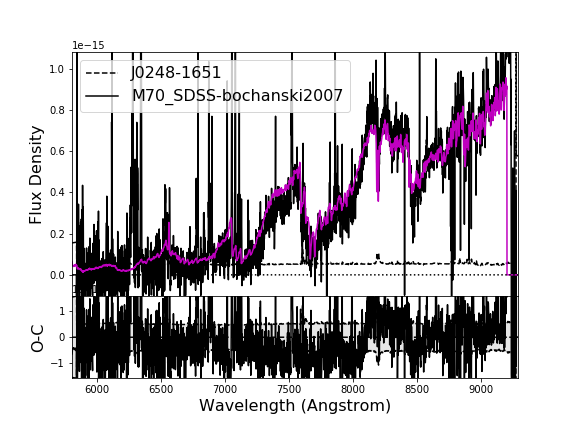

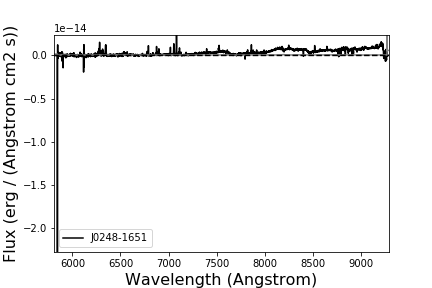

kastRED_J0248-1651_20200204.fits
lto, S/N


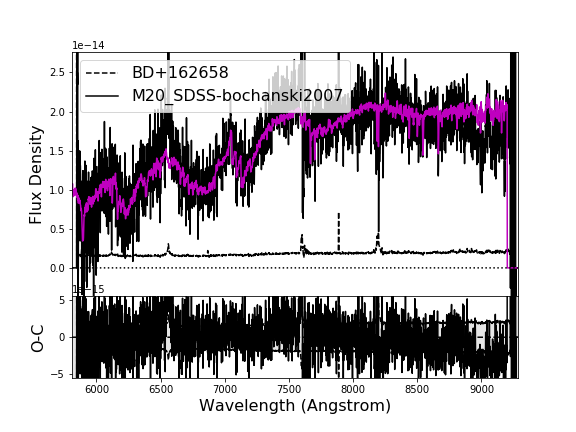

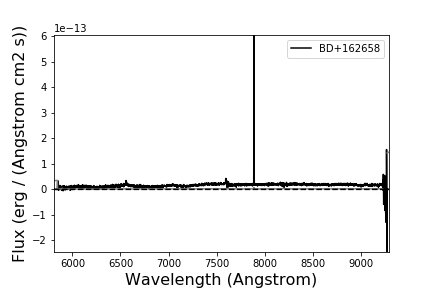

kastRED_BD162658_20180307.fits
lto, S/N, scq, ?


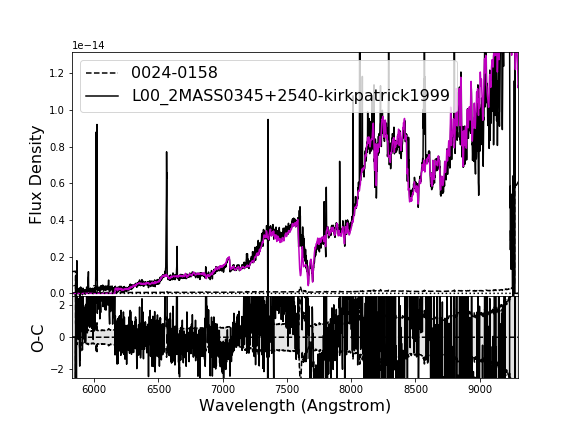

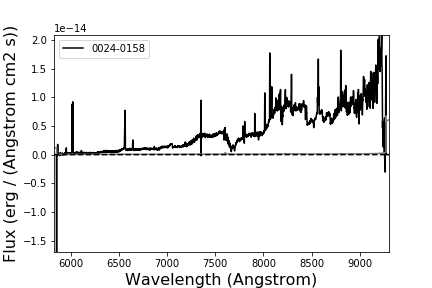

kastRED_J0024-0158_20170817.fits
lto, mcq


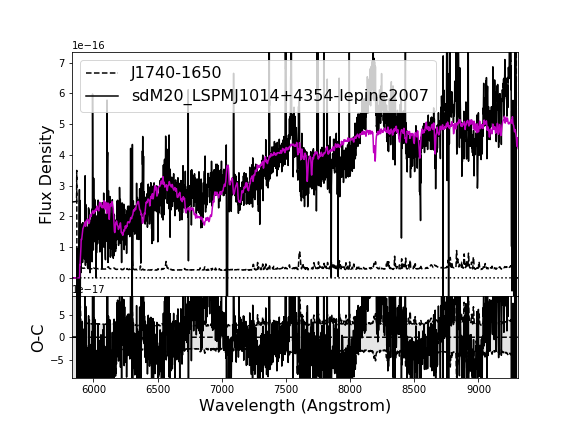

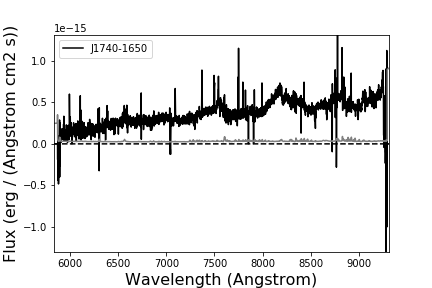

kastRED_J1740-1650B_20190920.fits
lto, S/N, scq, ?


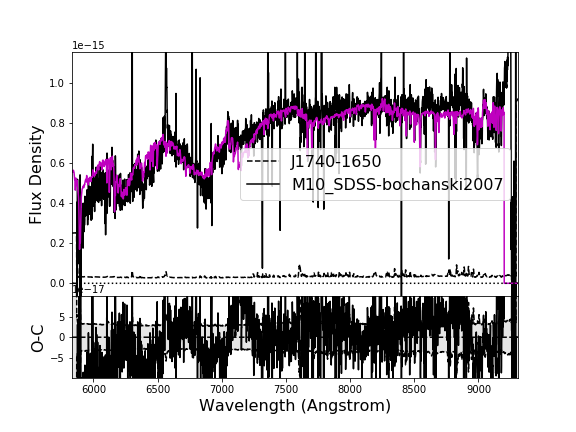

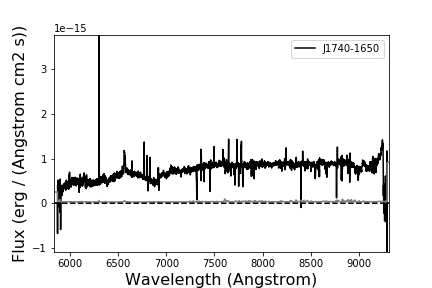

kastRED_J1740-1650_20190920.fits
None


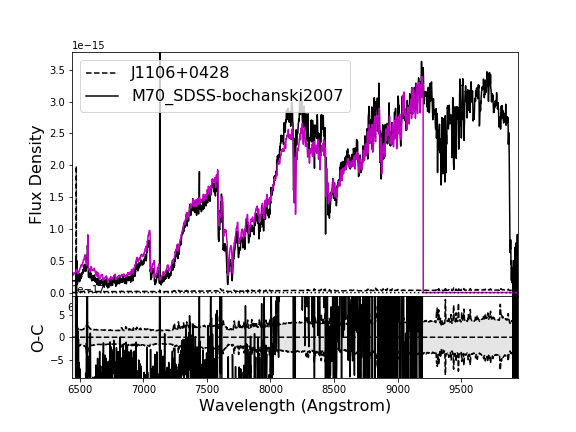

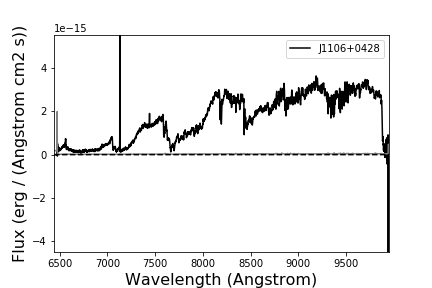

kastRED_J1106+0428_20200203.fits
lto, scq, spt_fixed


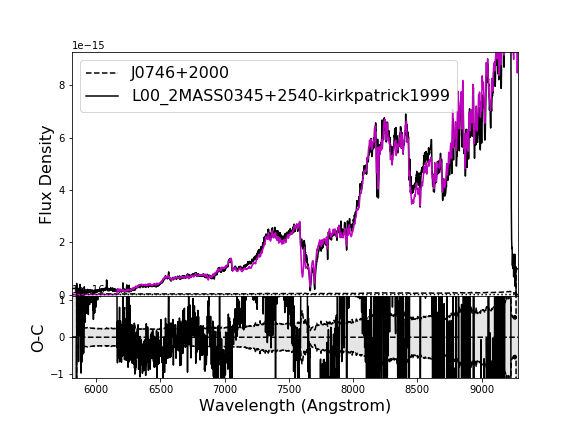

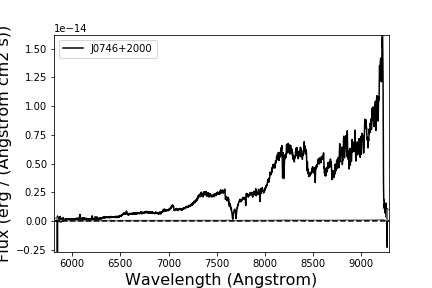

kastRED_J0746+2000_20200311.fits
lto, mcq


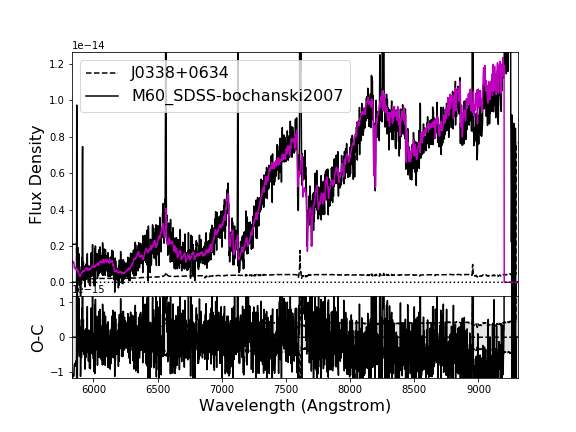

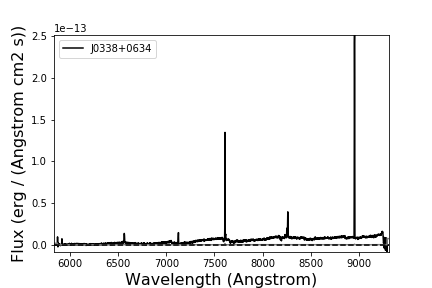

kastRED_J0338+0634_20190920.fits
lto, S/N, scq, spt_fixed


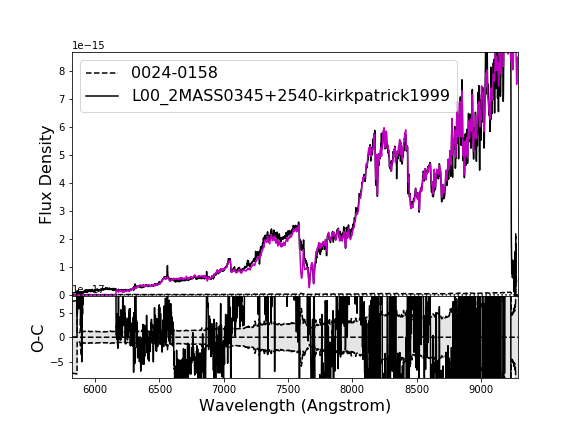

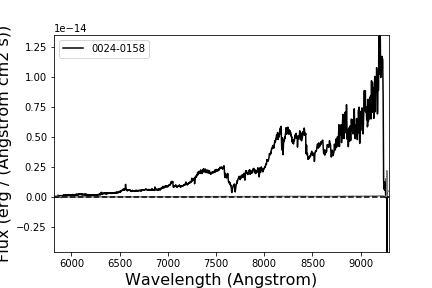

kastRED_J0024-0158_20170823.fits
lto, mcq


In [53]:
display_images(df[df['zeta'] < 0.825], QA_path='/home/ryan/projects/TestingPNGs/20200716/')

In [15]:
med_lepine_spt_err

0.04108518889

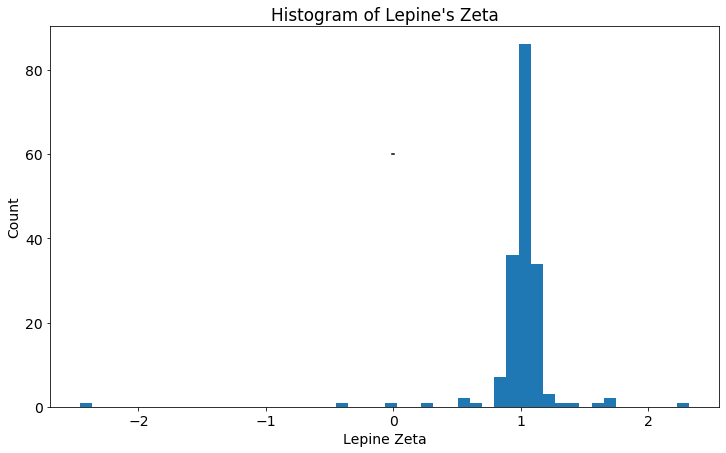

In [16]:
zeta = df['zeta'].values

zeta_err = df['zeta_err'].values

med_zeta_err = np.median(zeta_err)

plt.figure(figsize=[12,7])
hist = plt.hist(zeta, bins=50)
plt.title("Histogram of Lepine's Zeta")
plt.xlabel('Lepine Zeta')
plt.ylabel('Count')


plt.plot([-med_zeta_err, med_zeta_err], [60, 60], color='k')

#plt.savefig('zeta_hist.png')

plt.show()

In [17]:
Halpha = df['Halpha_EW_(Angstrom)'].values
Halpha_err = df['Halpha_EW_err_(Angstrom)'].values
med_Halpha_err = np.median(Halpha_err)

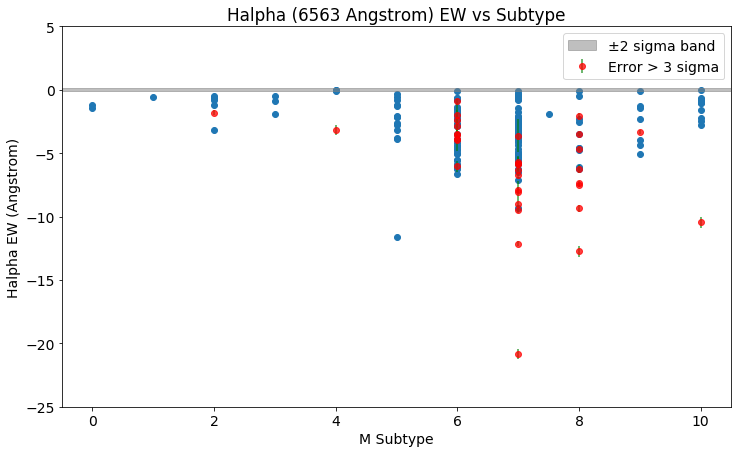

In [18]:
plt.figure(figsize=[12, 7])
plt.title('Halpha (6563 Angstrom) EW vs Subtype')
plt.scatter(spt[Halpha_err < 3 * med_Halpha_err], Halpha[Halpha_err < 3 * med_Halpha_err])
plt.errorbar(spt[(Halpha_err > 3 * med_Halpha_err)],\
             Halpha[(Halpha_err > 3 * med_Halpha_err)],\
             yerr=Halpha_err[(Halpha_err > 3 * med_Halpha_err)],\
             fmt='ro', ecolor='g', alpha=0.75, label='Error > 3 sigma')
plt.ylim(-25, 5)

plt.axhspan(-2 * med_Halpha_err, 2 * med_Halpha_err, color='gray', alpha=0.5, label='±2 sigma band')
plt.legend()

plt.ylabel('Halpha EW (Angstrom)')
plt.xlabel('M Subtype')



plt.savefig('Halpha_spt.png')
plt.show()

In [19]:
LiI = df['LiI_EW_(Angstrom)'].values
LiI_err = df['LiI_EW_err_(Angstrom)'].values
med_LiI_err = np.median(LiI_err)

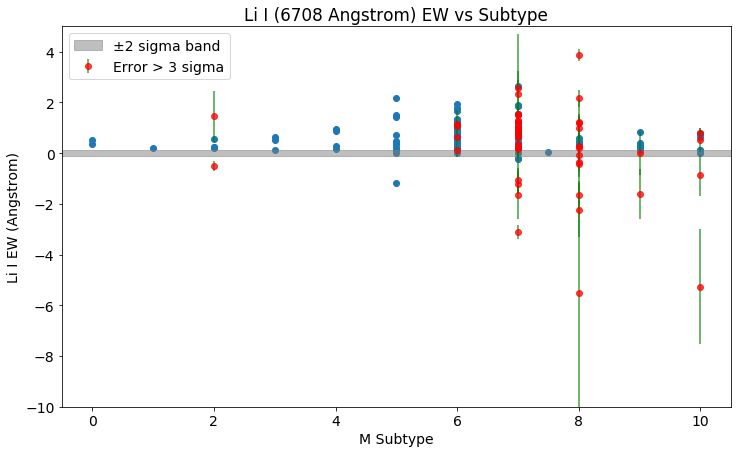

In [20]:
plt.figure(figsize=[12, 7])
plt.title('Li I (6708 Angstrom) EW vs Subtype')

plt.scatter(spt[LiI_err < 3 * med_LiI_err], LiI[LiI_err < 3 * med_LiI_err])
plt.errorbar(spt[LiI_err > 3 * med_LiI_err], LiI[LiI_err > 3 * med_LiI_err],\
             yerr=LiI_err[LiI_err > 3 * med_LiI_err],
             fmt='ro', ecolor='g', alpha=0.75, label='Error > 3 sigma')
plt.ylim(-10, 5)

plt.axhspan(-2 * med_LiI_err, 2 * med_LiI_err, color='gray', alpha=0.5, label='±2 sigma band')
plt.legend()

plt.ylabel('Li I EW (Angstrom)')
plt.xlabel('M Subtype')

plt.savefig('LiI_spt.png')
plt.show()

In [21]:
hastrings = df['RbIb_EW_(Angstrom)'].values
hastrings1 = df['RbIb_EW_err_(Angstrom)']

RbI = []
RbI_err = []
for string1, string2 in zip(hastrings, hastrings1):
    
    try:
        num = float(string1)
        err = float(string2)
    except:
        num = np.nan
        err = np.nan
    
    RbI.append(num)
    RbI_err.append(err)
    
RbI = np.array(RbI)

RbI_err = np.array(RbI_err)

med_RbI_err = np.nanmedian(RbI_err)

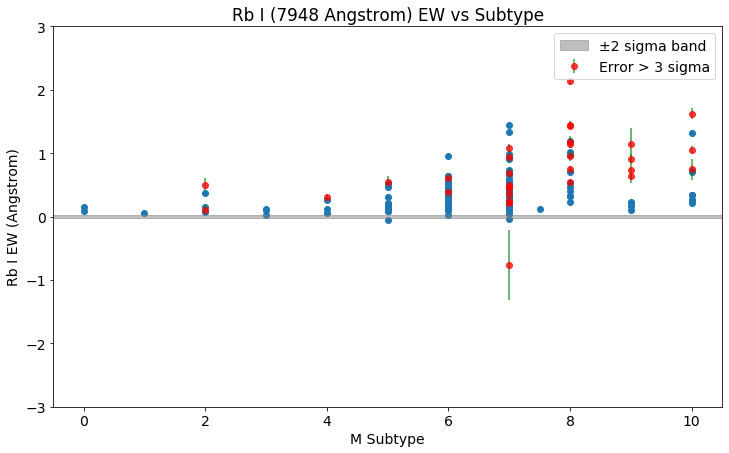

In [22]:
plt.figure(figsize=[12, 7])
plt.title('Rb I (7948 Angstrom) EW vs Subtype')

plt.scatter(spt[RbI_err < 3 * med_RbI_err], RbI[RbI_err < 3 * med_RbI_err])
plt.errorbar(spt[RbI_err > 3 * med_RbI_err], RbI[RbI_err > 3 * med_RbI_err],\
             yerr=RbI_err[RbI_err > 3 * med_RbI_err],
             fmt='ro', ecolor='g', alpha=0.75, label='Error > 3 sigma')


plt.axhspan(-2 * med_RbI_err, 2 * med_RbI_err, color='gray', alpha=0.5, label='±2 sigma band')
plt.legend()
plt.ylim(-3, 3)
plt.ylabel('Rb I EW (Angstrom)')
plt.xlabel('M Subtype')

plt.savefig('RbI_spt.png')
plt.show()

In [23]:
CsI = df['CsIa_EW_(Angstrom)'].values
CsI_err = df['CsIa_EW_err_(Angstrom)'].values
med_CsI_err = np.median(CsI_err)

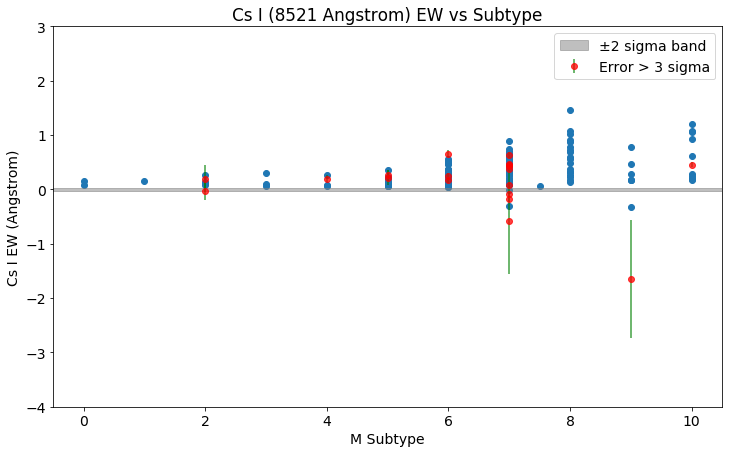

In [24]:
plt.figure(figsize=[12, 7])
plt.title('Cs I (8521 Angstrom) EW vs Subtype')

plt.scatter(spt[CsI_err < 3 * med_CsI_err], CsI[CsI_err < 3 * med_CsI_err])
plt.errorbar(spt[CsI_err > 3 * med_CsI_err], CsI[CsI_err > 3 * med_CsI_err],\
             yerr=CsI_err[CsI_err > 3 * med_CsI_err],
             fmt='ro', ecolor='g', alpha=0.75, label='Error > 3 sigma')


plt.axhspan(-2 * med_CsI_err, 2 * med_CsI_err, color='gray', alpha=0.5, label='±2 sigma band')
plt.legend()
plt.ylabel('Cs I EW (Angstrom)')
plt.xlabel('M Subtype')

plt.ylim(-4,3)

plt.savefig('CsI_spt.png')
plt.show()

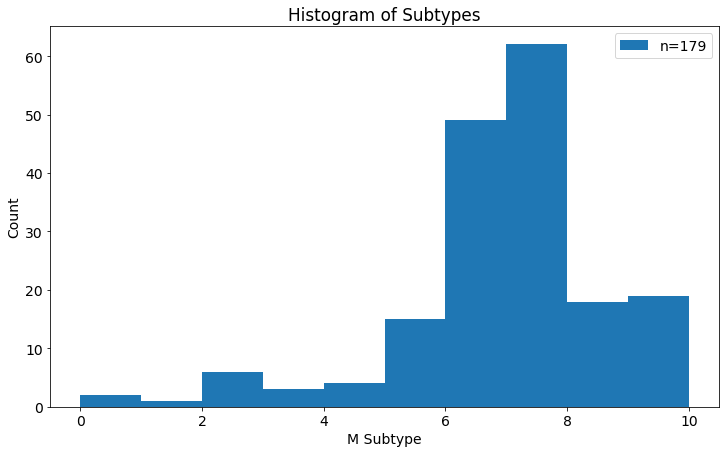

In [25]:
M_subtypes = df['subtype'].values

plt.figure(figsize=[12,7])
plt.hist(M_subtypes, bins=10, label='n={}'.format(len(df)))
plt.xlabel('M Subtype')
plt.ylabel('Count')
plt.title('Histogram of Subtypes')
plt.legend()
#plt.savefig('Histogram of Subtypes.png')
plt.show()

In [26]:
len(df)

179

In [63]:
df[df['Halpha_EW_(Angstrom)'] < -10]['Halpha_EW_(Angstrom)']

24    -11.615601
73    -20.828627
75    -12.144131
78    -12.725684
80    -10.461143
136   -33.241196
Name: Halpha_EW_(Angstrom), dtype: float64

About to show 4 * 6 images, proceed? (y/n)
y


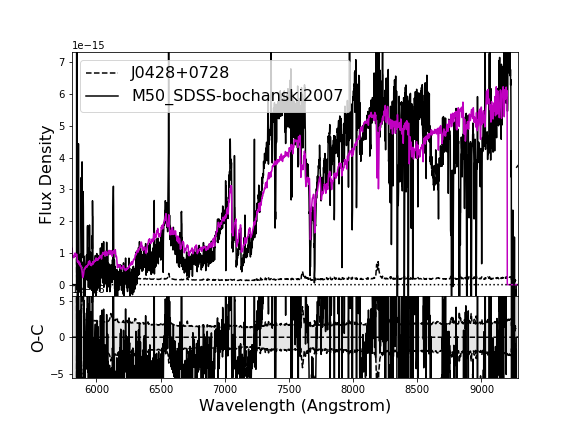

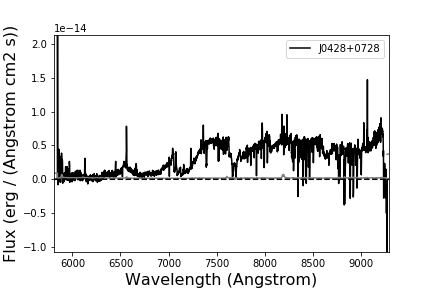

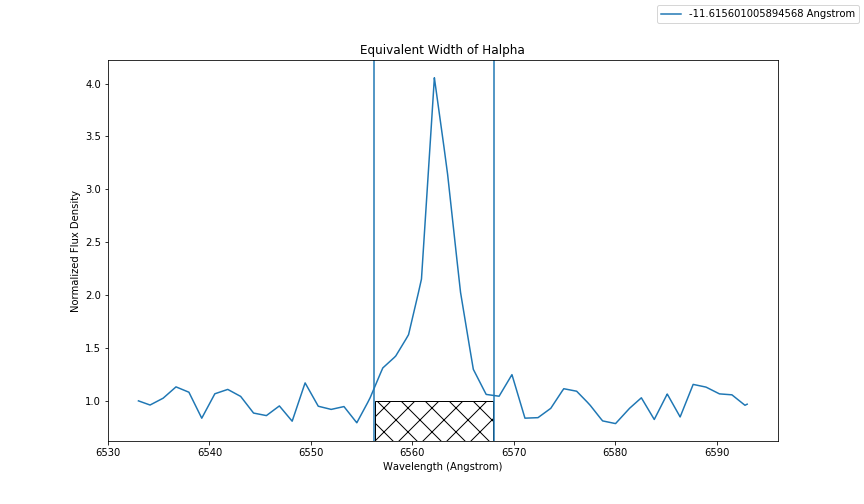

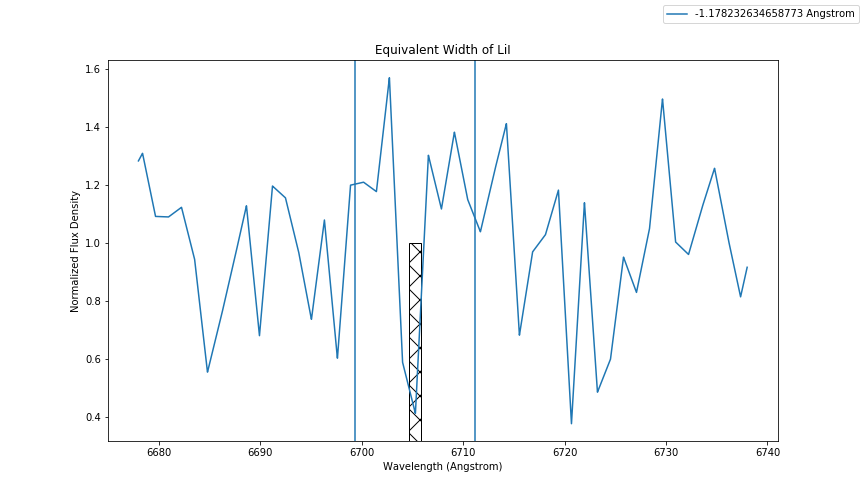

kastRED_J0428+0728_20180307.fits
lto, S/N, scq


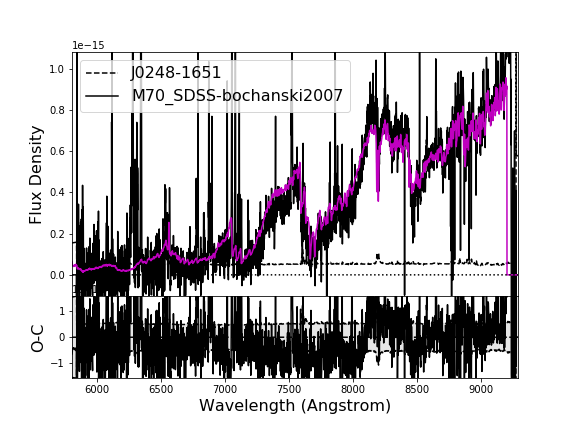

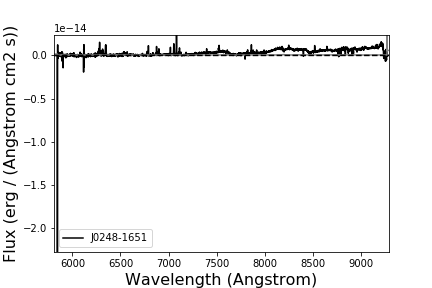

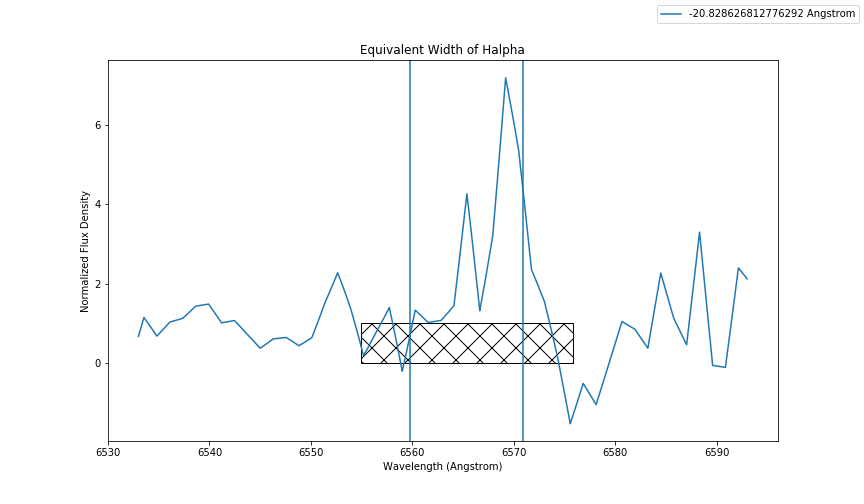

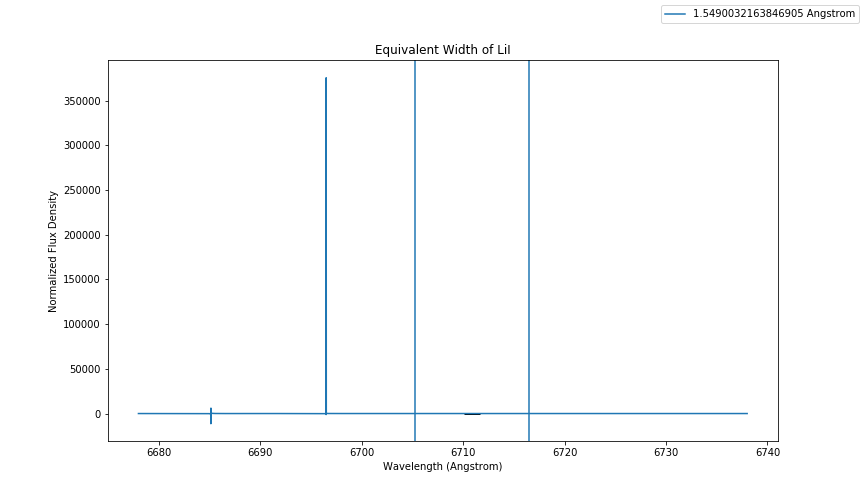

kastRED_J0248-1651_20200204.fits
lto, S/N


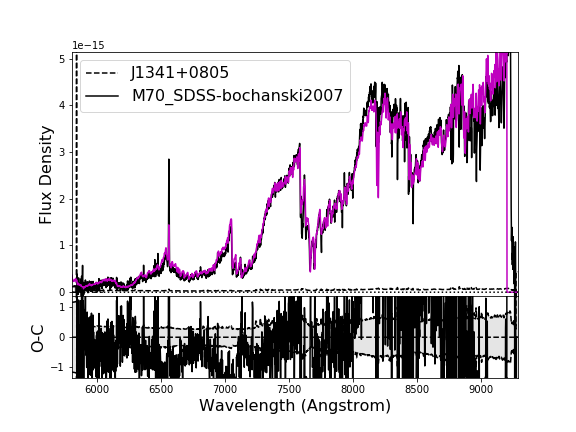

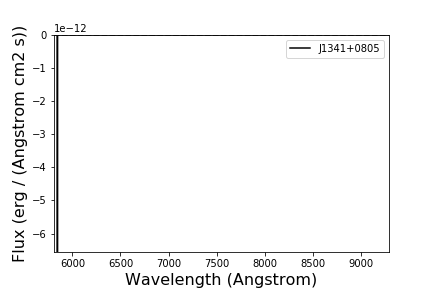

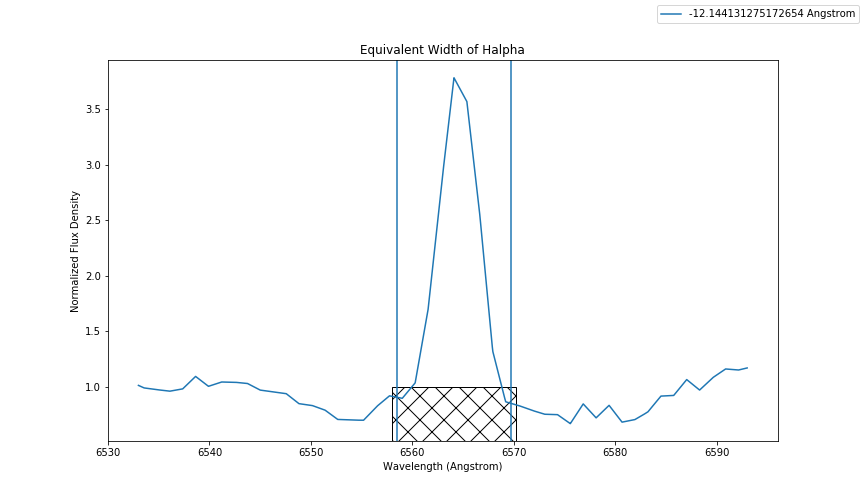

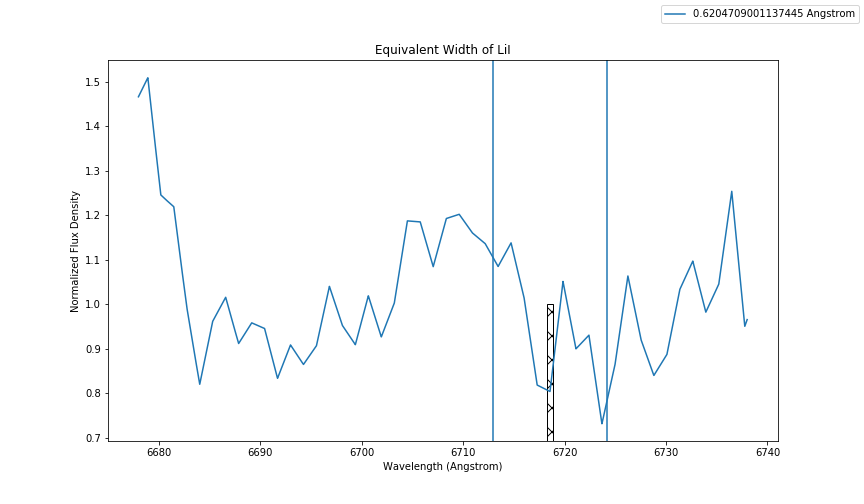

kastRED_J1341+0805_20200204.fits
None


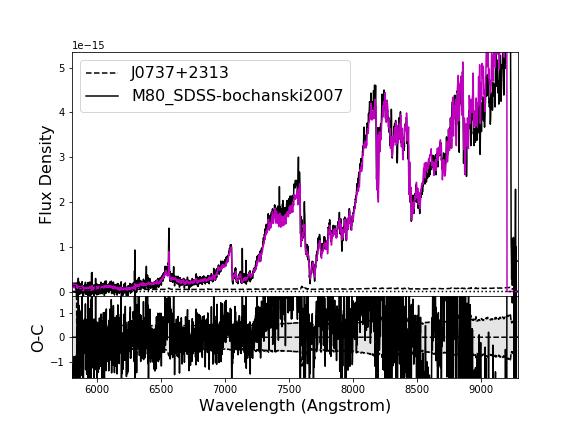

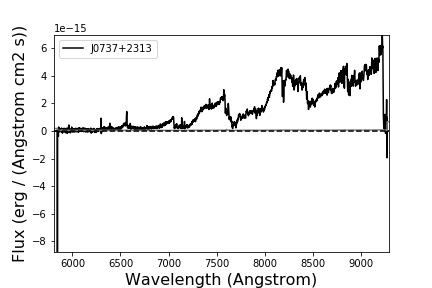

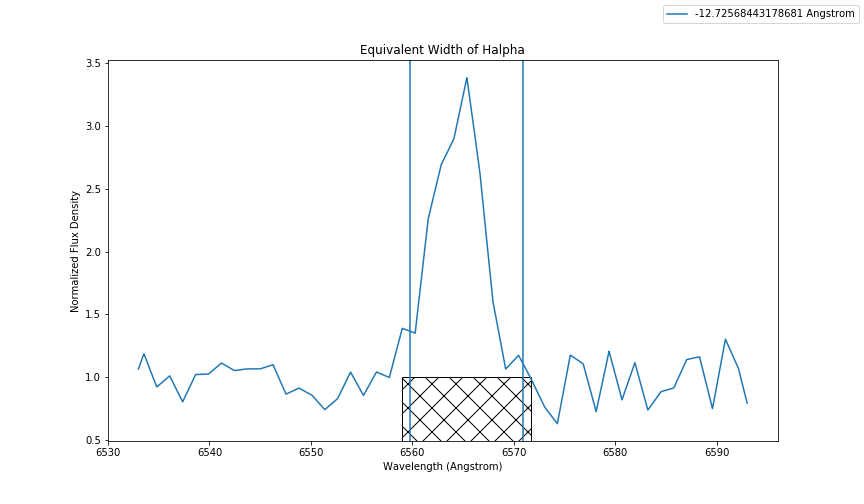

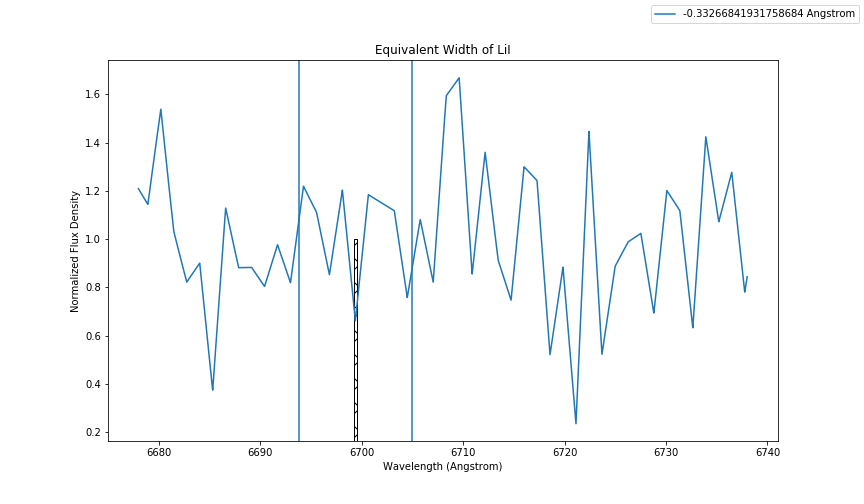

kastRED_J0737+2313_20200204.fits
lto


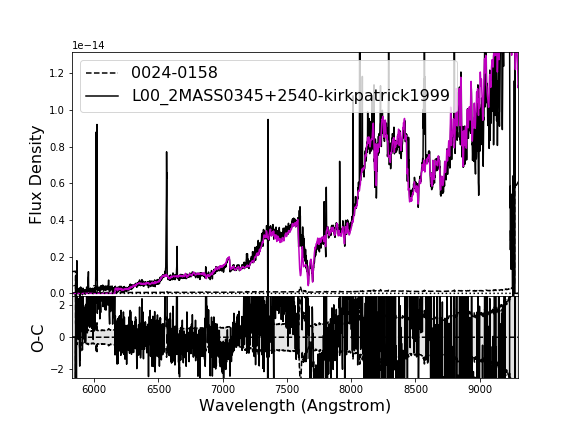

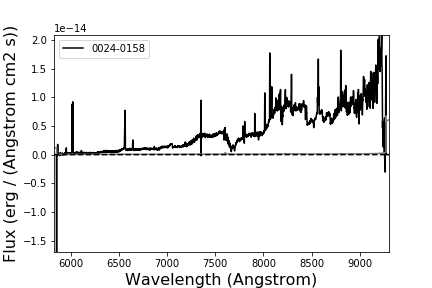

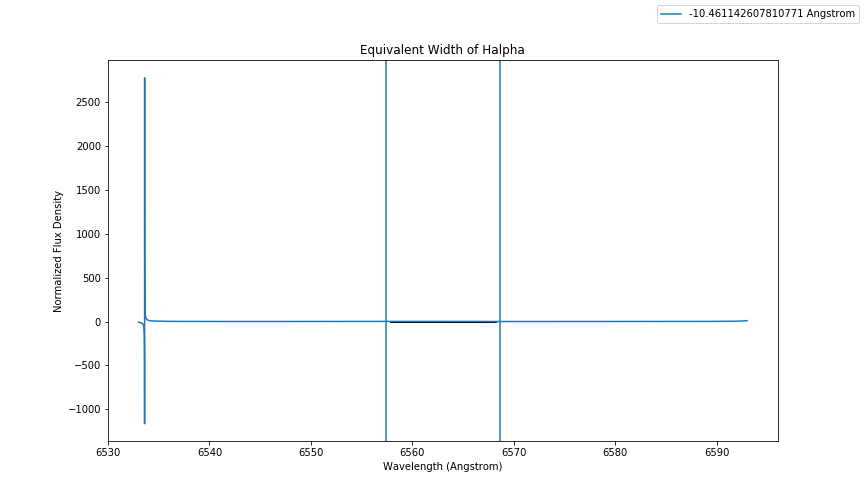

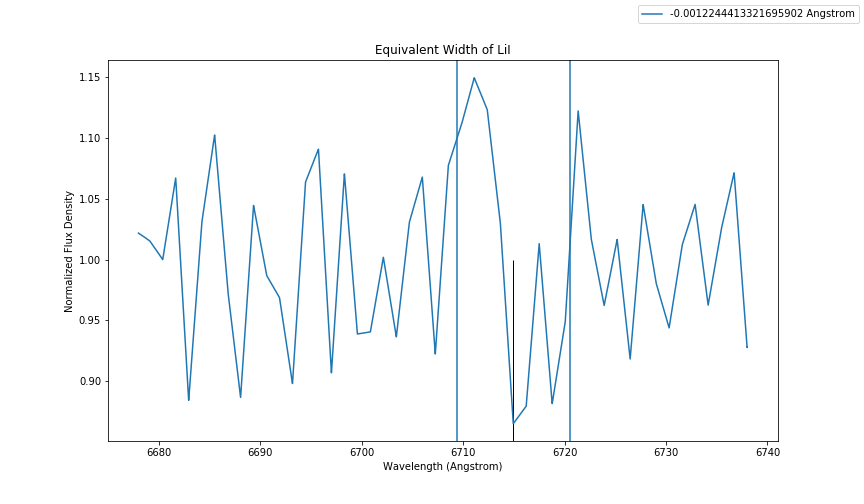

kastRED_J0024-0158_20170817.fits
lto, mcq


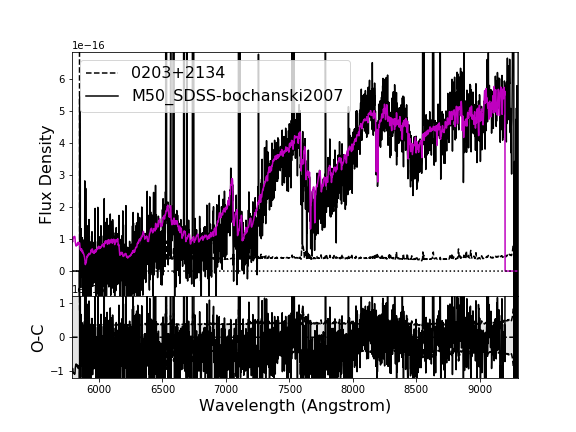

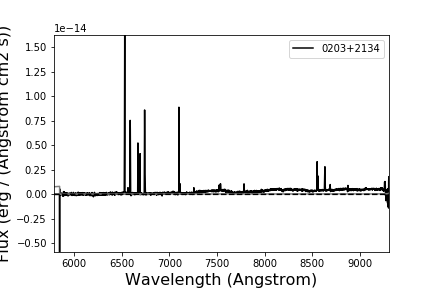

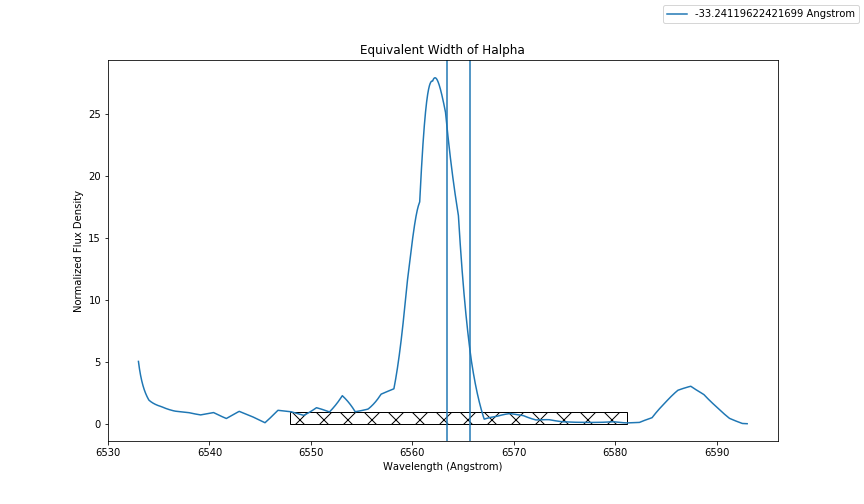

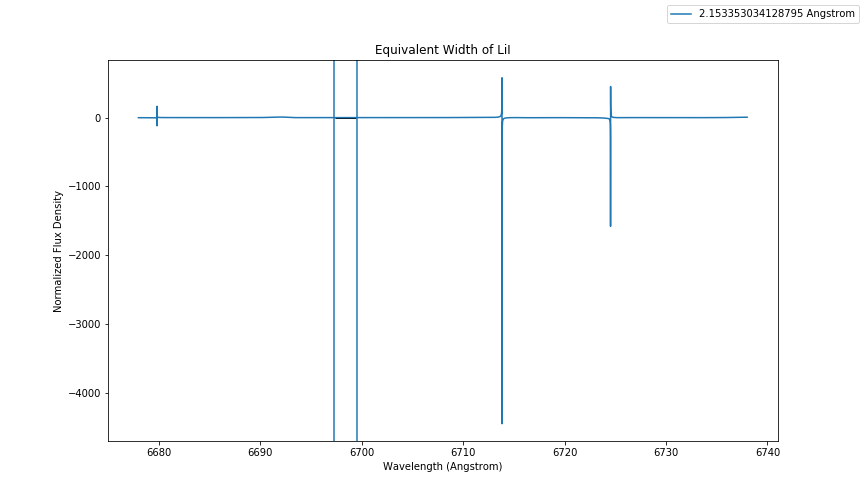

kastRED_J0203+2134_20170813.fits
lto, S/N


In [70]:
display_images(df[df['Halpha_EW_(Angstrom)'] < -10], QA_path)

In [66]:
df[df['LiI_EW_(Angstrom)'] > 1.5]

,name,filename,tags,RA,DEC,OBSDATE,spt,subtype,spt_chi2,spt_scale,...,gizis_CaH2_spt_err,gizis_CaH3_spt,gizis_CaH3_spt_err,lepine_spt,lepine_spt_err,zeta,zeta_err,metallicity_class,L_Halpha/L_bol,L_Halpha/L_bol_err
1,J1300+3038,kastRED_J1300+3038_20200305.fits,None,13:00:07,30:38:58,2020-03-06T11:10:41.12,M6.0,6.0,8.623883e+04,7.331186e-15,...,0.062521,6.924109,0.114539,5.801550,0.058665,0.971940,0.008203,Dwarf,-6.89E-05,8.84E-08
11,J0347+0417,kastRED_J0347+0417_20180308.fits,lto,3:47:08,4:17:54,2018-03-08T04:19:04.49,M8.0,8.0,2.468709e+05,2.187471e-15,...,0.130027,4.979760,0.226844,4.740137,0.111760,1.058639,0.019546,Dwarf,-4.60E-05,3.30E-07
29,J2350+0806,kastRED_J2350+0806_20180717.fits,None,23:50:40,8:06:25,2018-07-18T12:01:53.49,M7.0,7.0,1.197045e+06,8.715391e-15,...,0.031095,4.633215,0.060689,2.971138,0.029456,1.461462,0.008909,Dwarf,-4.45E-05,2.63E-07
44,J1545+4350,kastRED_J1545+1102_20180717.fits,None,15:45:30,43:50:51,2018-07-18T07:58:25.97,M6.0,6.0,1.179647e+06,1.264361e-14,...,0.015807,5.325977,0.033379,4.762321,0.015706,1.034449,0.002684,Dwarf,-2.70E-05,2.33E-07
45,J1221+0857,kastRED_J1221+0857_20200304.fits,None,12:21:03,8:57:21,2020-03-05T10:07:42.71,M7.0,7.0,1.974025e+05,7.872920e-15,...,0.033231,4.983667,0.058991,4.695298,0.037642,1.053356,0.005882,Dwarf,-4.25E-05,4.99E-07
58,J1445+6447,kastRED_J1445+6447_20200311.fits,"lto, S/N, scq",14:45:52,64:47:56,2020-03-12T10:53:29.71,M7.0,7.0,1.100579e+05,2.947346e-15,...,0.063192,7.485072,0.108163,6.333746,0.054564,0.959312,0.008201,Dwarf,-3.66E-05,8.42E-08
61,J2325+4608,kastRED_J2325+4608_20190920.fits,None,23:25:35,46:08:09,2019-09-20T08:42:24.47,M6.0,6.0,1.704543e+05,6.241911e-15,...,0.042676,5.453935,0.077685,4.735893,0.035709,1.017854,0.006424,Dwarf,-0.0001074259726,4.14E-07
73,J0248-1651,kastRED_J0248-1651_20200204.fits,"lto, S/N",2:48:41,-16:51:24,2020-02-05T03:10:04.51,M7.0,7.0,2.520285e+04,7.521989e-16,...,1.874103,1.359004,4.218468,0.194886,2.015572,-2.456557,35.631028,usd,-0.0002511307535,1.35E-06
83,J2235+1840,kastRED_J2235+1840_20180716.fits,None,22:35:49,18:40:30,2018-07-17T10:37:39.72,M7.0,7.0,6.280922e+05,6.141375e-15,...,0.023046,4.986217,0.053561,4.641214,0.020494,0.912701,0.003732,Dwarf,-6.00E-05,3.40E-07
104,J1412-0035B,kastRED_J1412-0035B_20190331.fits,"lto, S/N",14:12:11,-0:35:13,2019-04-01T11:25:23.96,M8.0,8.0,9.335219e+04,8.044277e-15,...,0.177118,6.776489,0.276772,2.647041,0.199177,1.558941,0.072656,Dwarf,-2.47E-05,7.60E-07


About to show 4 * 17 images, proceed? (y/n)
y


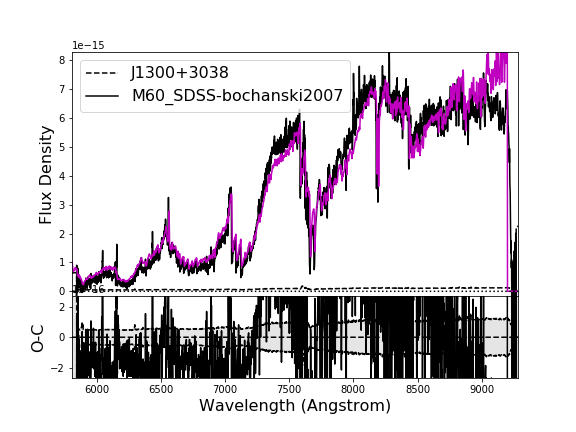

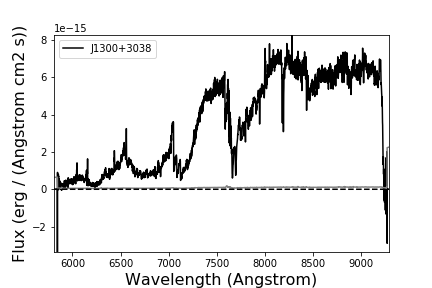

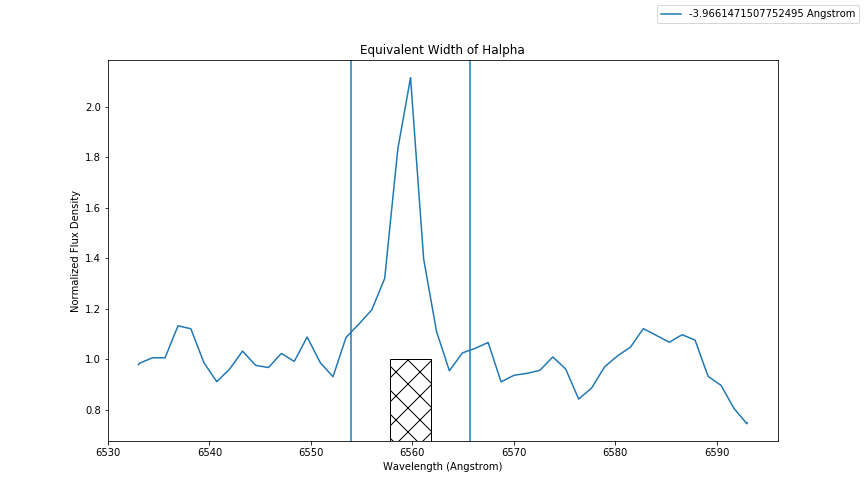

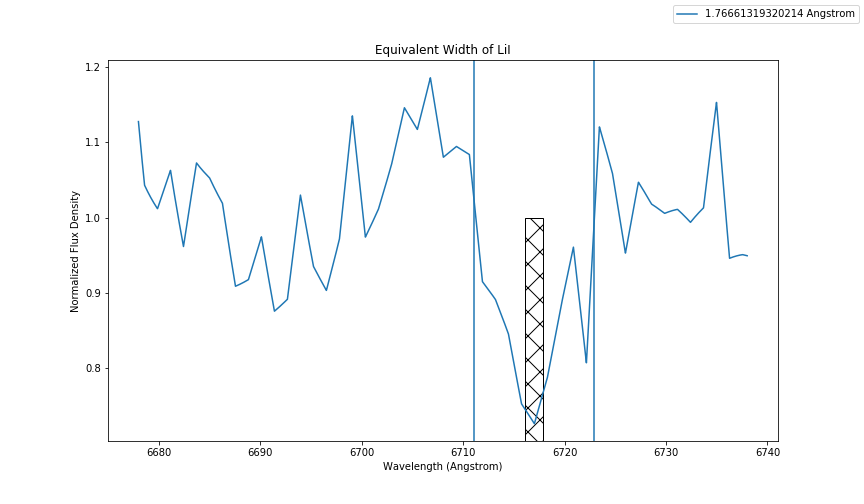

kastRED_J1300+3038_20200305.fits
None


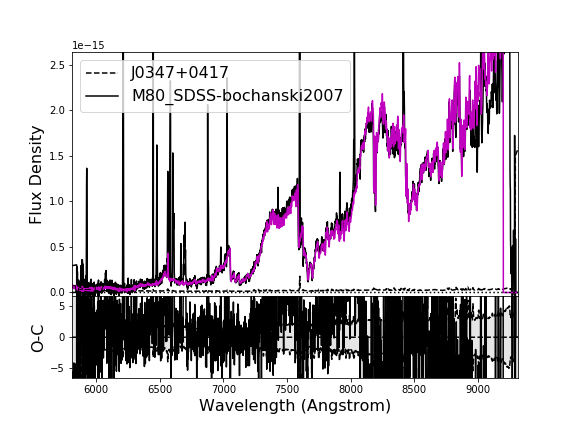

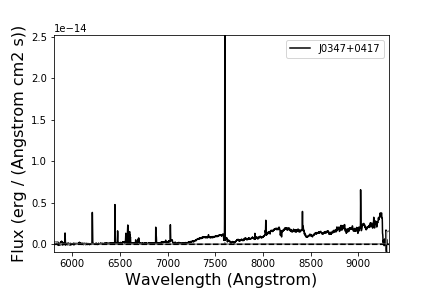

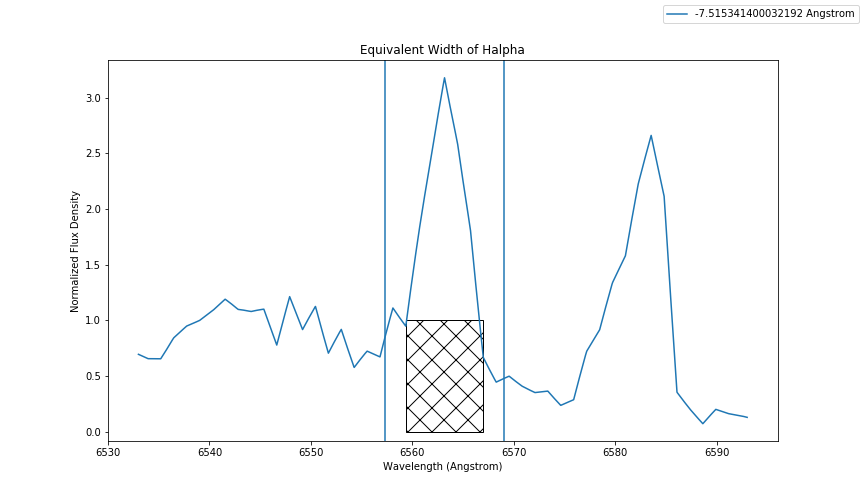

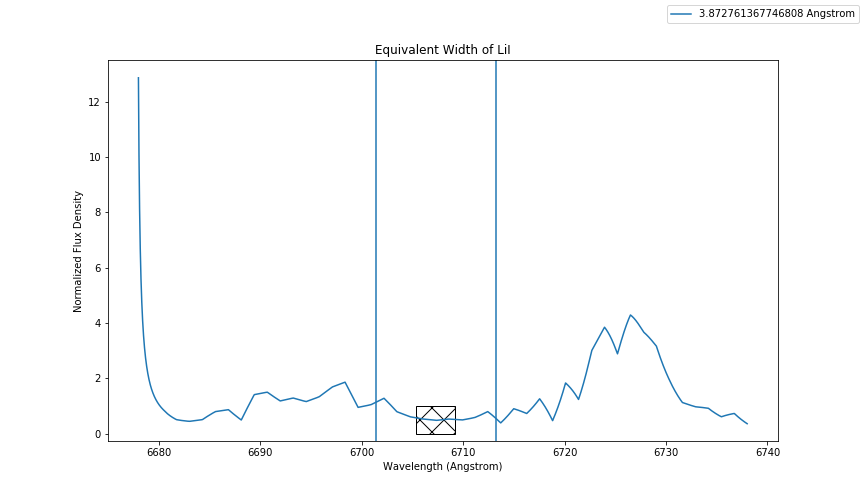

kastRED_J0347+0417_20180308.fits
lto


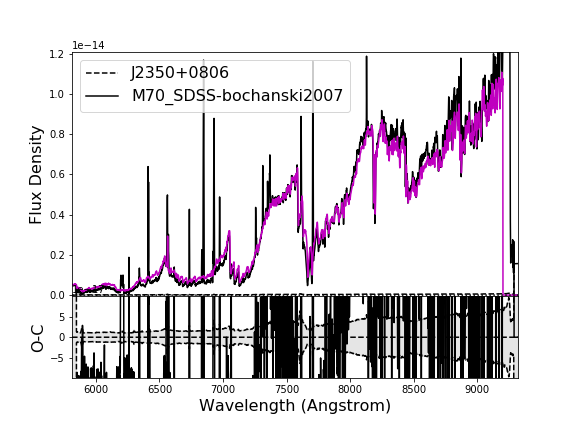

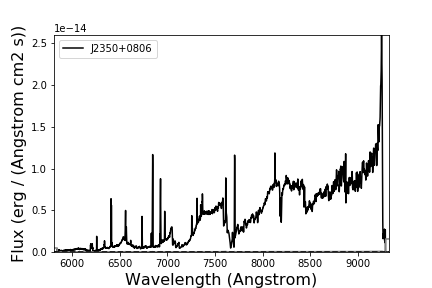

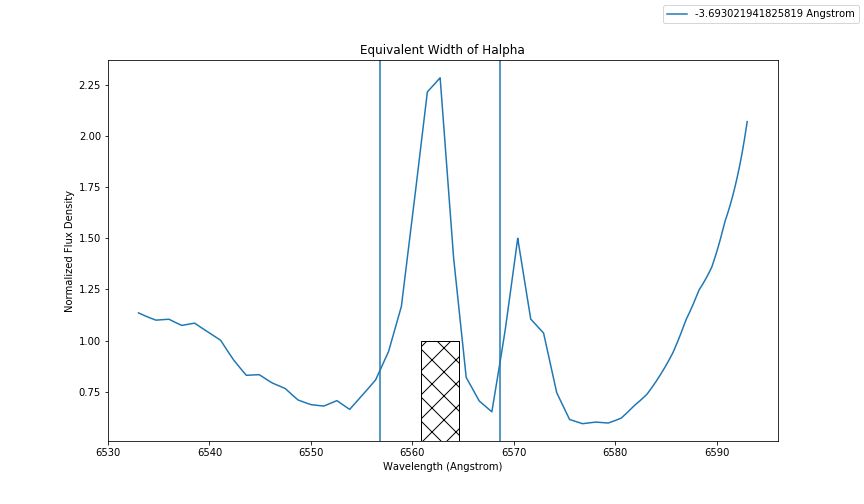

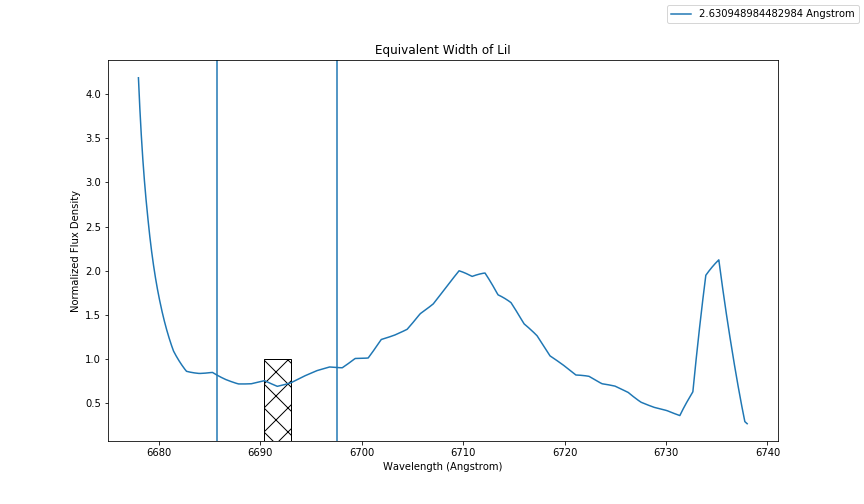

kastRED_J2350+0806_20180717.fits
None


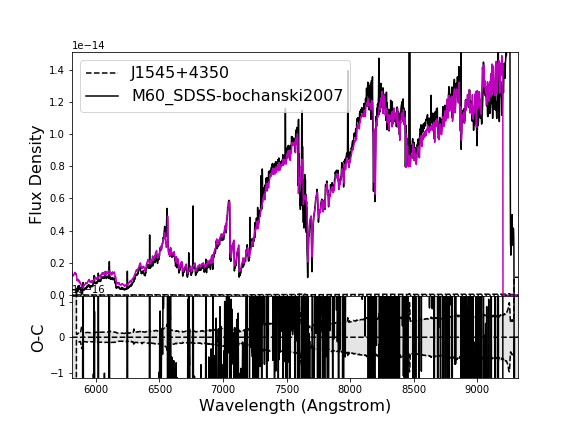

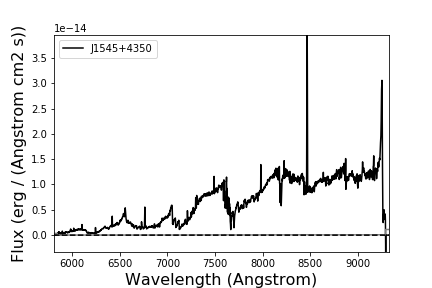

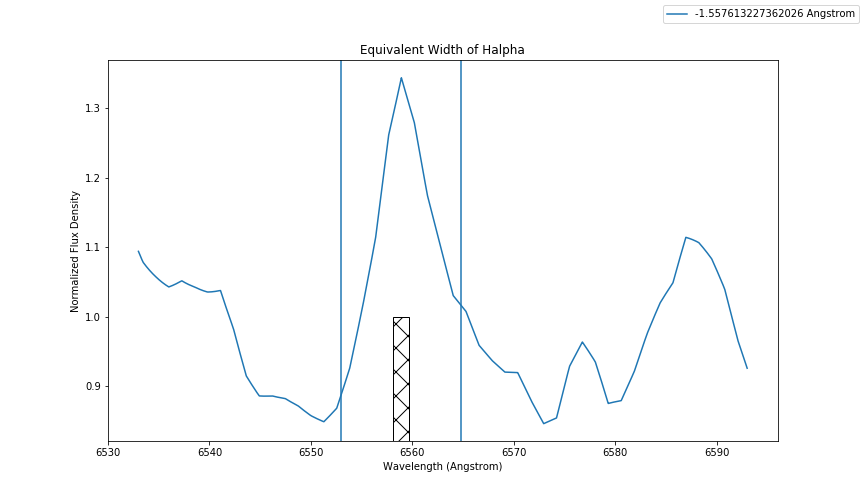

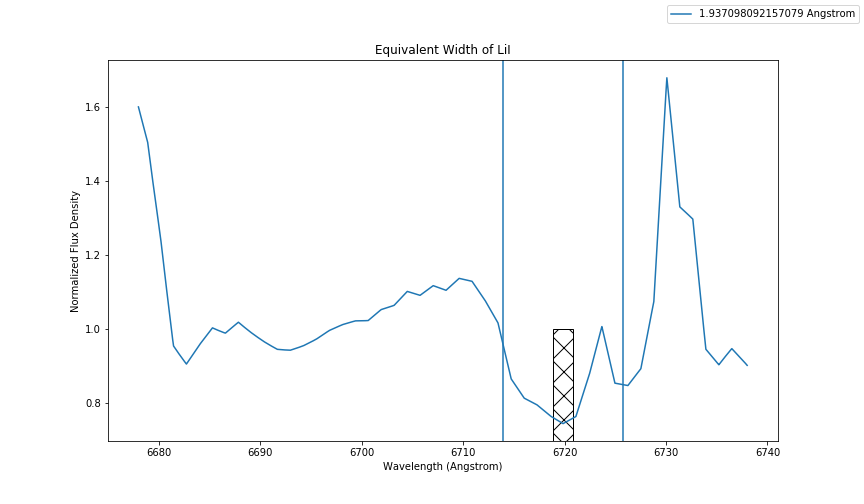

kastRED_J1545+1102_20180717.fits
None


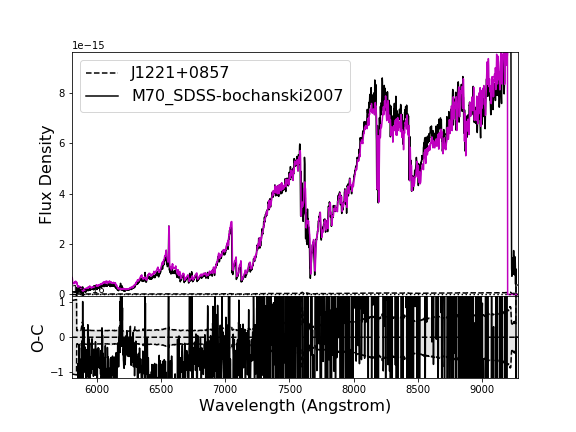

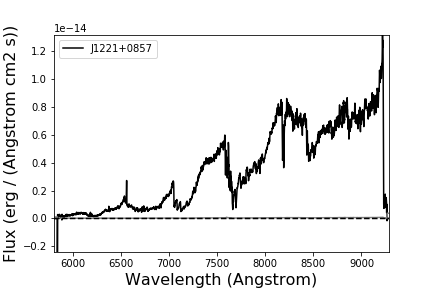

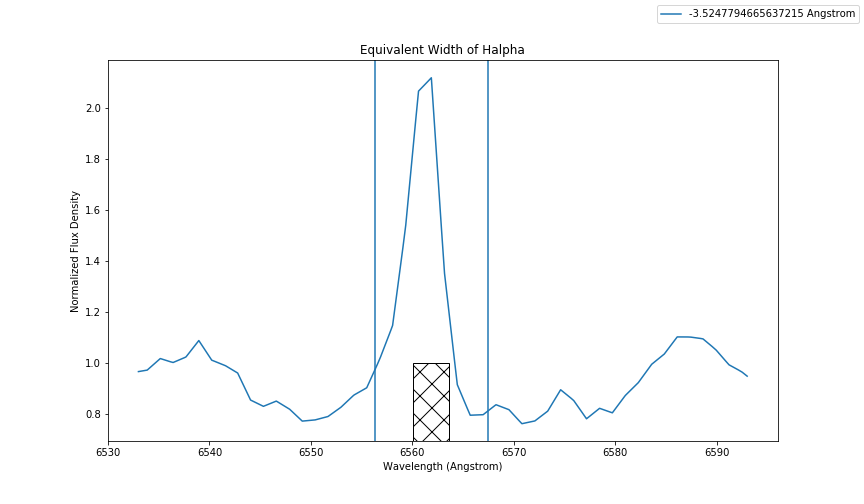

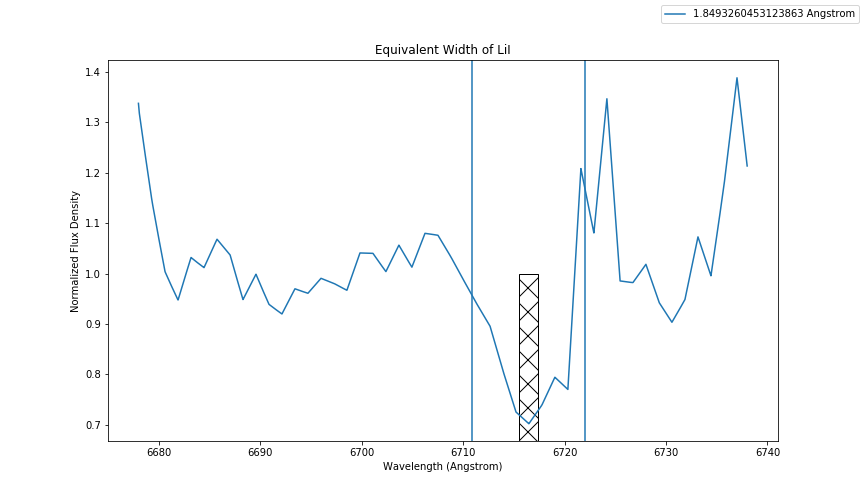

kastRED_J1221+0857_20200304.fits
None


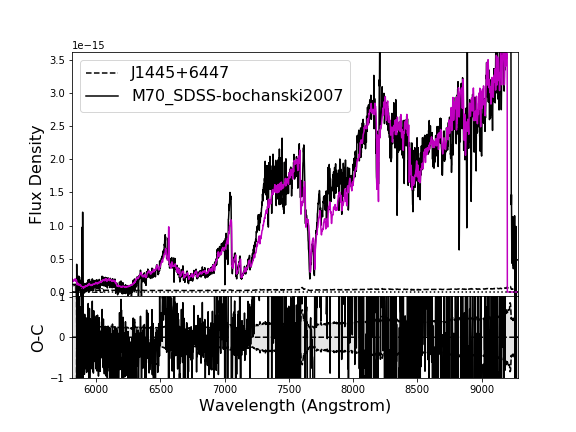

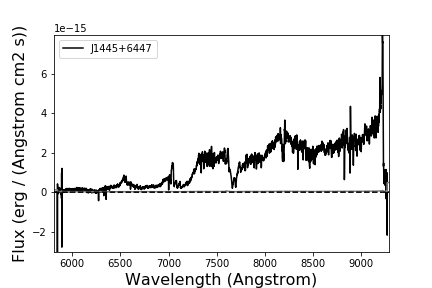

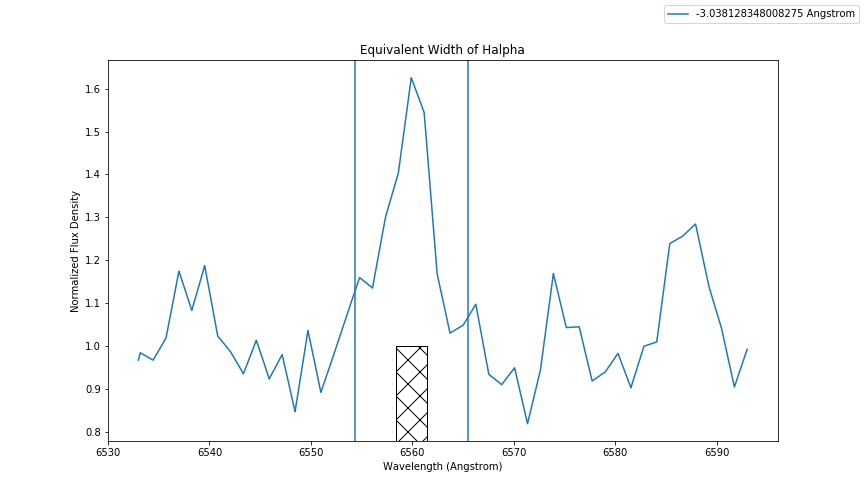

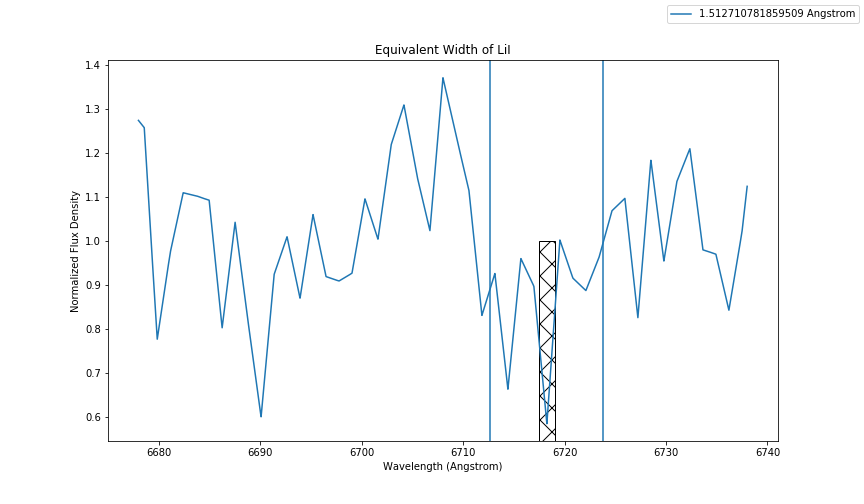

kastRED_J1445+6447_20200311.fits
lto, S/N, scq


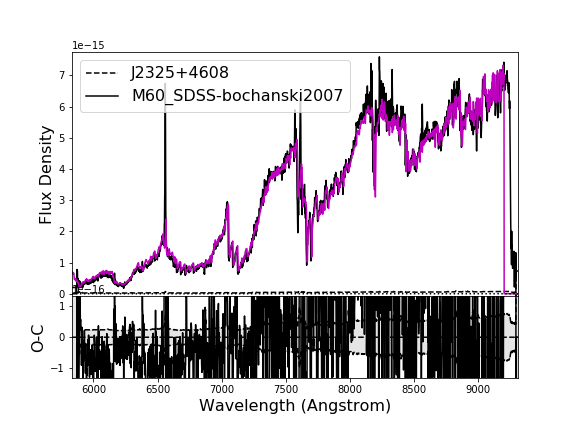

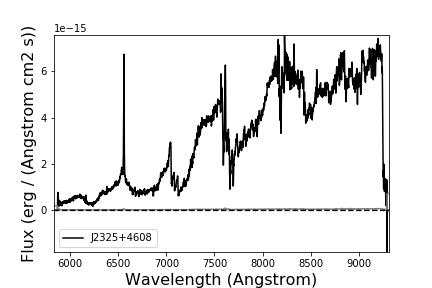

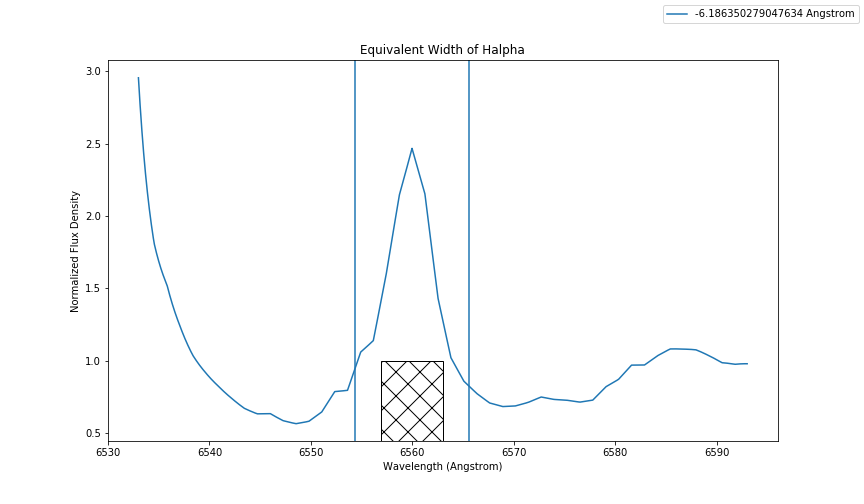

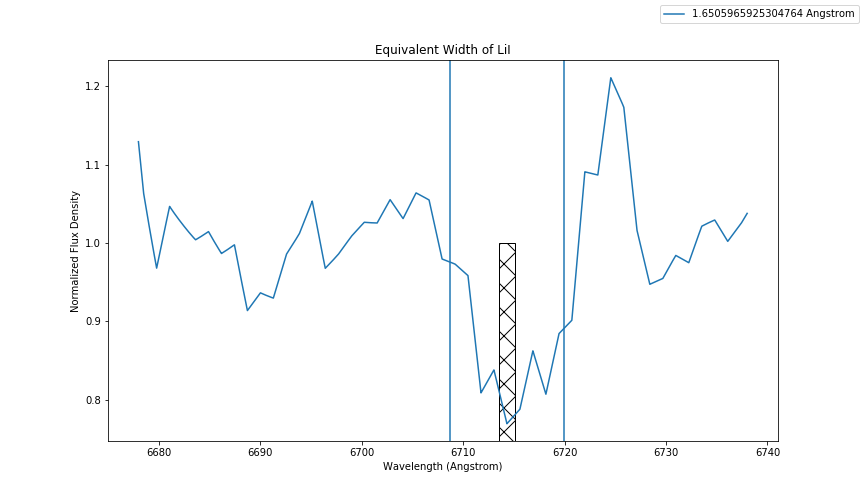

kastRED_J2325+4608_20190920.fits
None


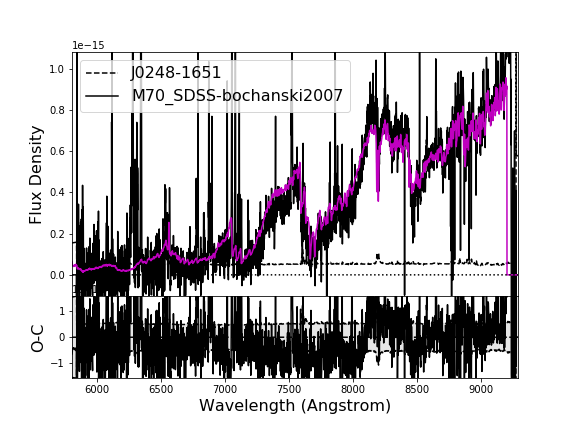

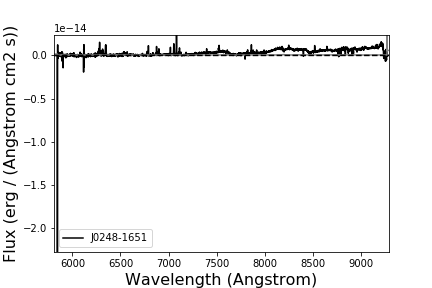

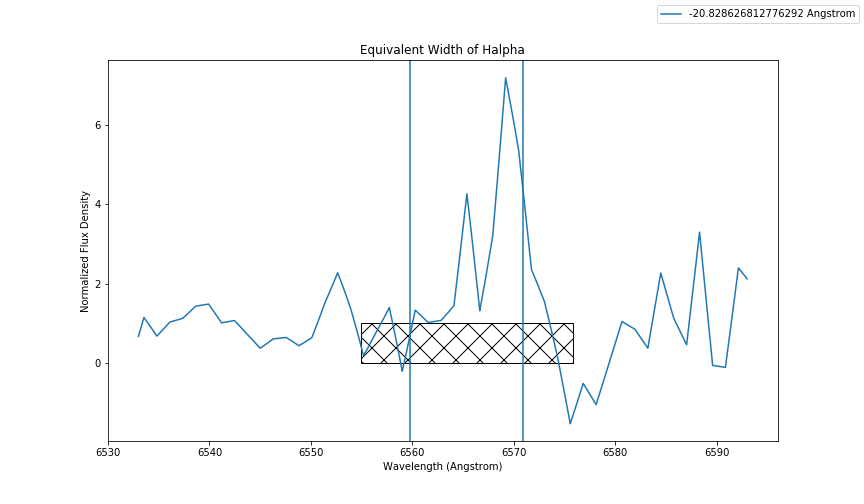

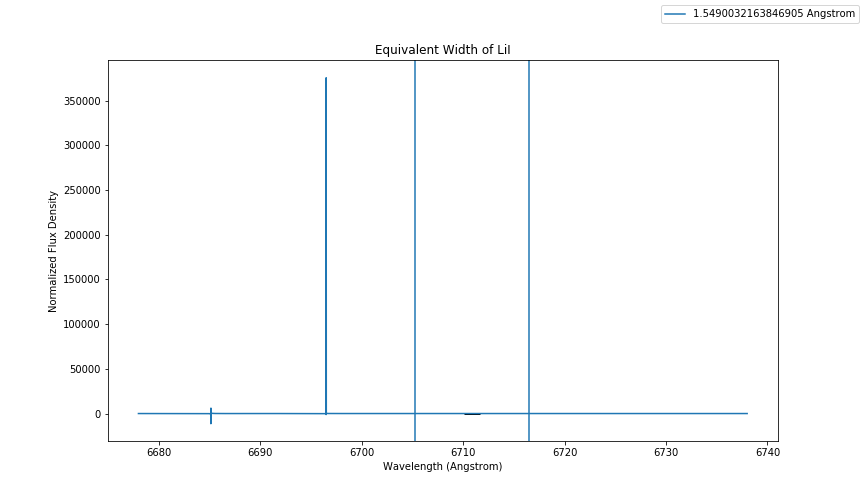

kastRED_J0248-1651_20200204.fits
lto, S/N


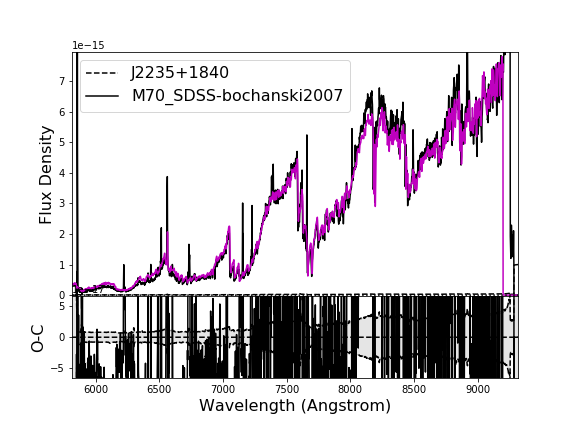

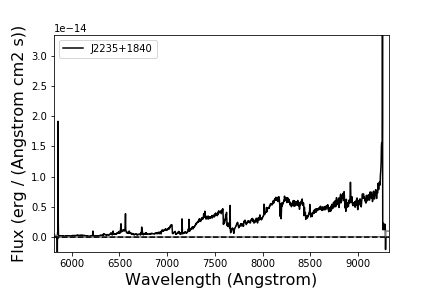

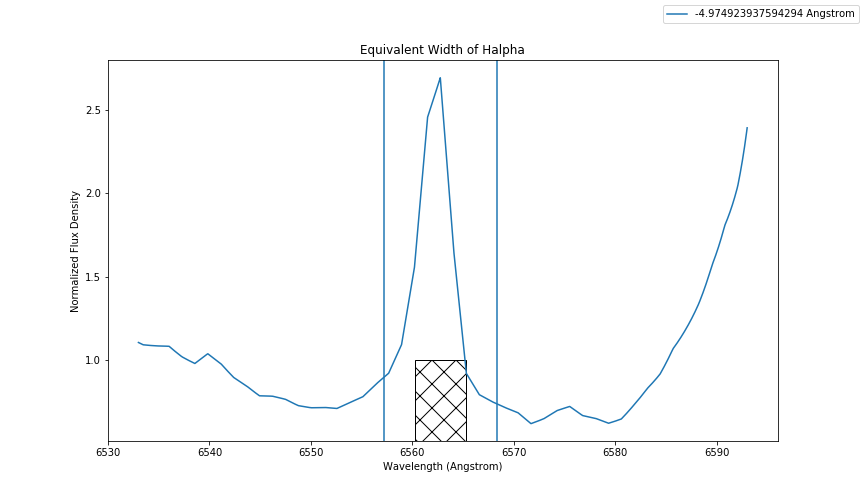

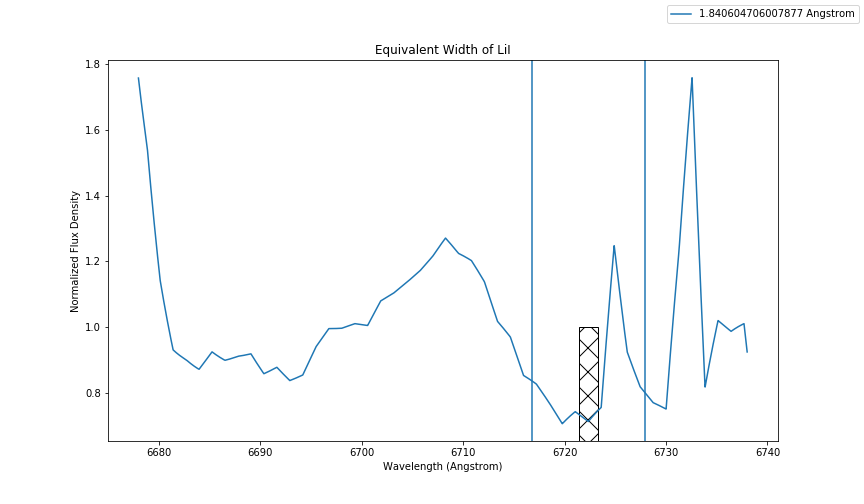

kastRED_J2235+1840_20180716.fits
None


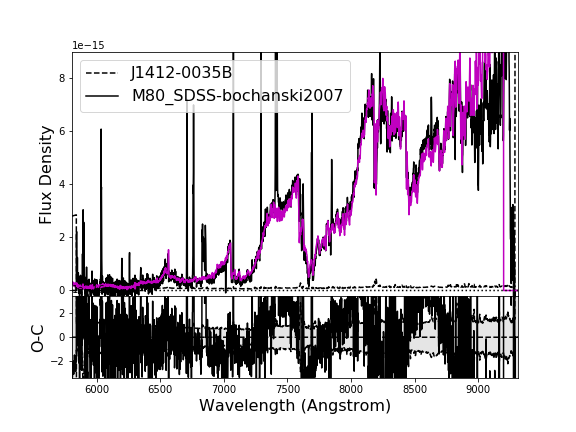

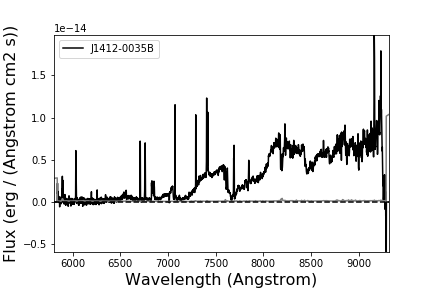

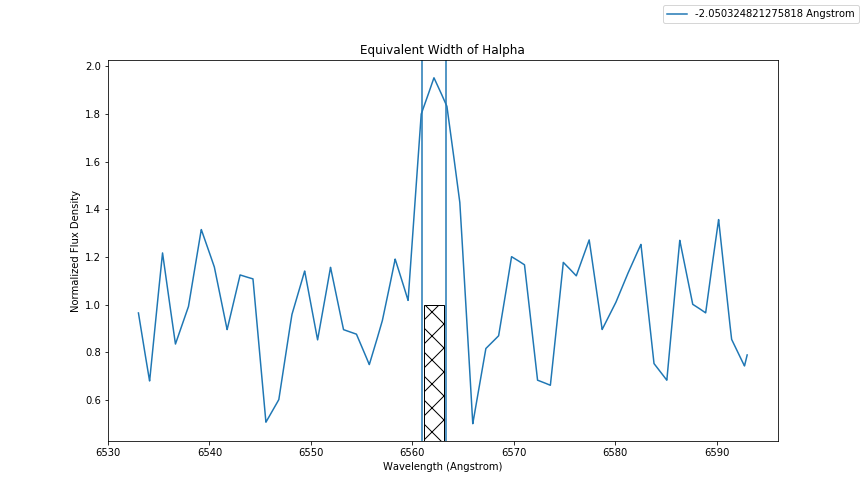

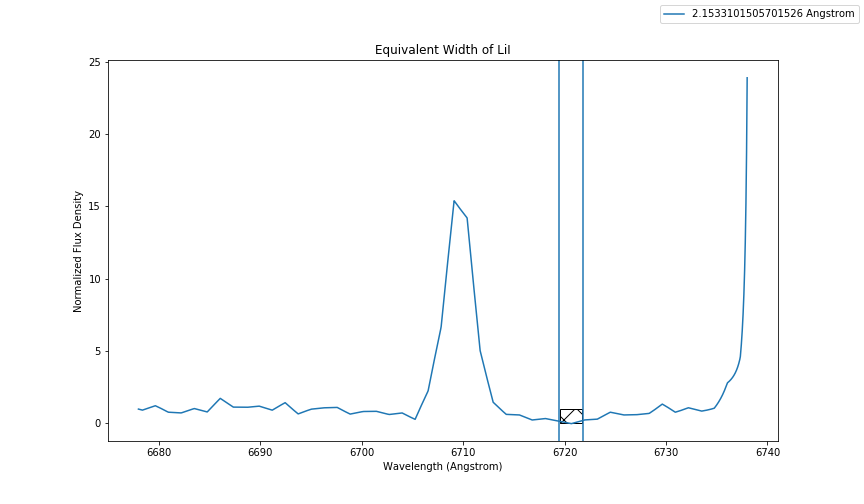

kastRED_J1412-0035B_20190331.fits
lto, S/N


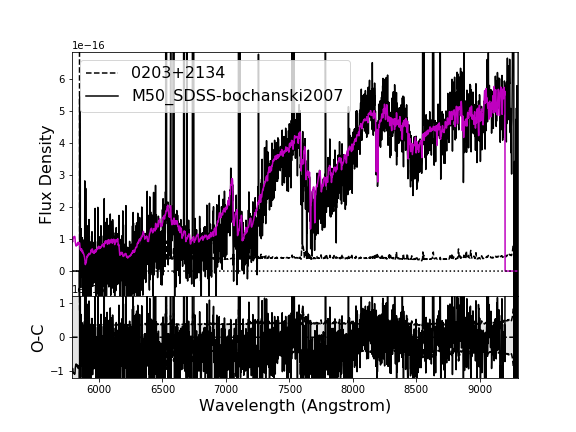

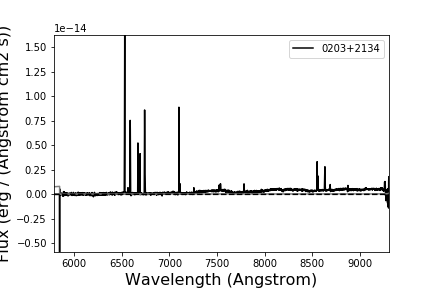

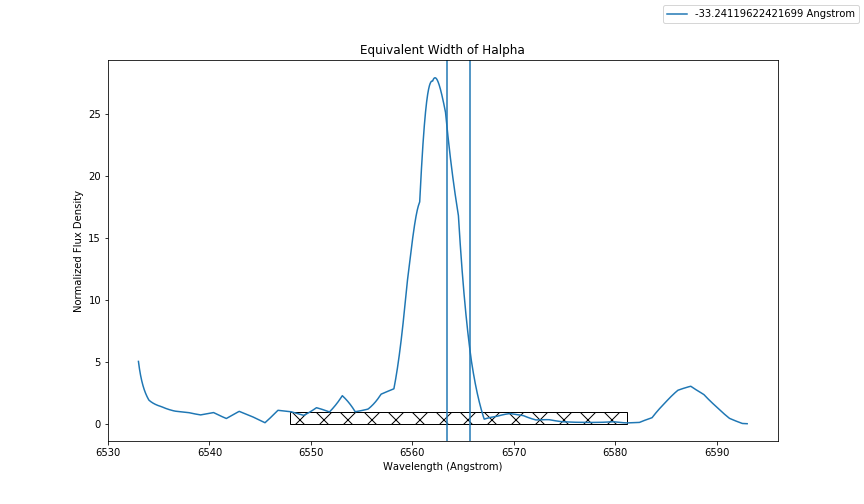

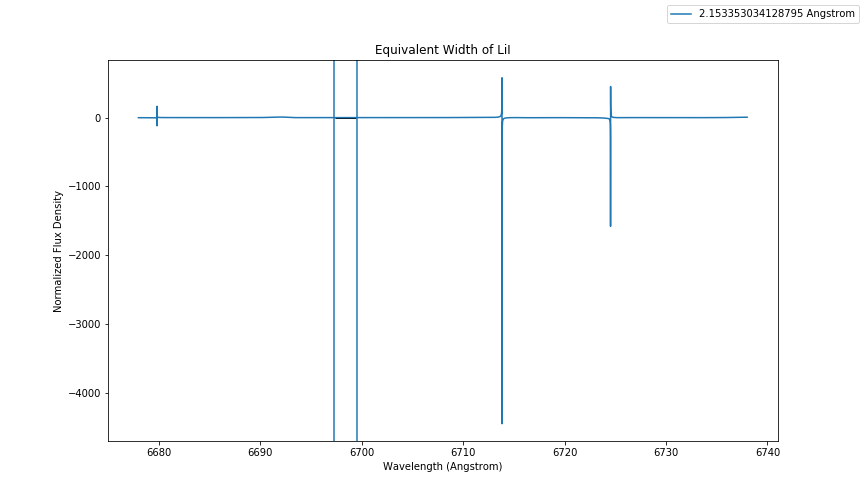

kastRED_J0203+2134_20170813.fits
lto, S/N


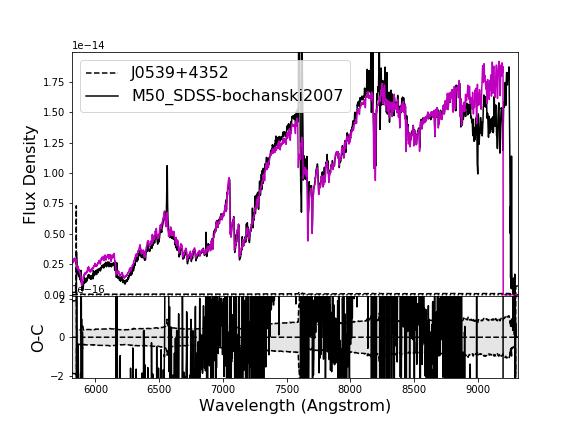

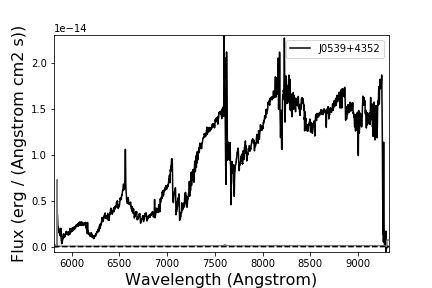

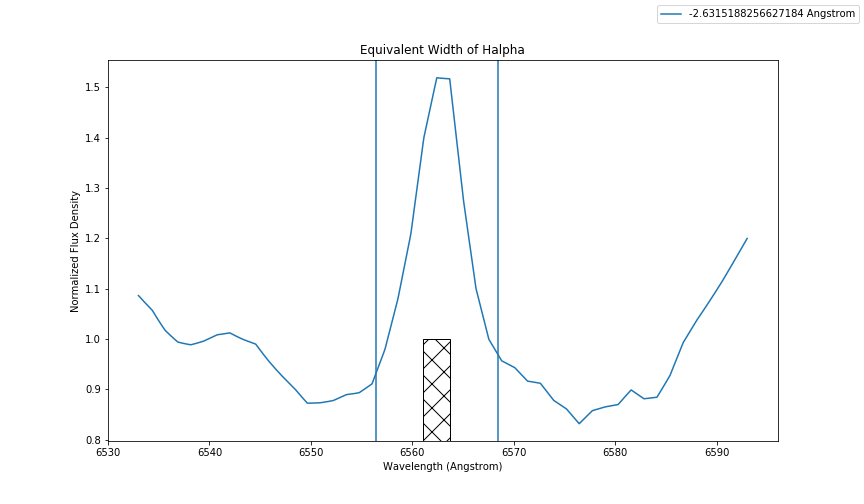

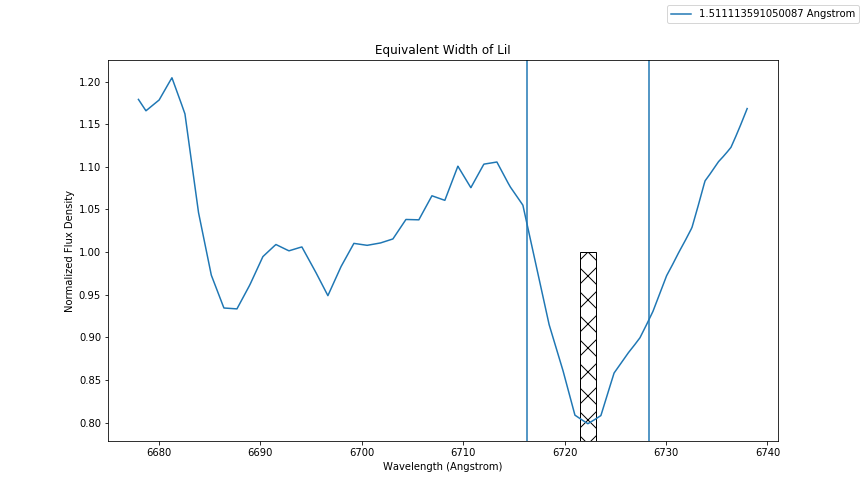

kastRED_J0539+4352_20200205.fits
None


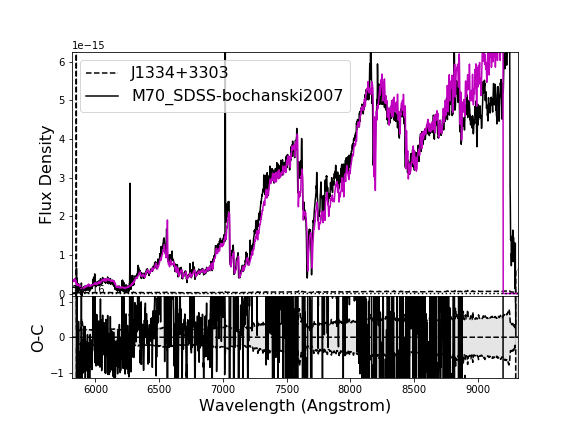

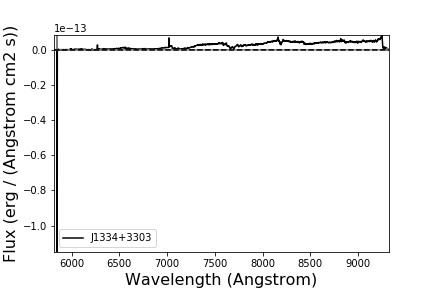

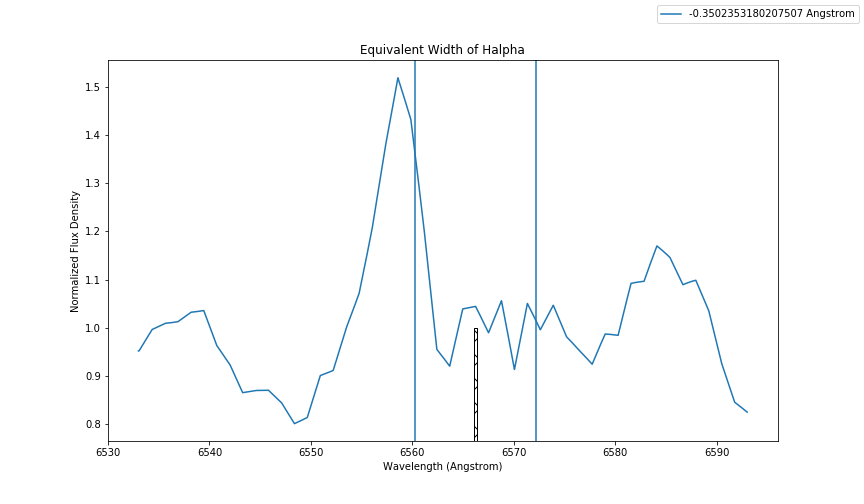

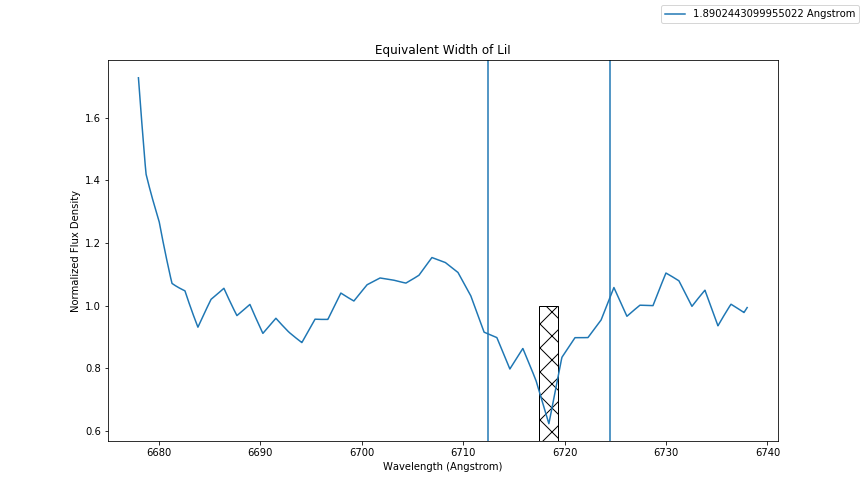

kastRED_J1334+3303_20200205.fits
None


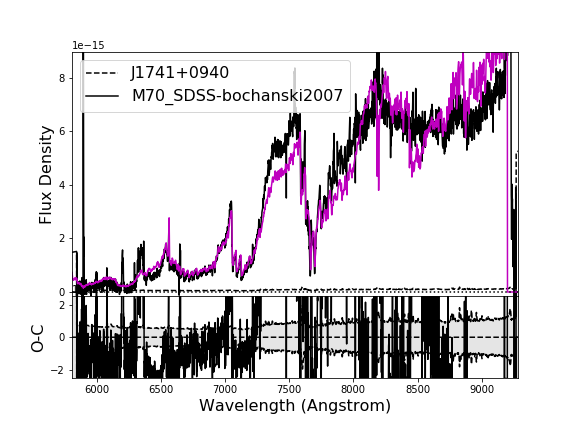

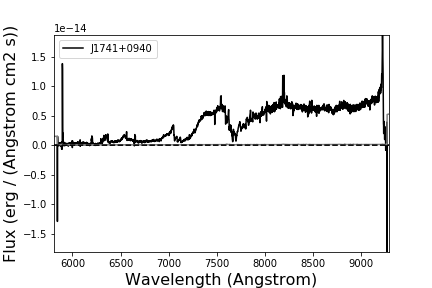

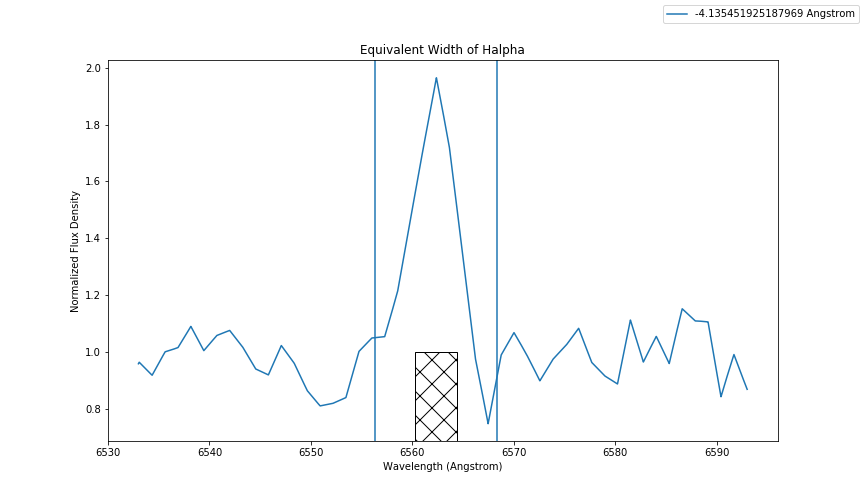

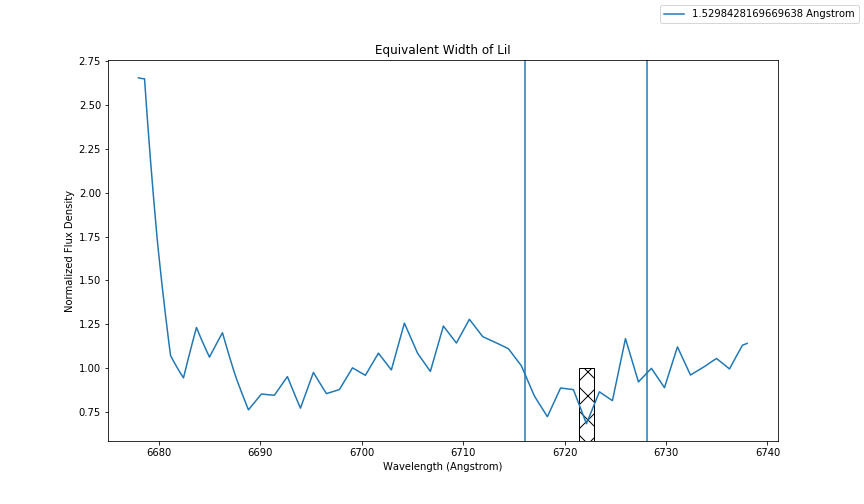

kastRED_J1741+0940_20200305.fits
lto, scq, spt_fixed, !


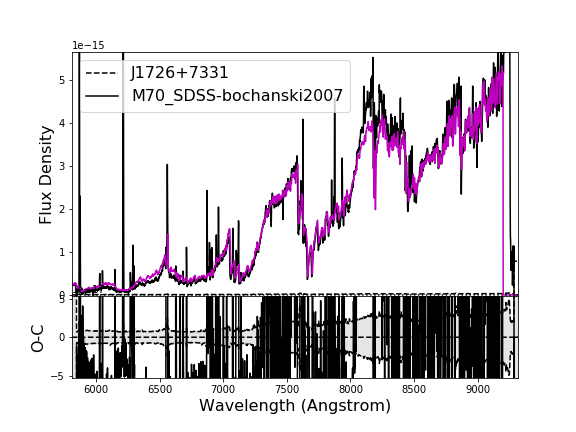

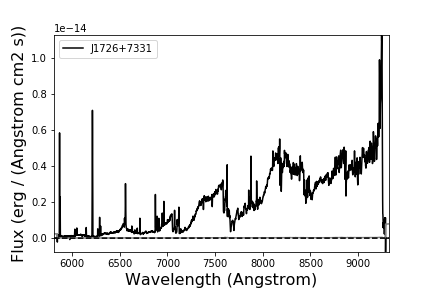

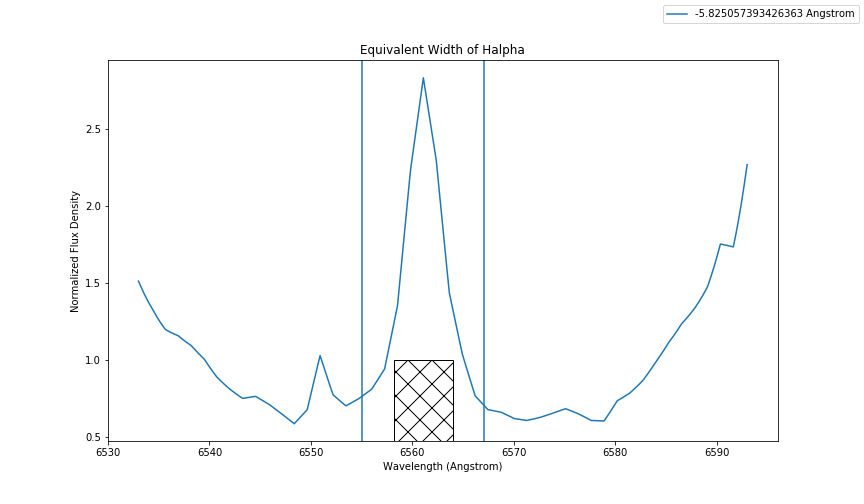

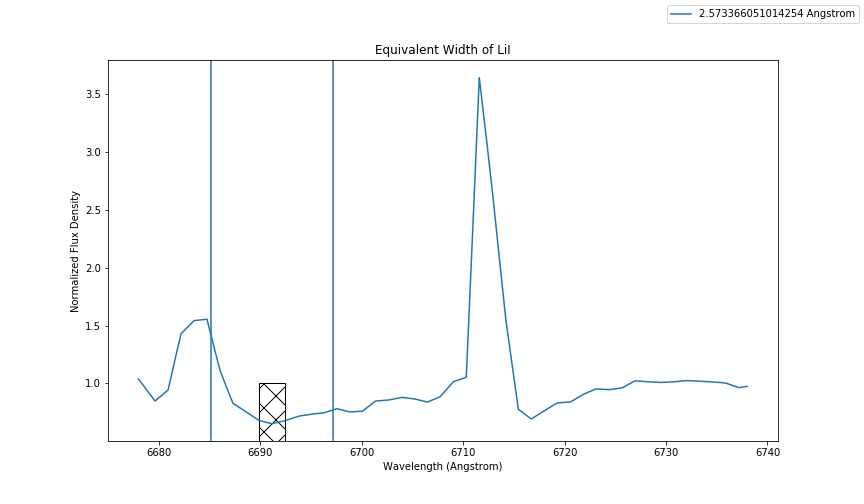

kastRED_J1726+7331_20180716.fits
None


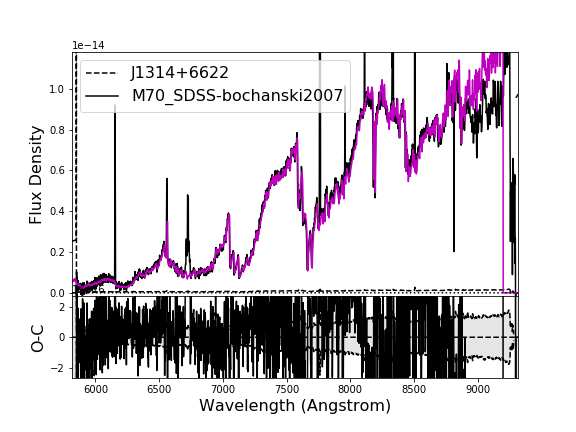

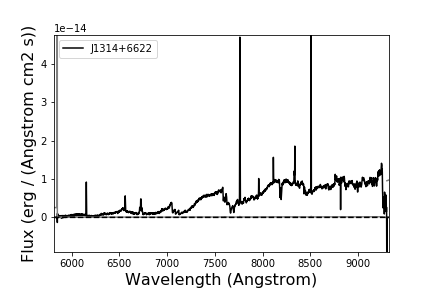

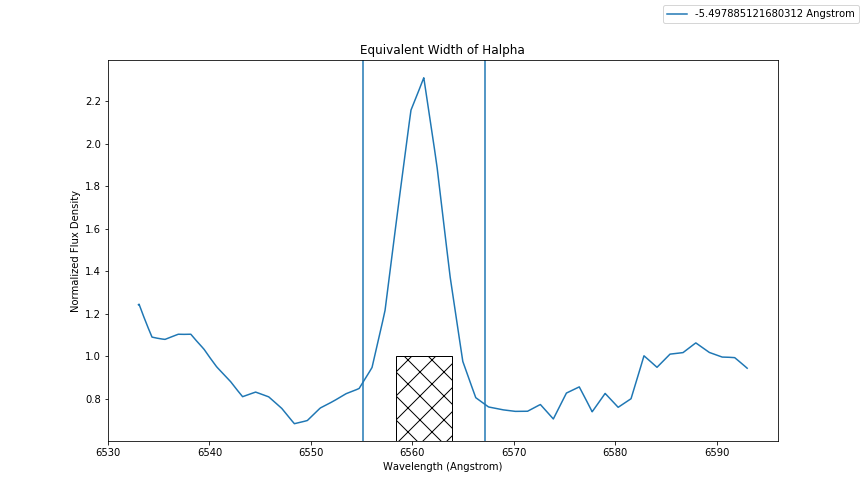

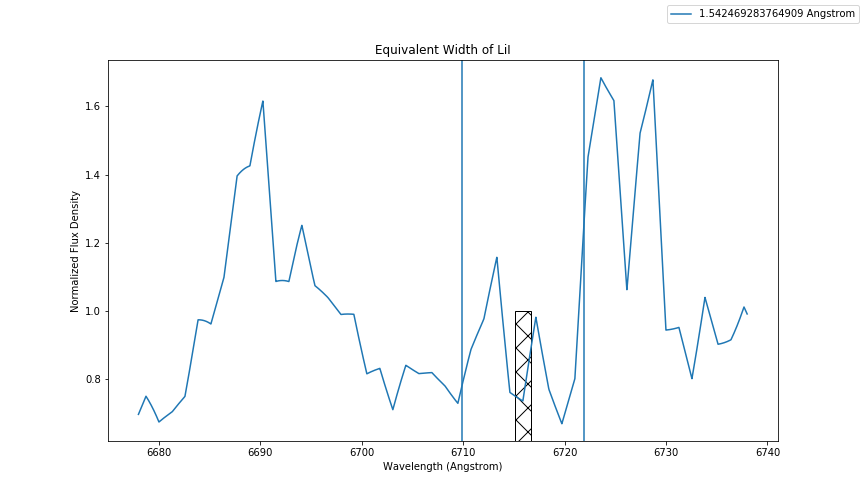

kastRED_J1314+6622_20200205.fits
lto, scq, spt_fixed


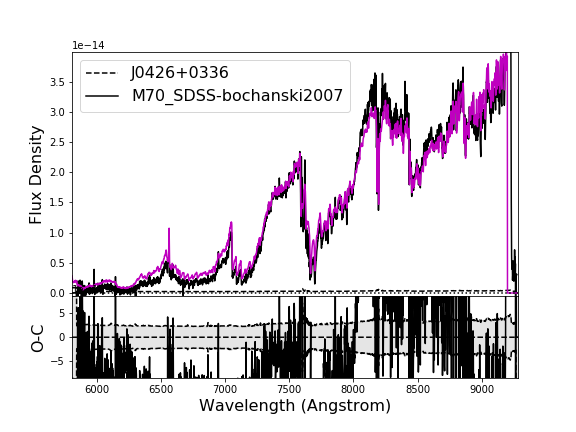

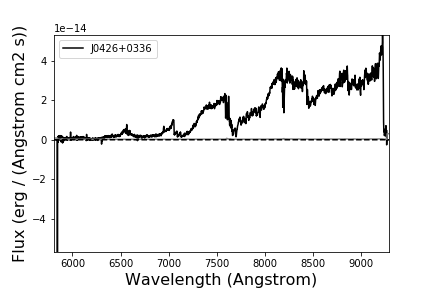

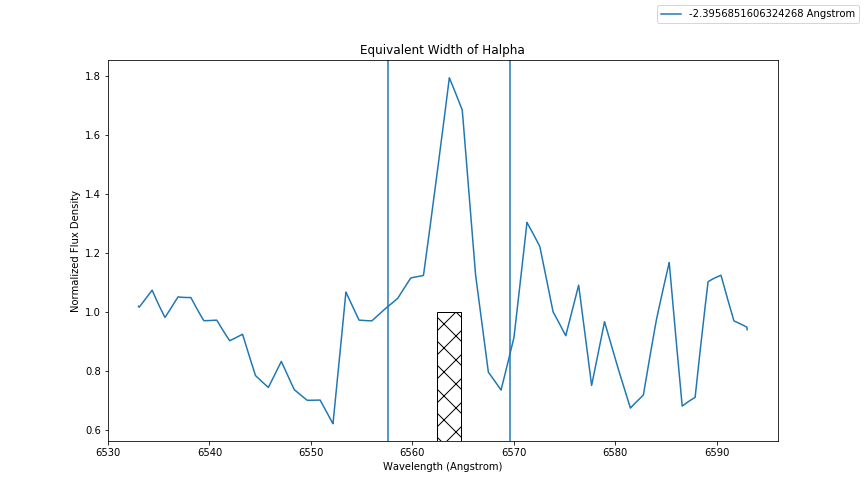

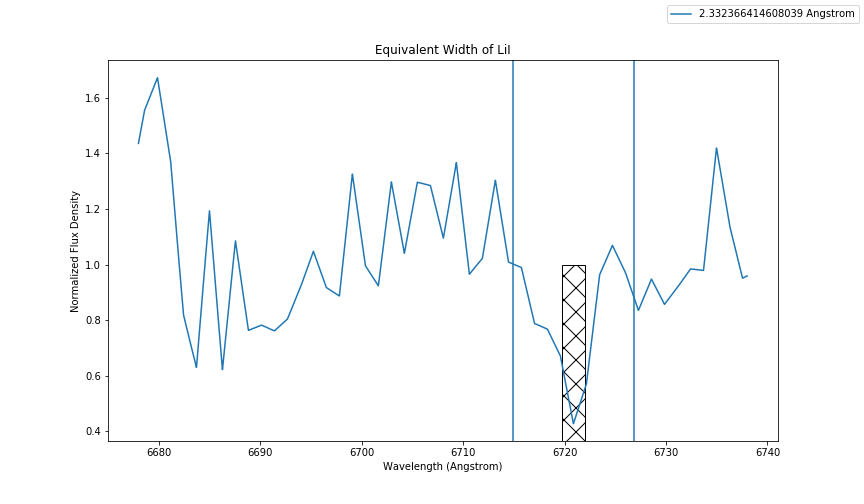

kastRED_J0426+0336_20200305.fits
lto


In [71]:
display_images(df[df['LiI_EW_(Angstrom)'] > 1.5], QA_path)

In [13]:
corrlist = [(fname, subtype[:-4], m_class, tags) for fname, subtype, m_class, tags in zip(df['filename'], df['spt'].values, df['metallicity_class'].values, df['tags'].values)]

non_corr = []

for cor_tuple in corrlist:
    if cor_tuple[1] == cor_tuple[2]:
        continue
    elif ((cor_tuple[1] == '') and (cor_tuple[2] == 'Dwarf')):
        continue
    else:
        non_corr.append(cor_tuple)
        
non_corr

[('kastRED_J0225+6229_20200203.fits', 'sd', 'Dwarf', nan),
 ('kastRED_J1856-0822B_20190920.fits', '', 'esd', 'S/N'),
 ('kastRED_SN2018GV_20180121.fits', '', 'usd', 'OO'),
 ('kastRED_J1933+2150C_20190918.fits', 'sd', 'Dwarf', 'S/N'),
 ('kastRED_J1705-0226B_20180622.fits', 'sd', 'usd', 'S/N'),
 ('kastRED_J0355+4525B_20200205.fits', '', 'esd', 'S/N'),
 ('kastRED_J1718+6802_20180622.fits', 'sd', 'Dwarf', 'lto, scq'),
 ('kastRED_J1755+3958B_20170813.fits', '', 'usd', 'S/N'),
 ('kastRED_J1740-1650E_20190920.fits', '', 'usd', 'S/N'),
 ('kastRED_J1306+1212_20200203.fits', 'sd', 'Dwarf', 'lto, scq'),
 ('kastRED_J1833+2225D_20190918.fits', '', 'usd', 'S/N'),
 ('kastRED_J0416+1310B_20200204.fits', '', 'usd', 'S/N'),
 ('kastRED_J1726+7331B_20180716.fits', '', 'usd', 'S/N'),
 ('kastRED_J1755+3958_20170813.fits', '', 'usd', 'OO'),
 ('kastRED_J0819-1345C_20200206.fits', '', 'usd', 'S/N'),
 ('kastRED_J0819-1345B_20200206.fits', '', 'usd', 'S/N'),
 ('kastRED_J1856-0822C_20190920.fits', '', 'esd', 'OO')

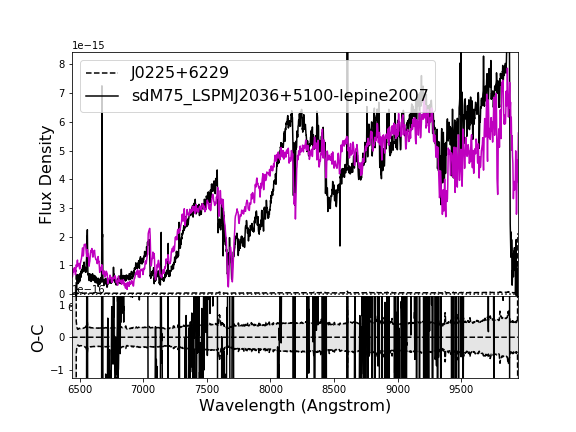

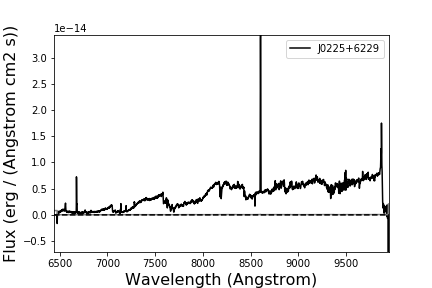

kastRED_J0225+6229_20200203.fits


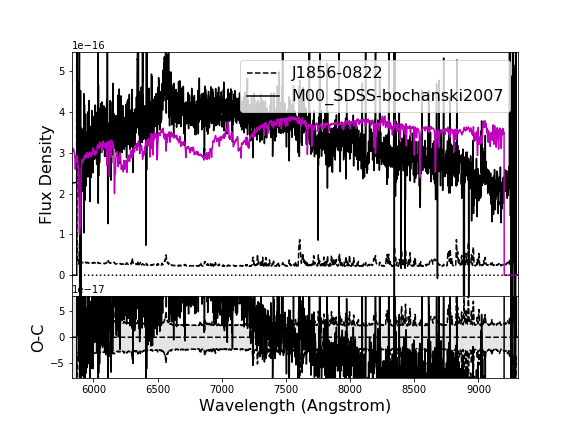

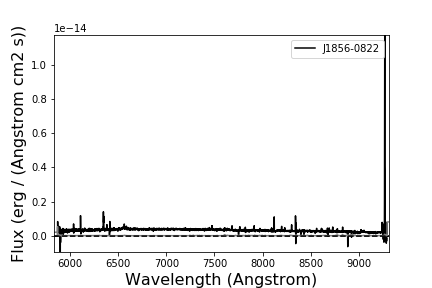

kastRED_J1856-0822B_20190920.fits


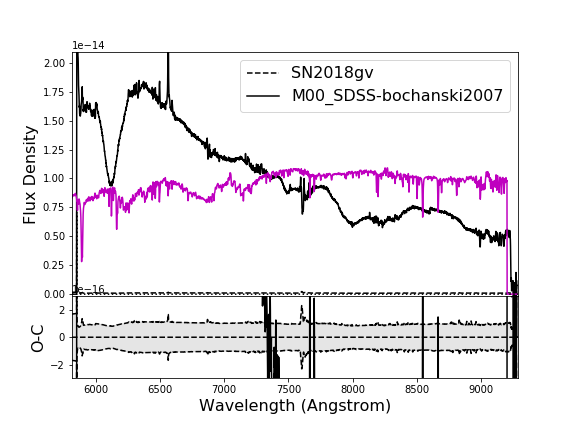

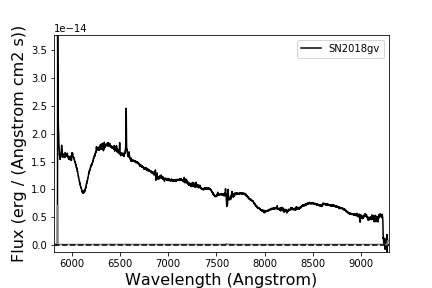

kastRED_SN2018GV_20180121.fits


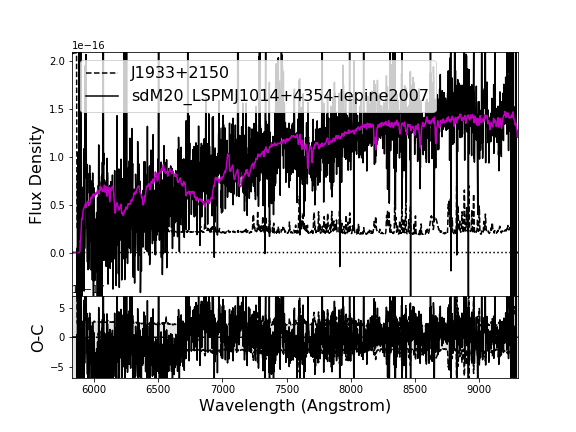

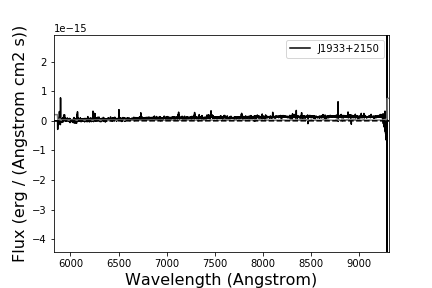

kastRED_J1933+2150C_20190918.fits


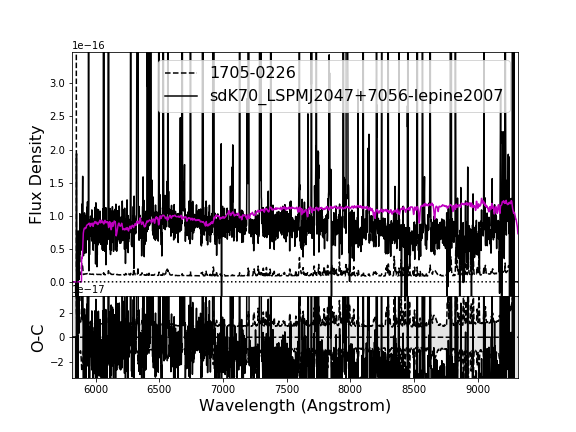

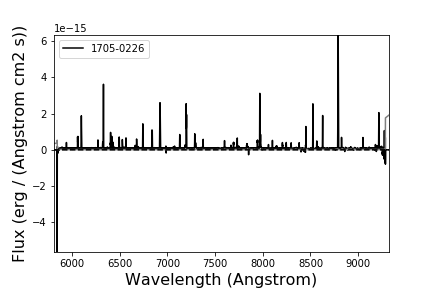

kastRED_J1705-0226B_20180622.fits


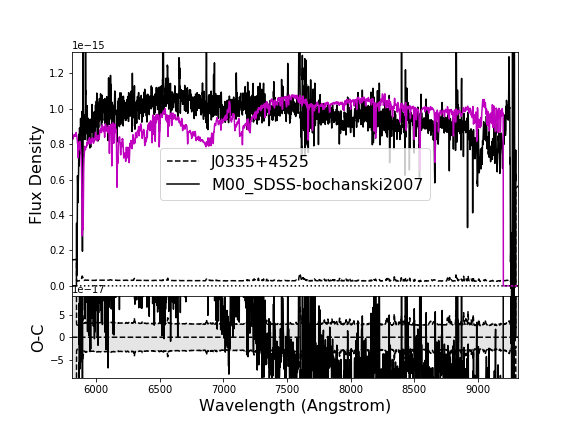

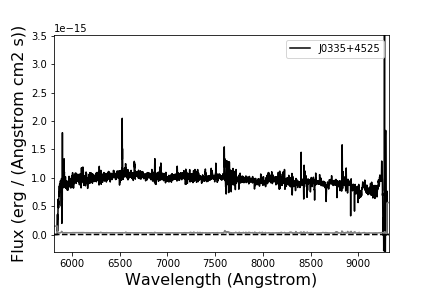

kastRED_J0355+4525B_20200205.fits


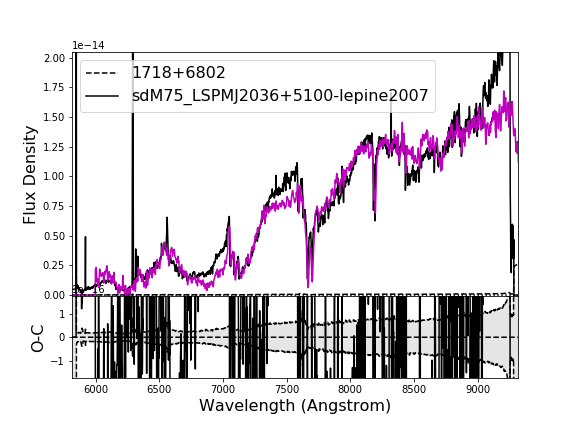

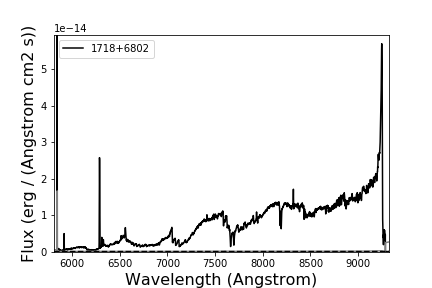

kastRED_J1718+6802_20180622.fits


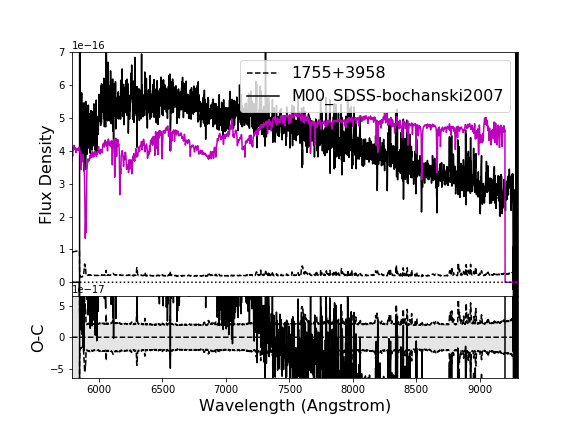

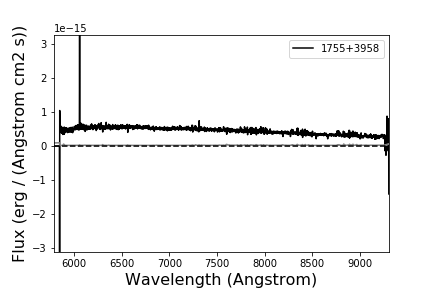

kastRED_J1755+3958B_20170813.fits


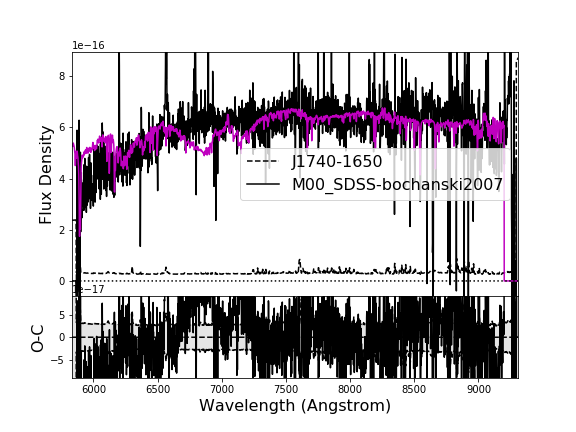

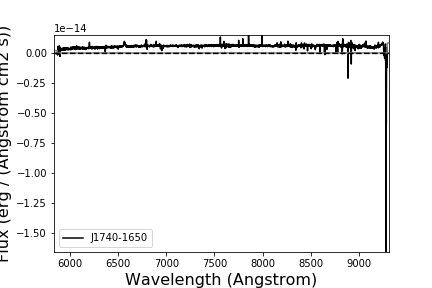

kastRED_J1740-1650E_20190920.fits


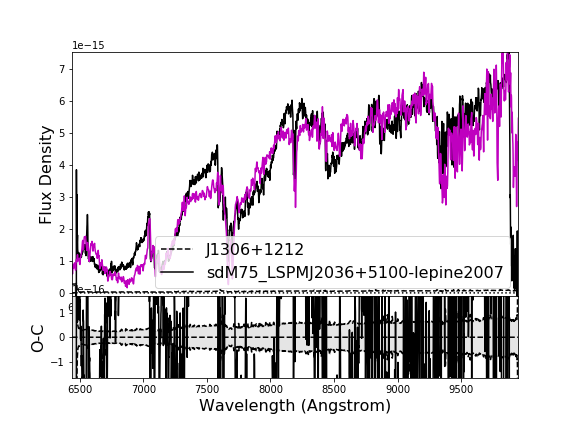

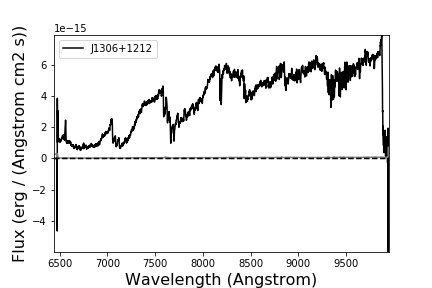

kastRED_J1306+1212_20200203.fits


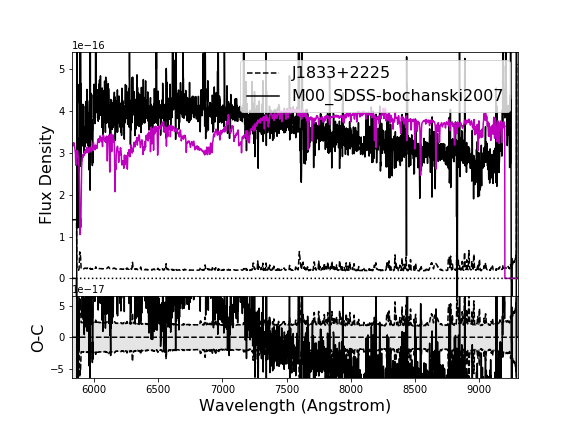

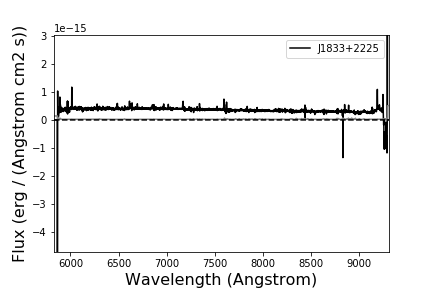

kastRED_J1833+2225D_20190918.fits


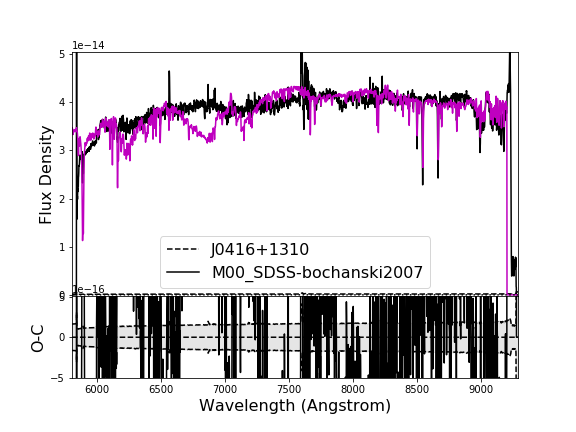

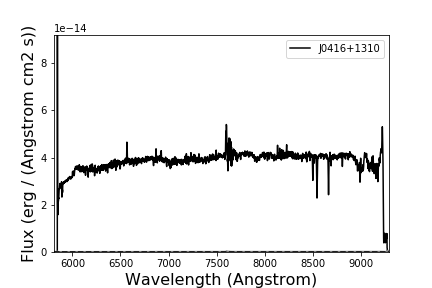

kastRED_J0416+1310B_20200204.fits


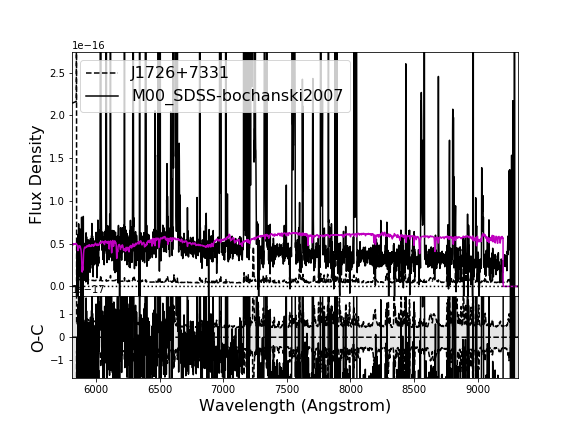

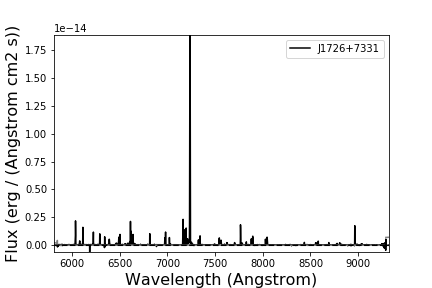

kastRED_J1726+7331B_20180716.fits


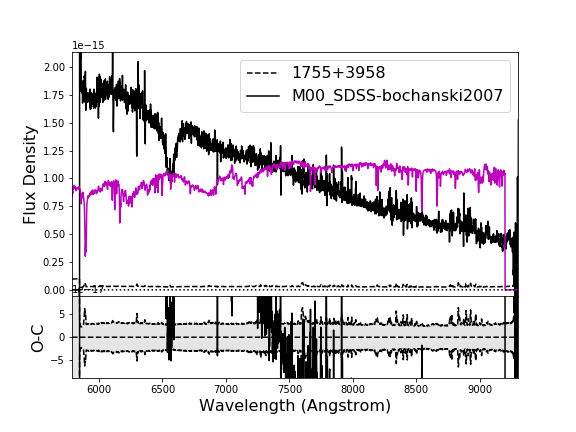

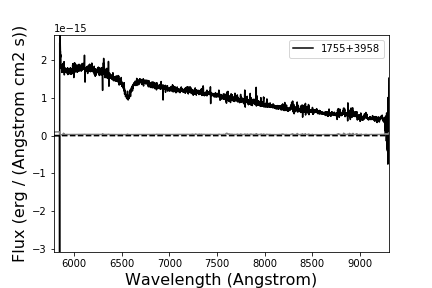

kastRED_J1755+3958_20170813.fits


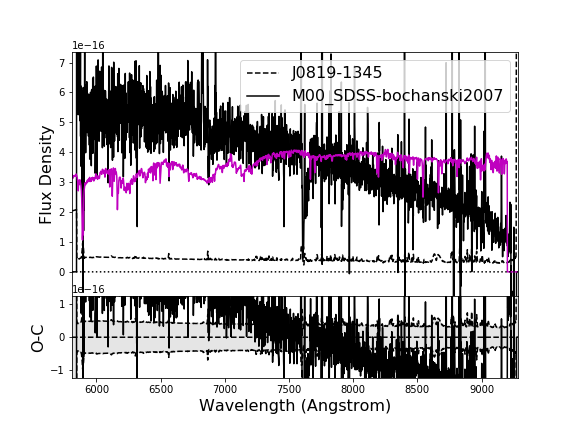

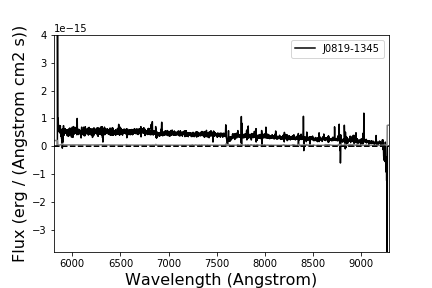

kastRED_J0819-1345C_20200206.fits


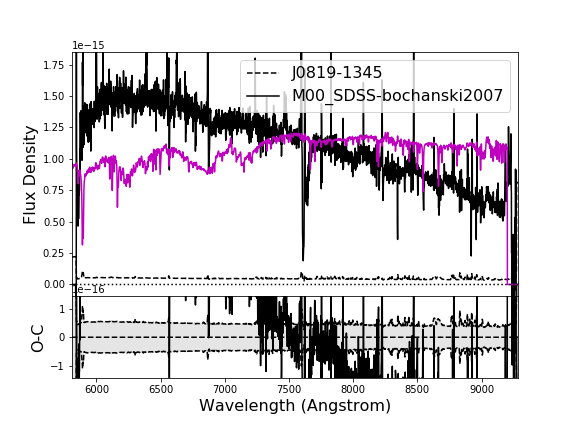

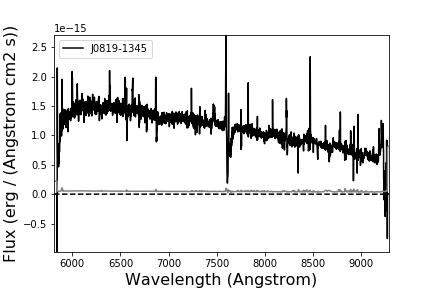

kastRED_J0819-1345B_20200206.fits


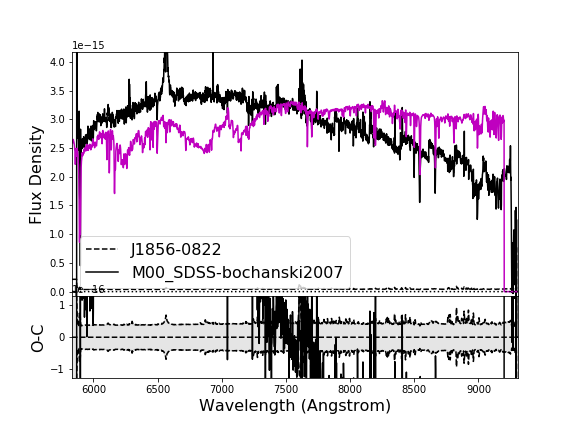

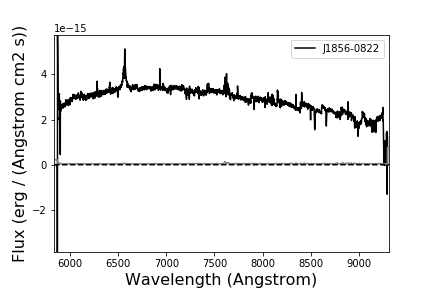

kastRED_J1856-0822C_20190920.fits


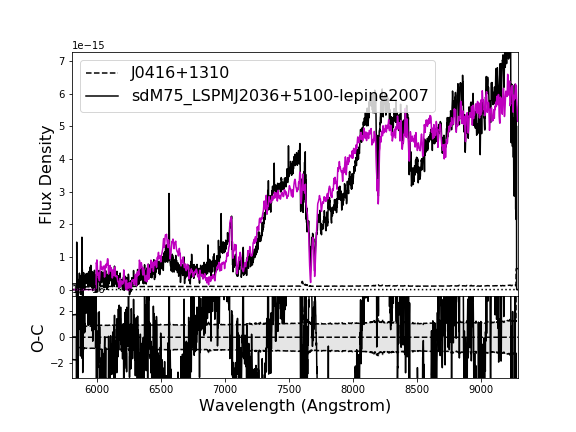

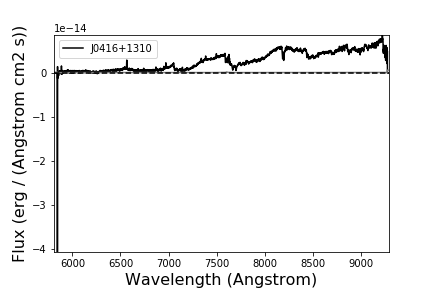

kastRED_J0416+1310_20200204.fits


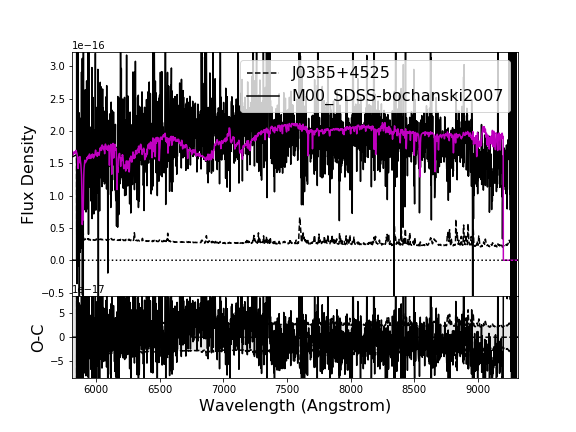

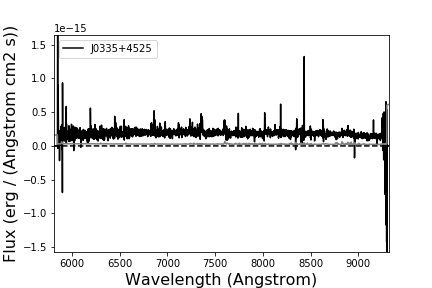

kastRED_J0355+4525E_20200205.fits


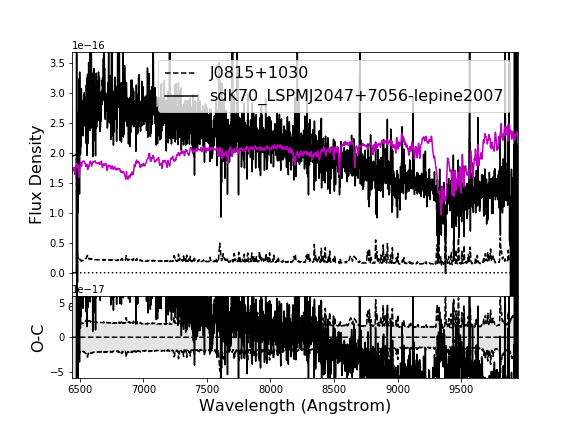

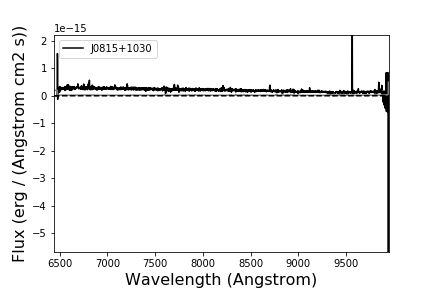

kastRED_J0815+1030B_20200203.fits


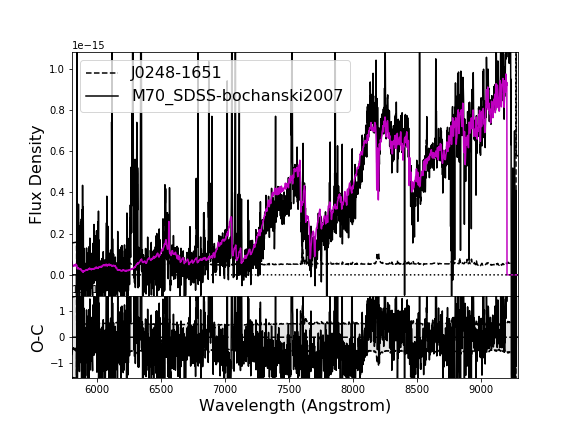

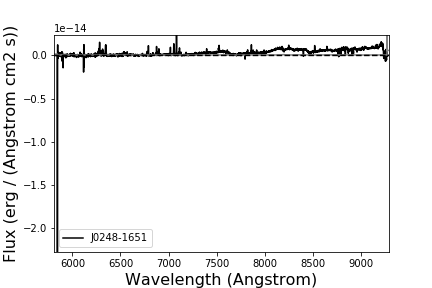

kastRED_J0248-1651_20200204.fits


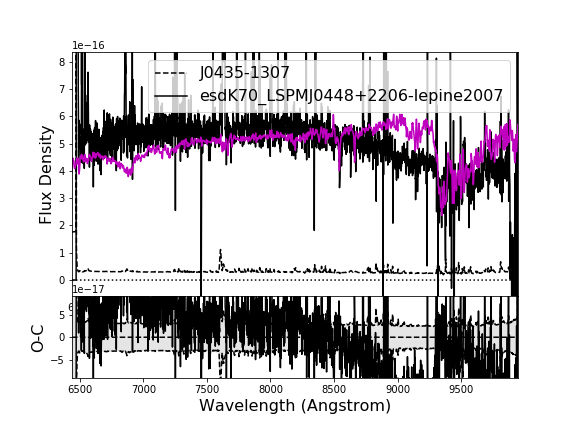

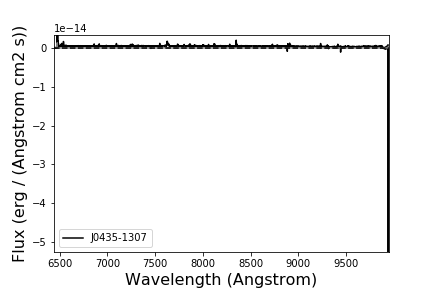

kastRED_J0435-1307_20200203.fits


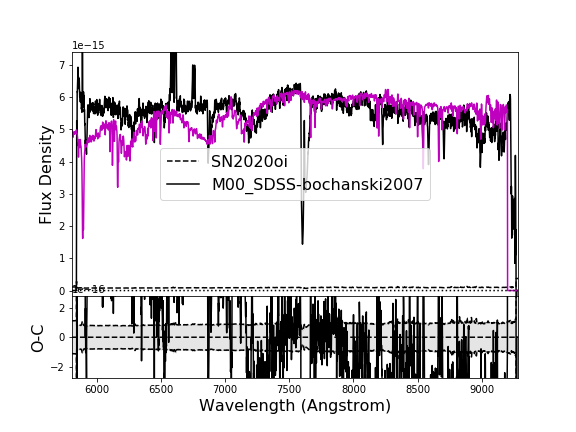

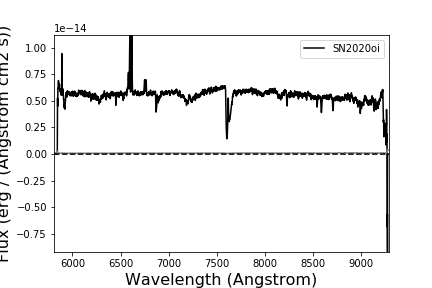

kastRED_SN2020OI-HOST_20200111.fits


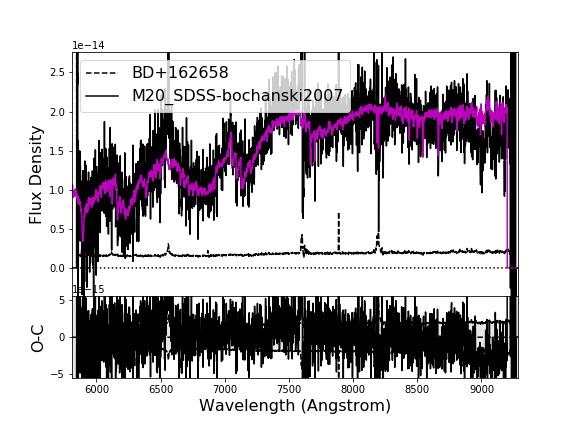

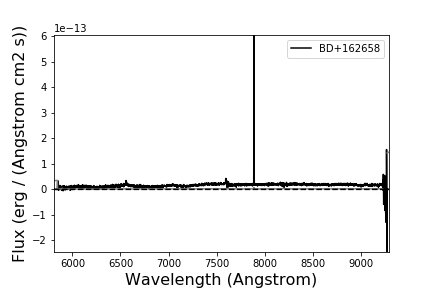

kastRED_BD162658_20180307.fits


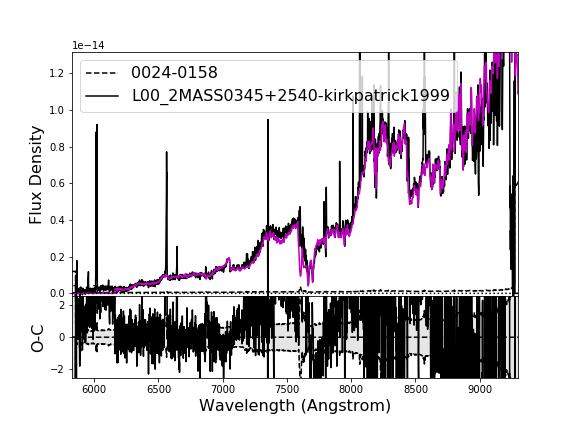

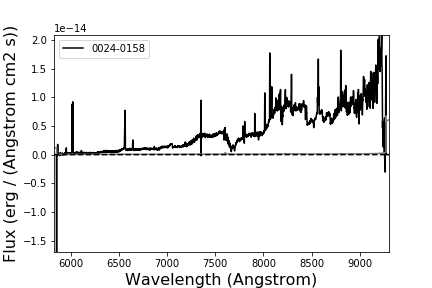

kastRED_J0024-0158_20170817.fits


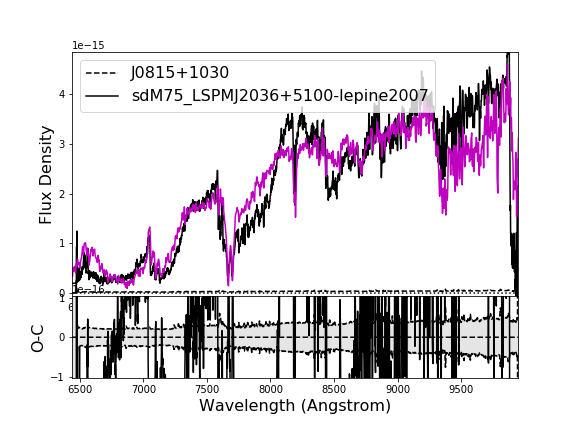

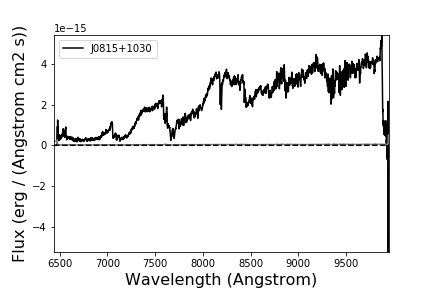

kastRED_J0815+1030_20200203.fits


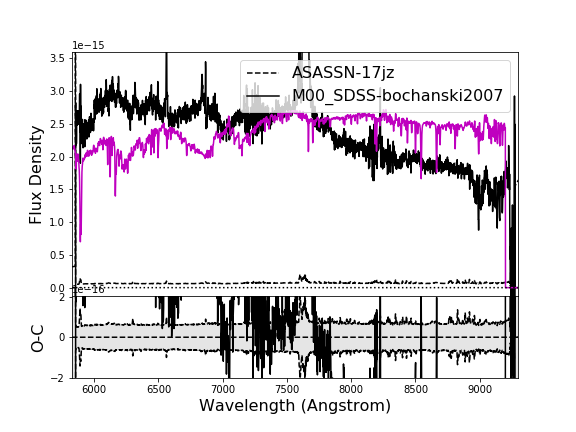

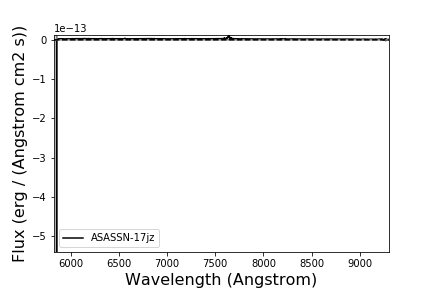

kastRED_ASASSN-17JZ_20170817.fits


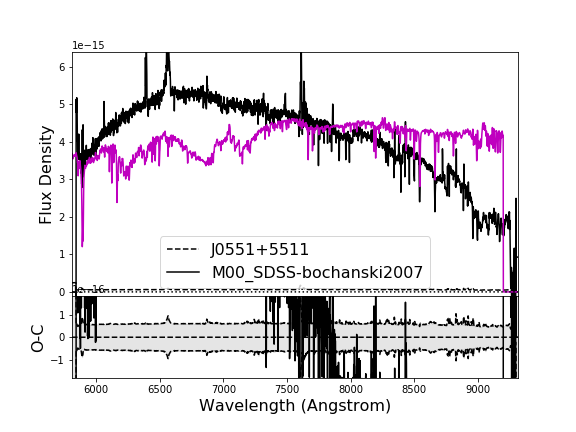

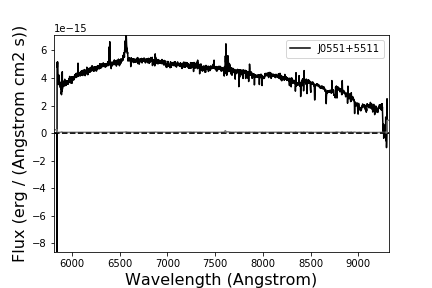

kastRED_J0551+5511B_20200205.fits


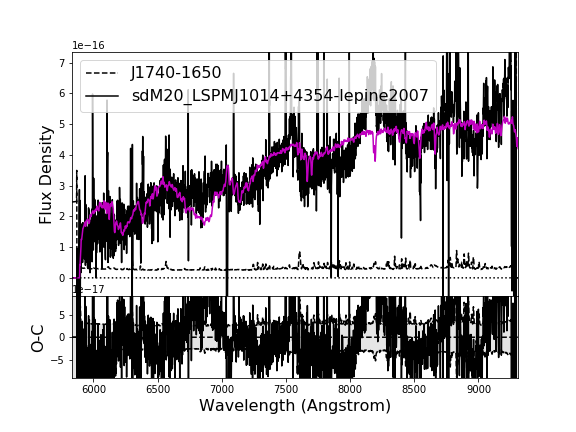

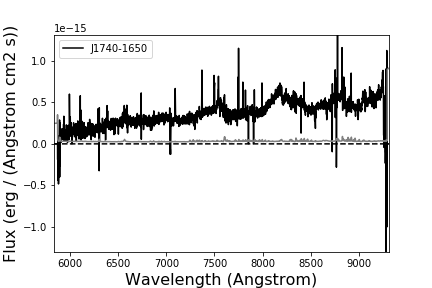

kastRED_J1740-1650B_20190920.fits


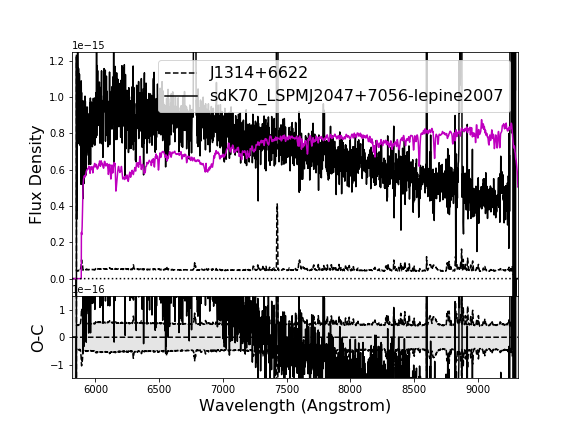

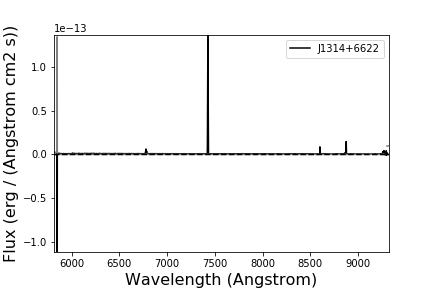

kastRED_J1314+6622B_20200205.fits


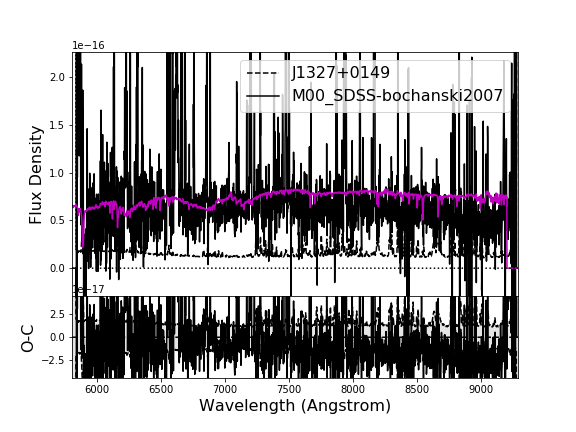

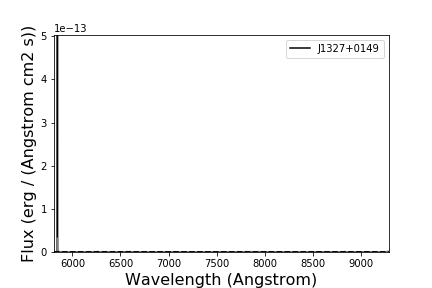

kastRED_J1327+0149B_20200204.fits


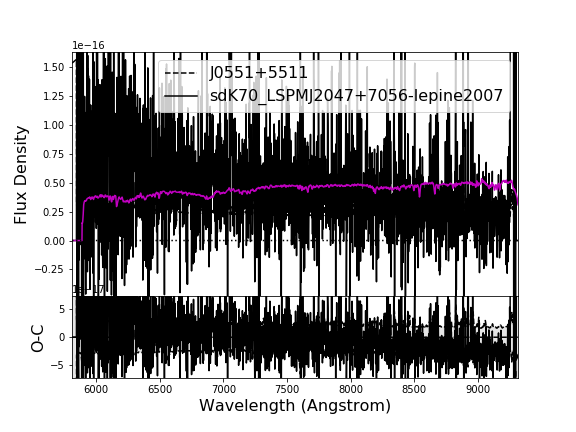

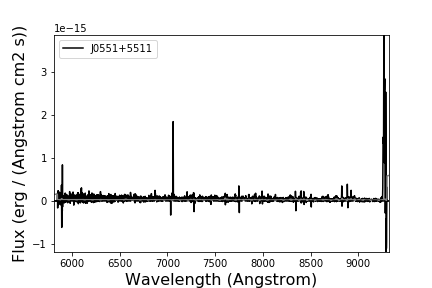

kastRED_J0551+5511D_20200205.fits


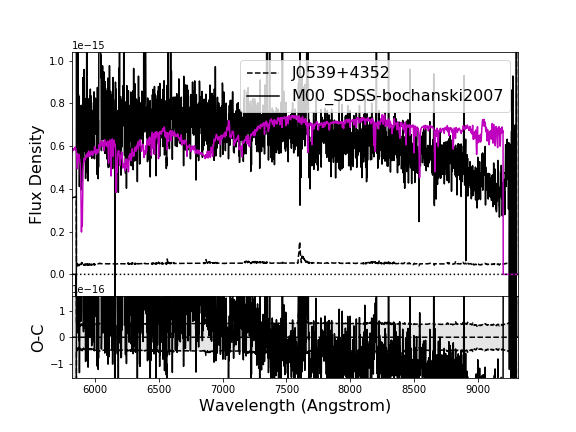

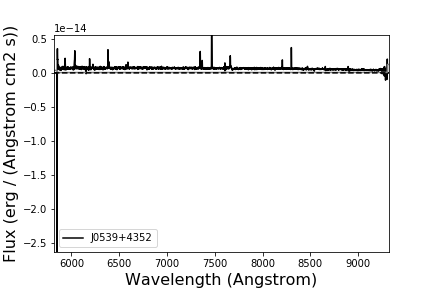

kastRED_J0539+4352B_20200110.fits


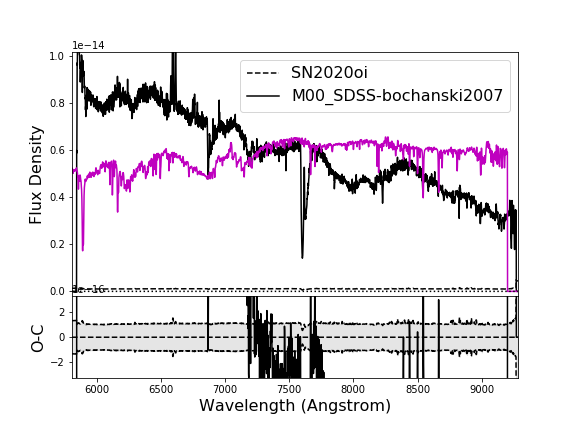

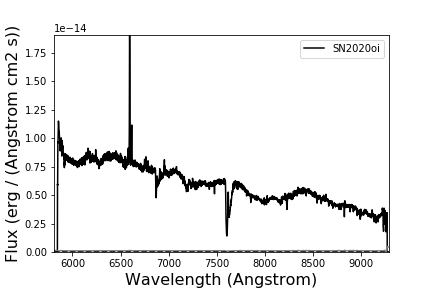

kastRED_SN2020OI_20200111.fits


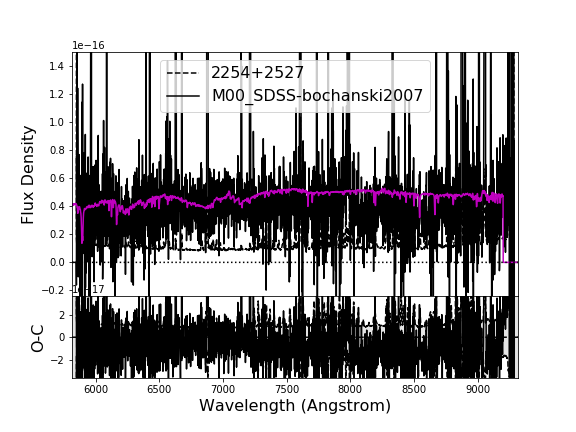

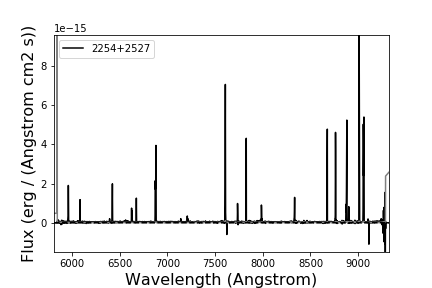

kastRED_J2254+2527B_20180622.fits


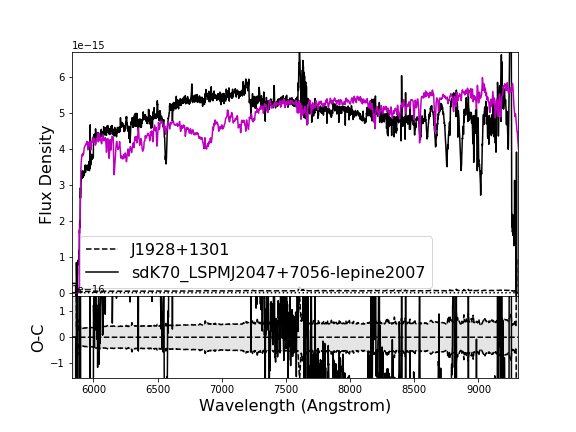

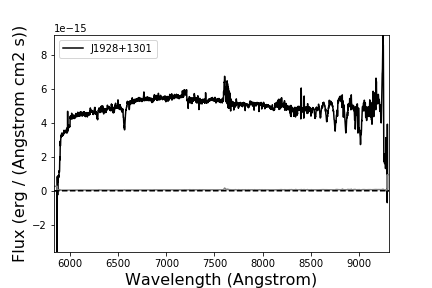

kastRED_J1928+1301D_20190920.fits


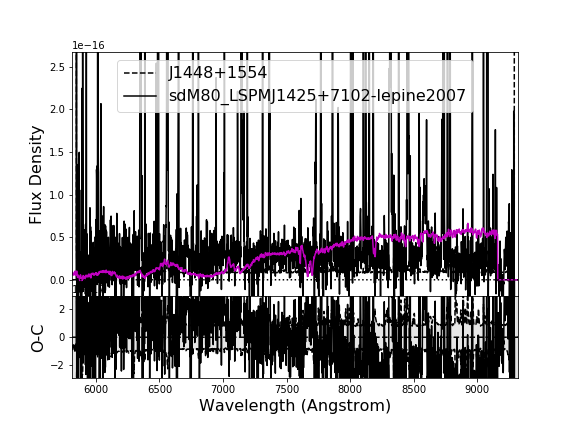

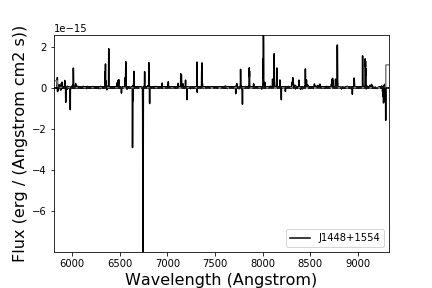

kastRED_J1448+1554C_20180717.fits


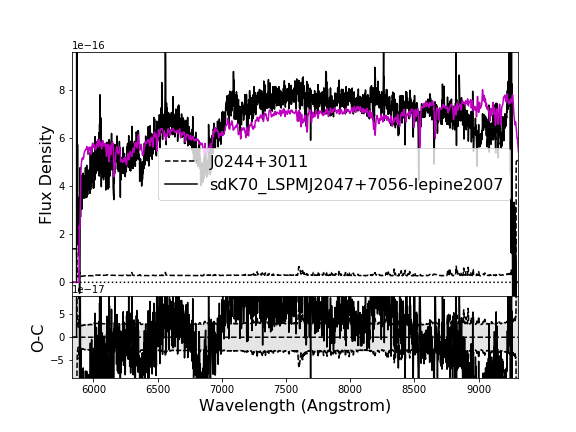

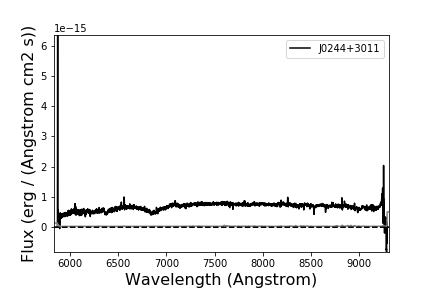

kastRED_J0244+3011_20190920.fits


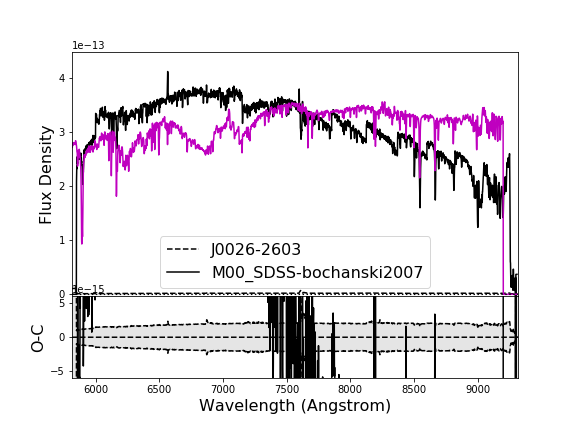

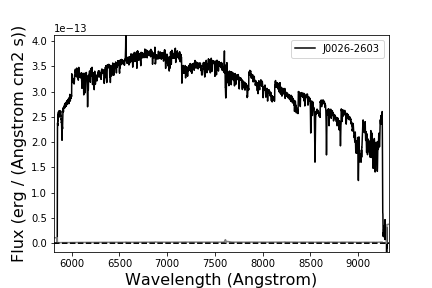

kastRED_J0026-2608_20200110.fits


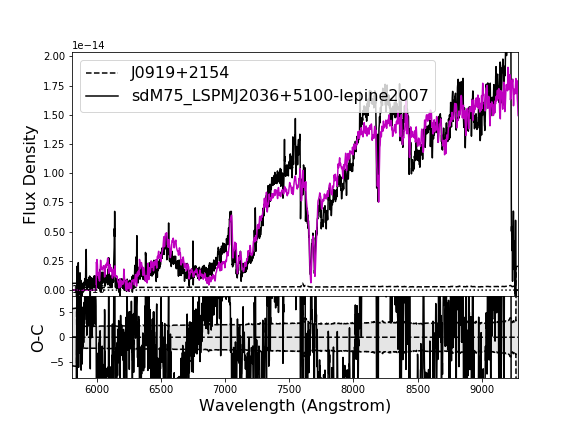

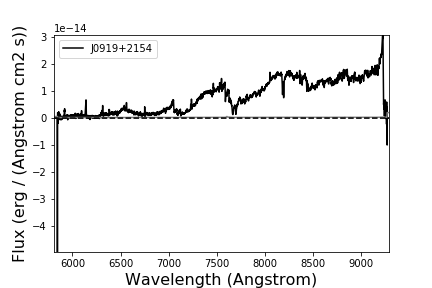

kastRED_J0919+2154_20200305.fits


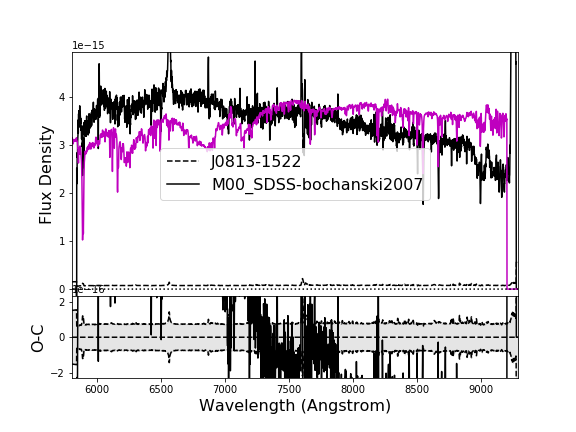

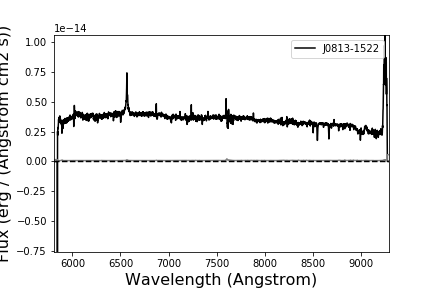

kastRED_J0813-1522B_20200204.fits


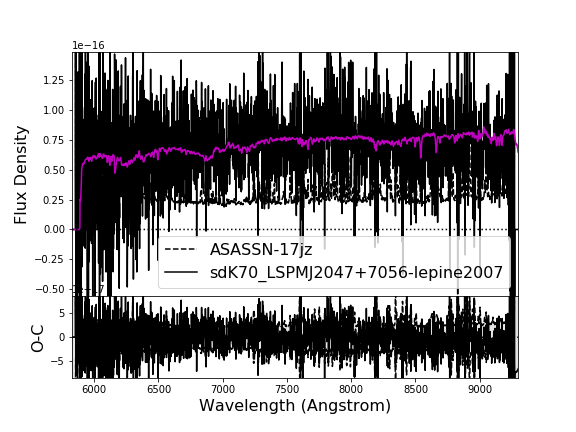

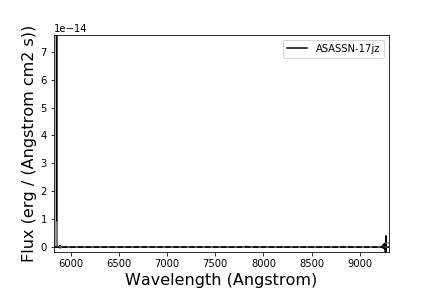

kastRED_ASASSN-17JZ-B_20170817.fits


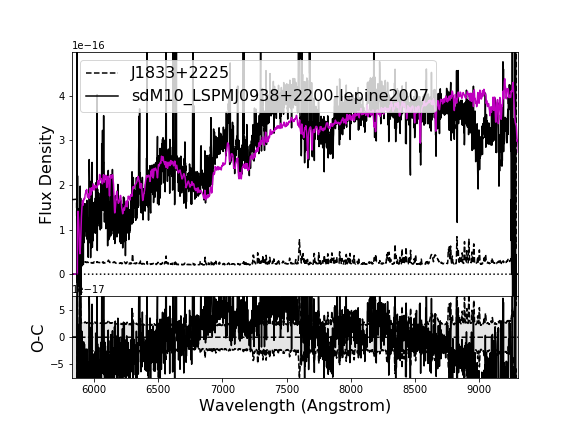

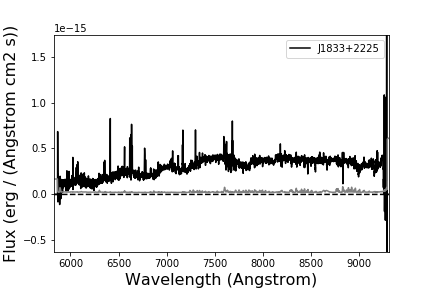

kastRED_J1833+2225_20190918.fits


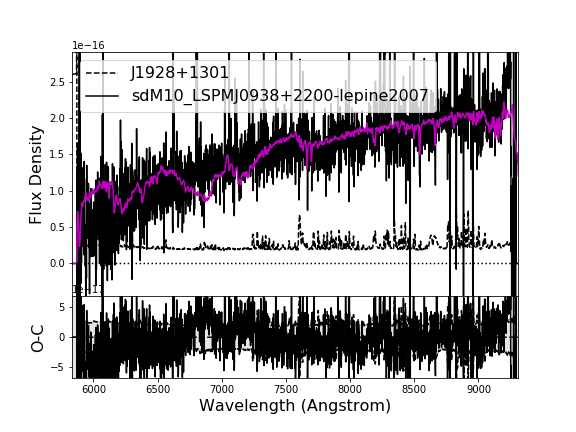

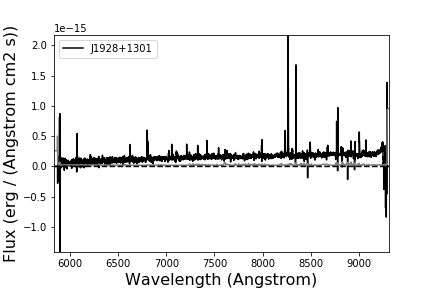

kastRED_J1928+1301B_20190920.fits


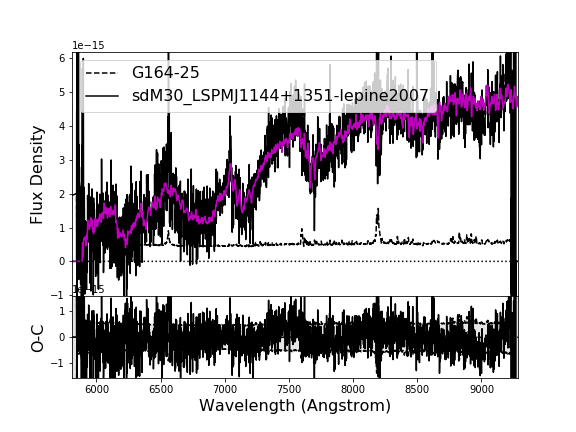

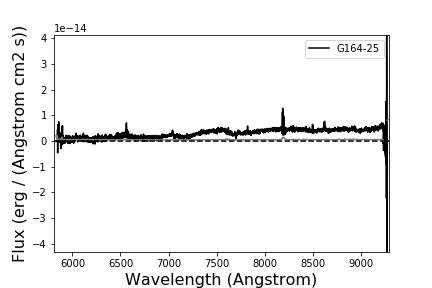

kastRED_G164-25_20180307.fits


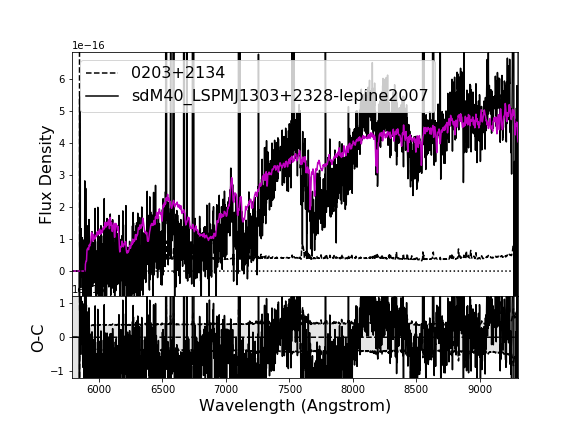

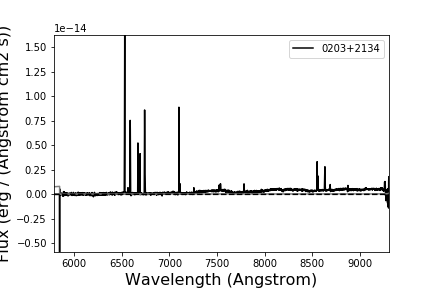

kastRED_J0203+2134_20170813.fits


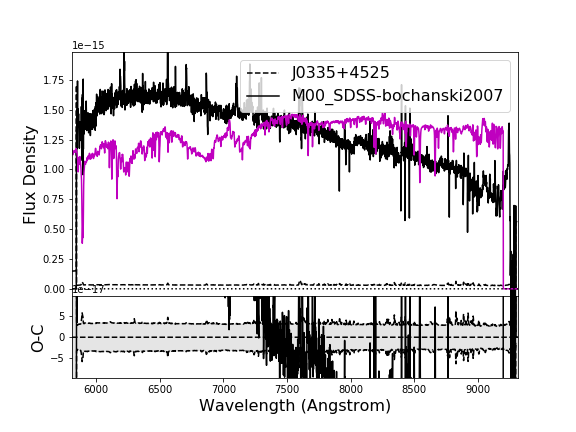

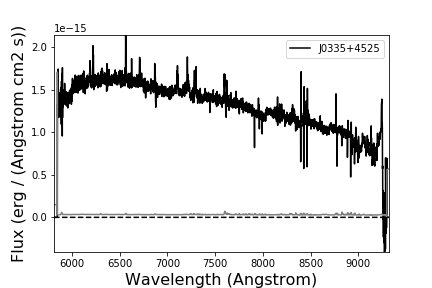

kastRED_J0355+4525_20200205.fits


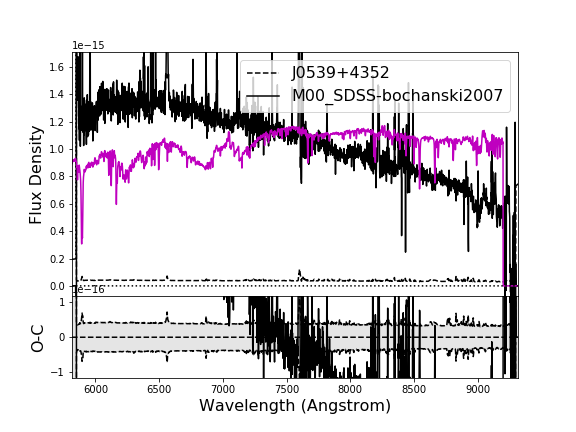

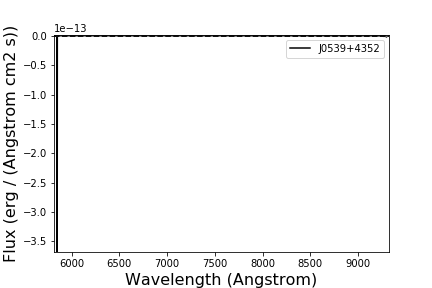

kastRED_J0539+4352B_20200205.fits


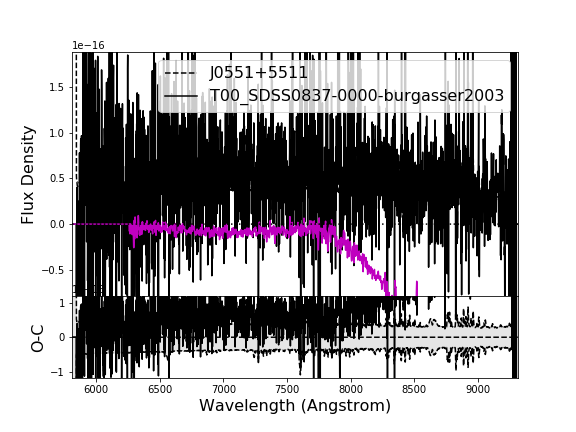

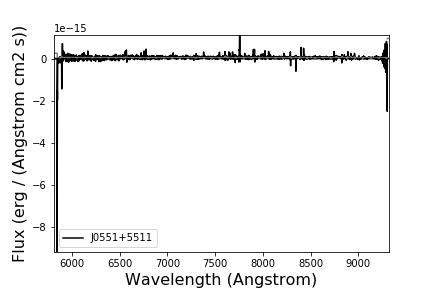

kastRED_J0551+5511C_20200205.fits


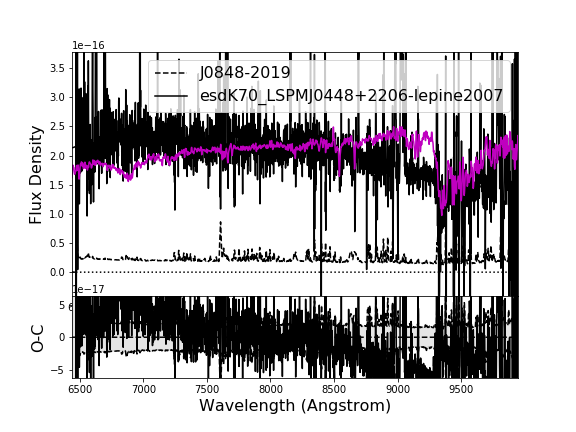

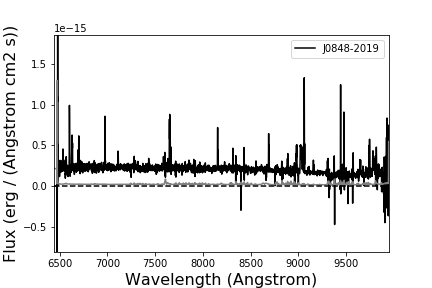

kastRED_J0848-2019B_20200203.fits


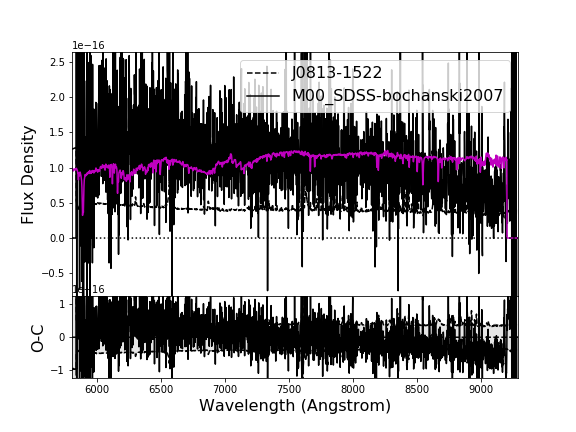

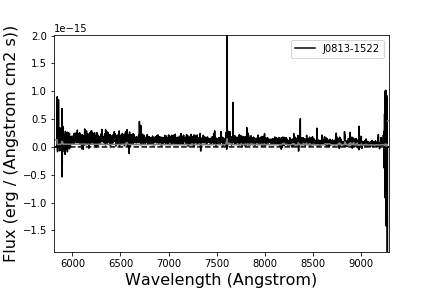

kastRED_J0813-1522C_20200204.fits


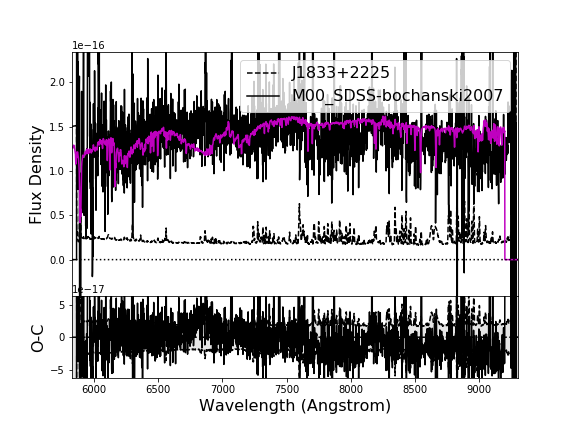

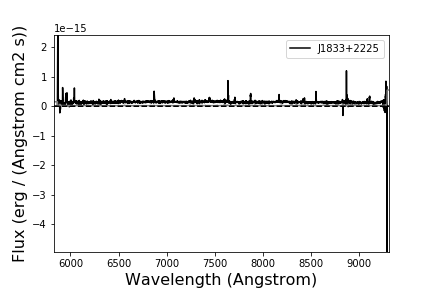

kastRED_J1833+2225B_20190918.fits


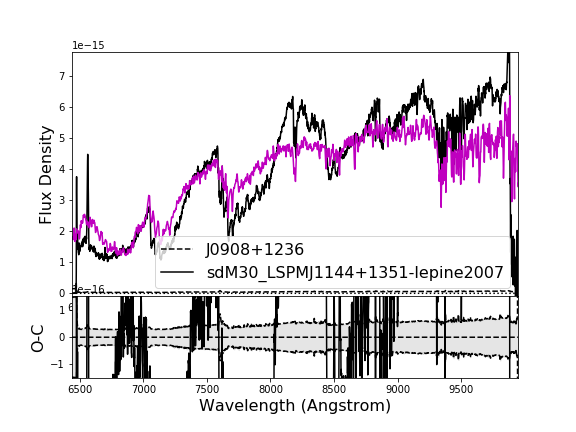

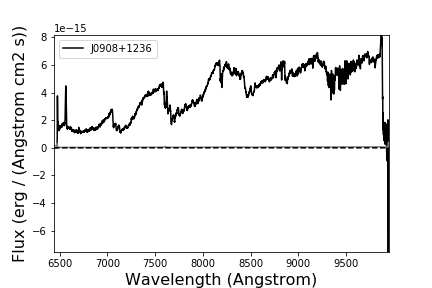

kastRED_J0908+1236_20200203.fits


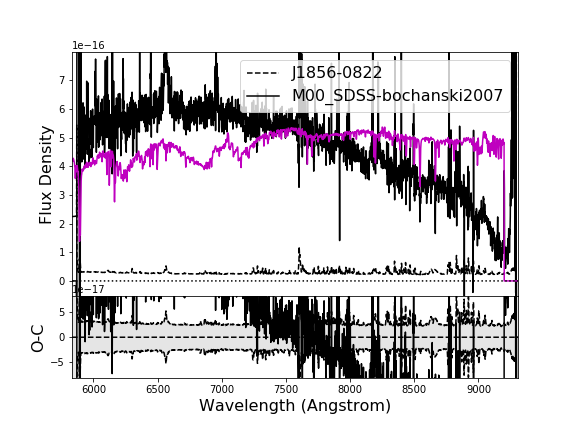

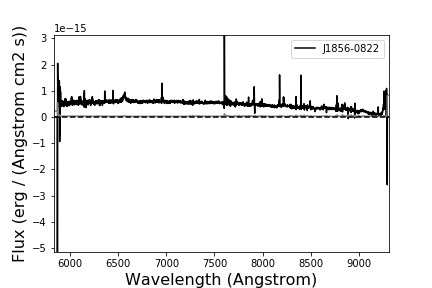

kastRED_J1856-0822D_20190920.fits


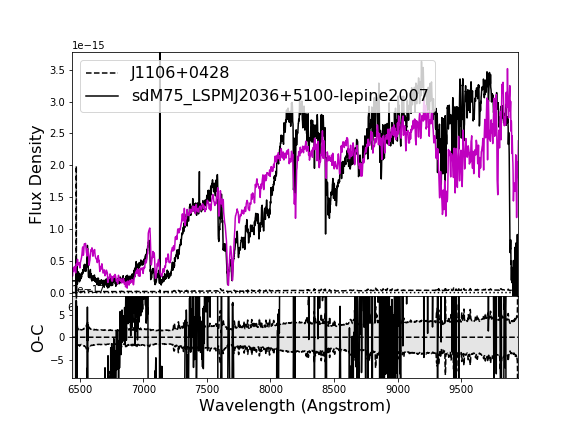

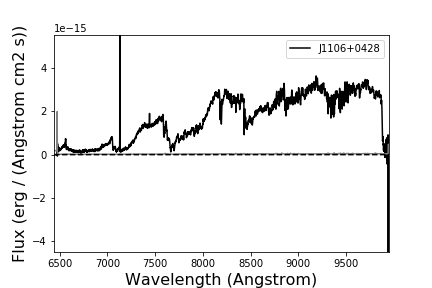

kastRED_J1106+0428_20200203.fits


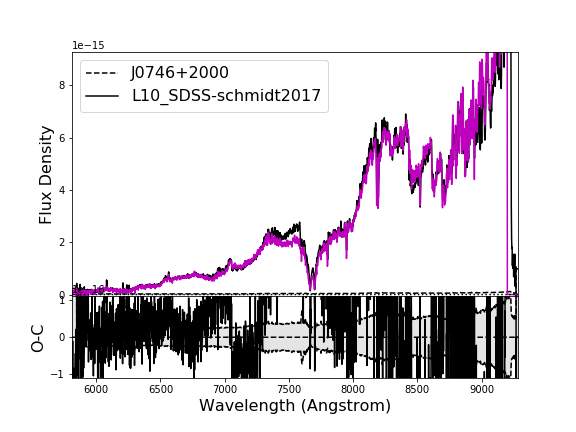

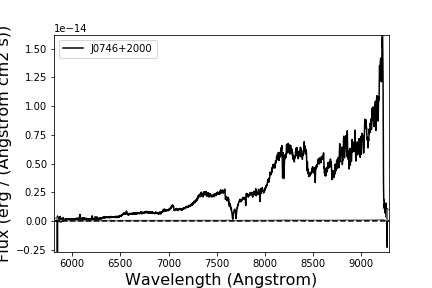

kastRED_J0746+2000_20200311.fits


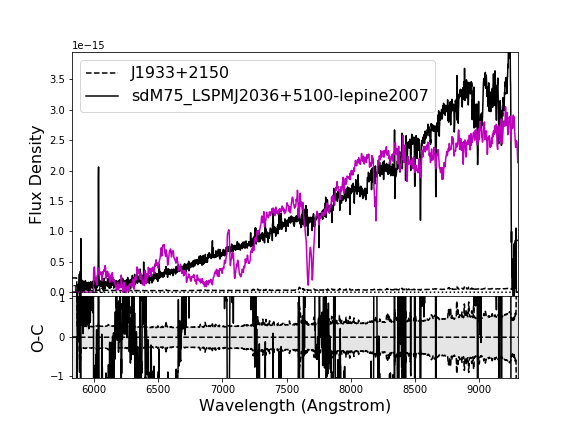

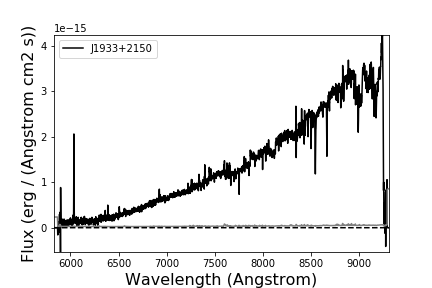

kastRED_J1933+2150B_20190918.fits


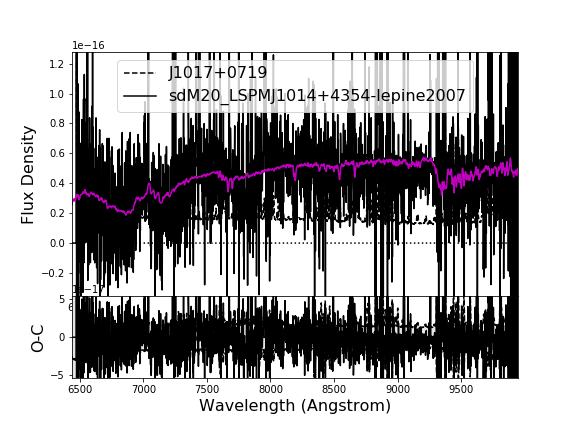

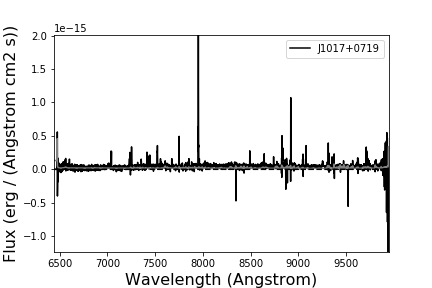

kastRED_J1017+0719B_20200203.fits


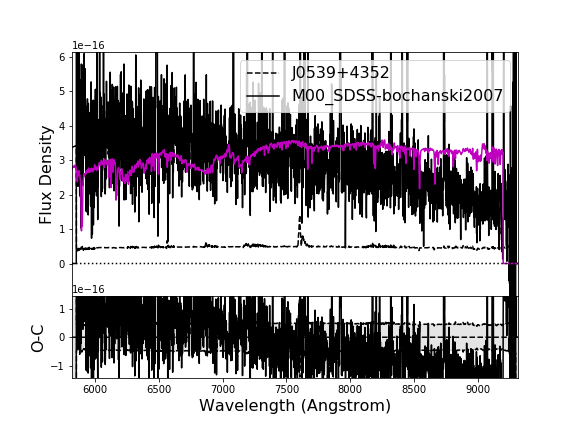

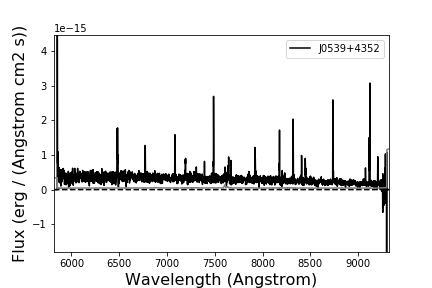

kastRED_J0539+4352_20200110.fits


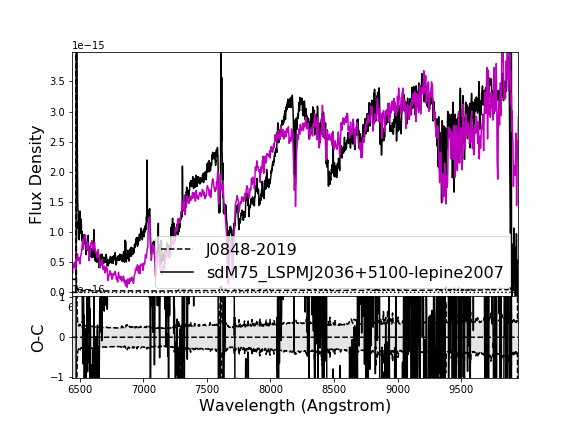

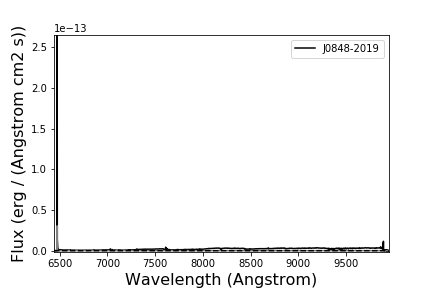

kastRED_J0848-2019_20200203.fits


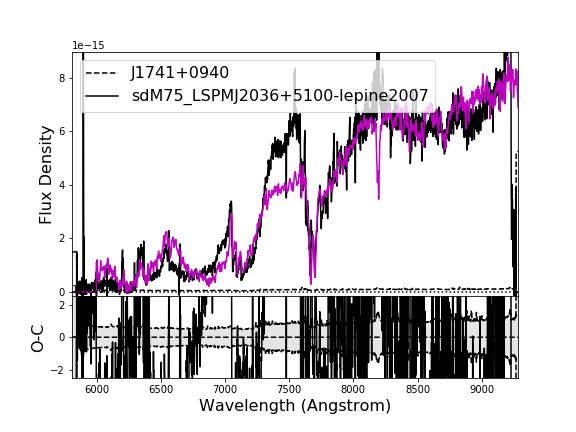

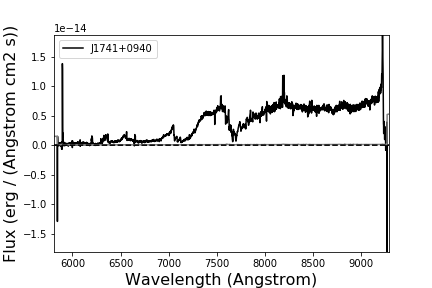

kastRED_J1741+0940_20200305.fits


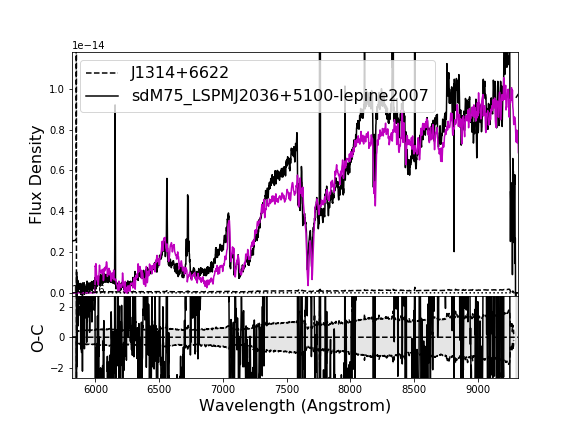

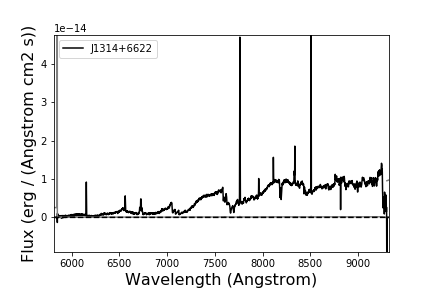

kastRED_J1314+6622_20200205.fits


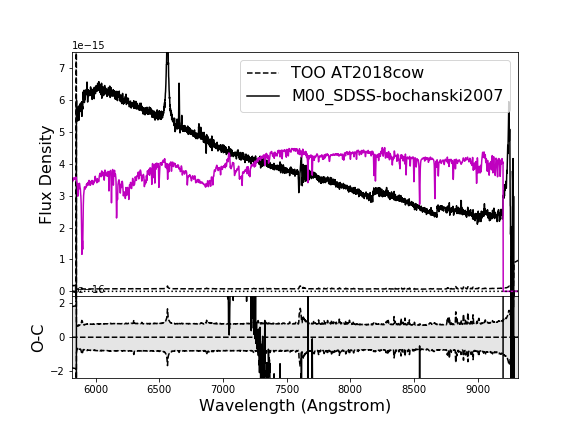

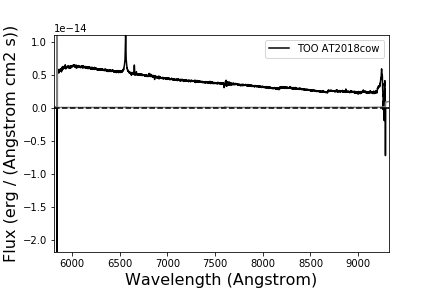

kastRED_AT2018COW_20180622.fits


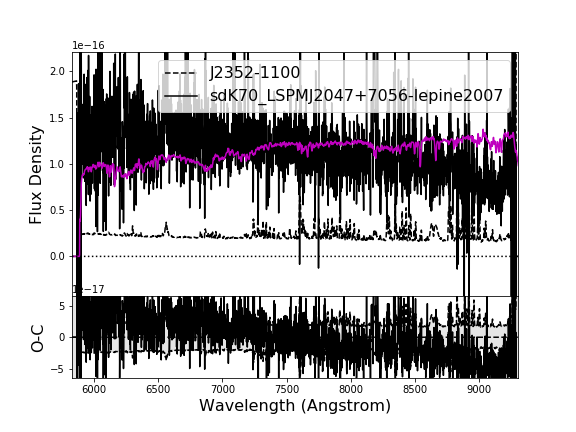

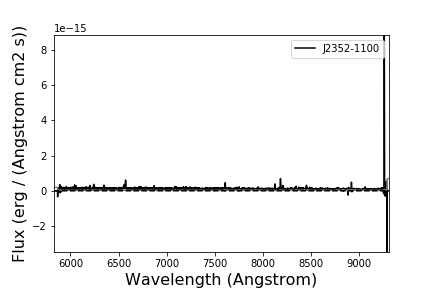

kastRED_J2352-1100B_20190918.fits


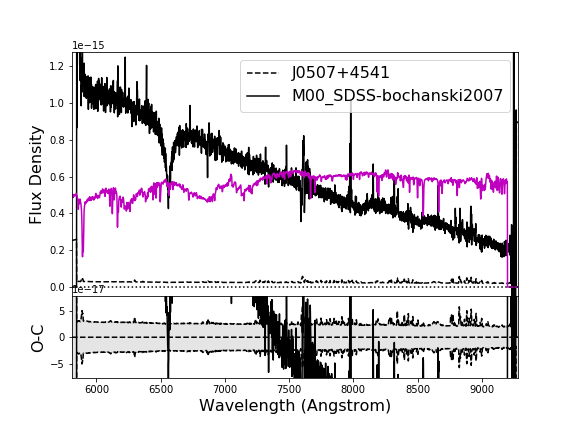

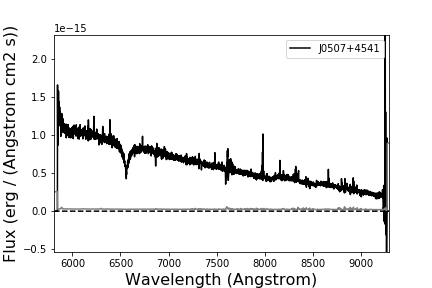

kastRED_J0507+4541_20200303.fits


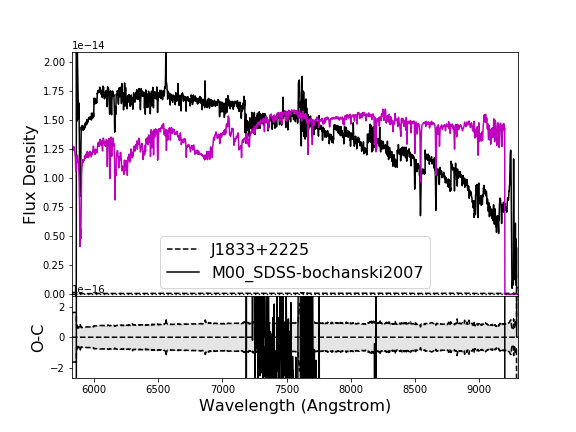

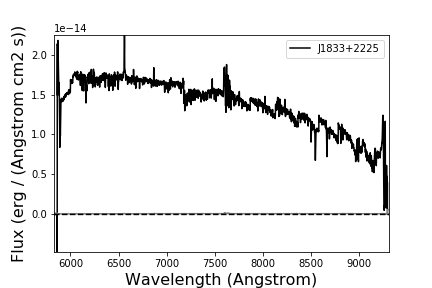

kastRED_J1833+2225E_20190918.fits


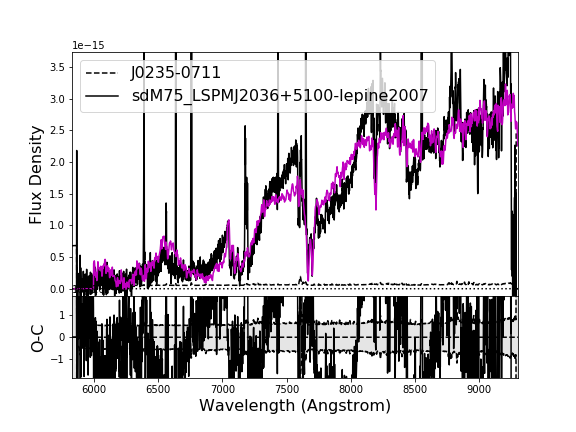

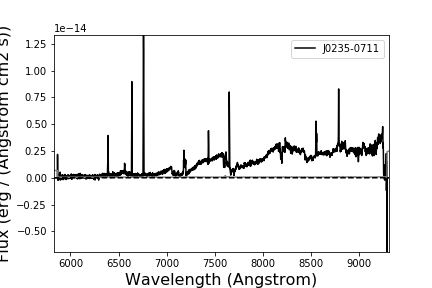

kastRED_J0235-0711_20190918.fits


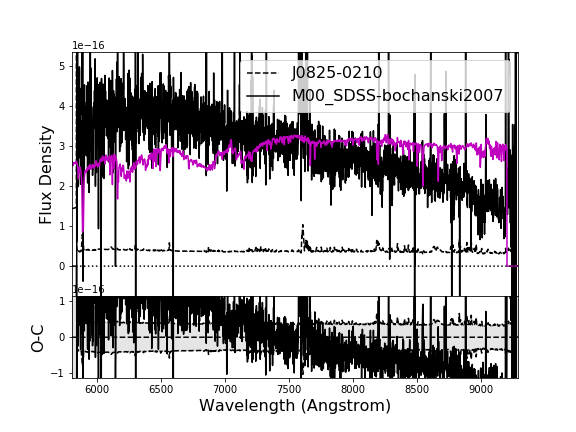

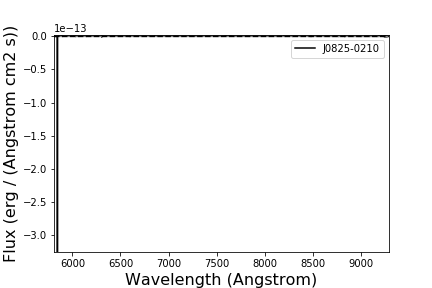

kastRED_J0825-0210_20200204.fits


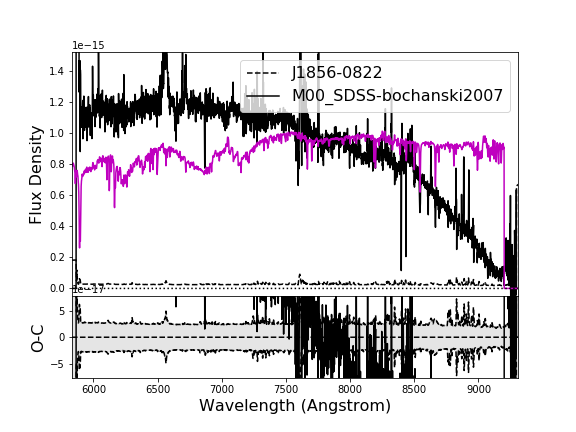

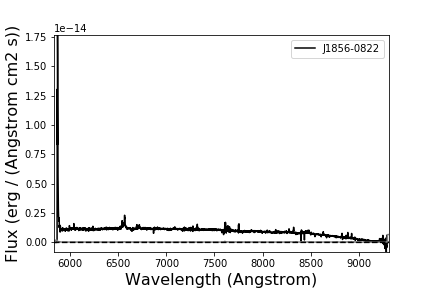

kastRED_J1856-0822E_20190920.fits


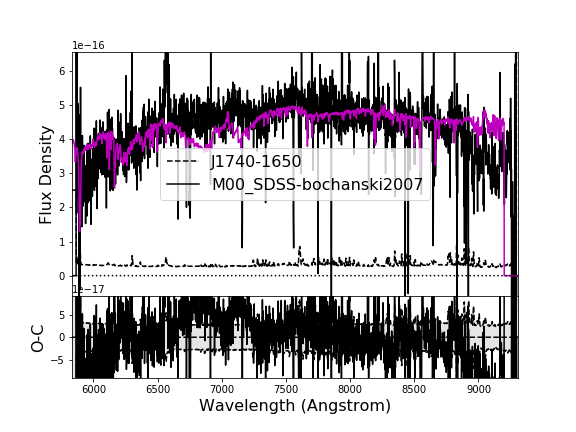

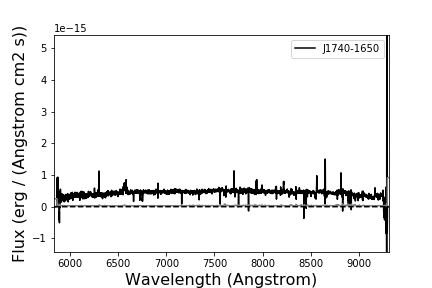

kastRED_J1740-1650D_20190920.fits


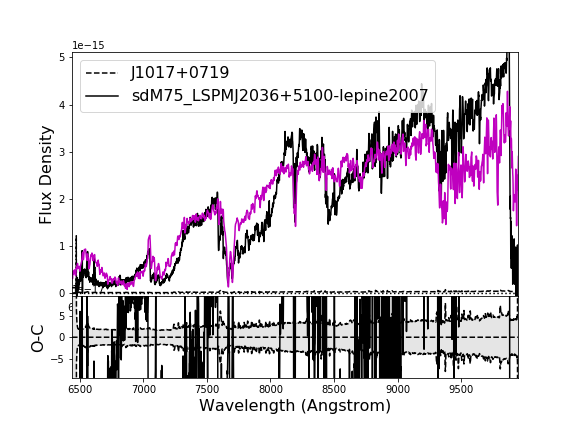

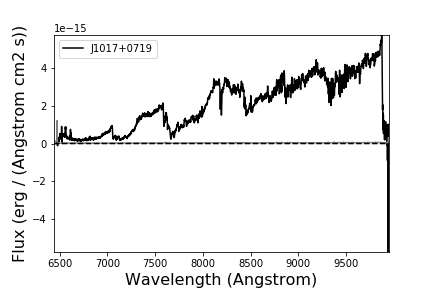

kastRED_J1017+0719_20200203.fits


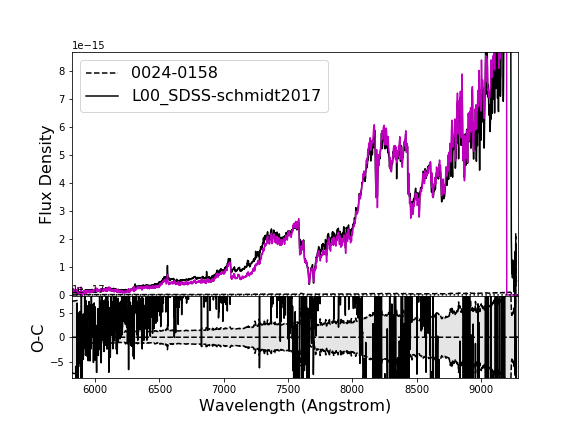

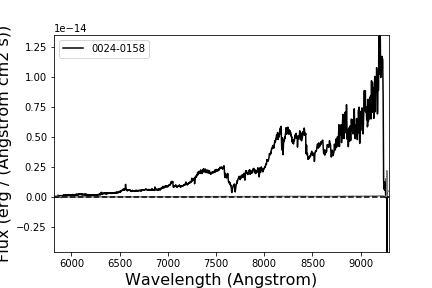

kastRED_J0024-0158_20170823.fits


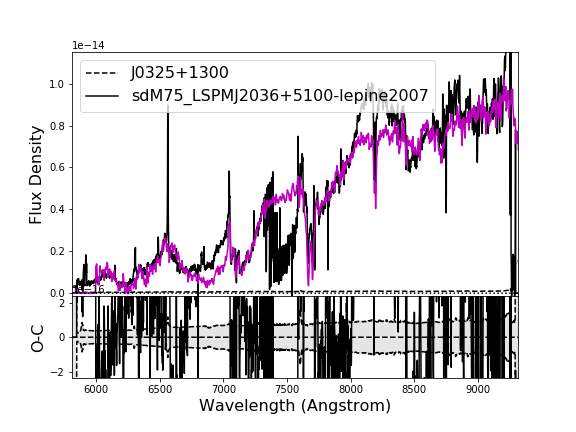

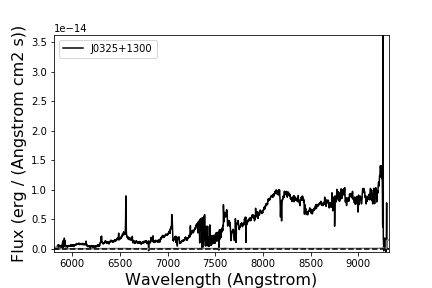

kastRED_J0325+1300_20180308.fits


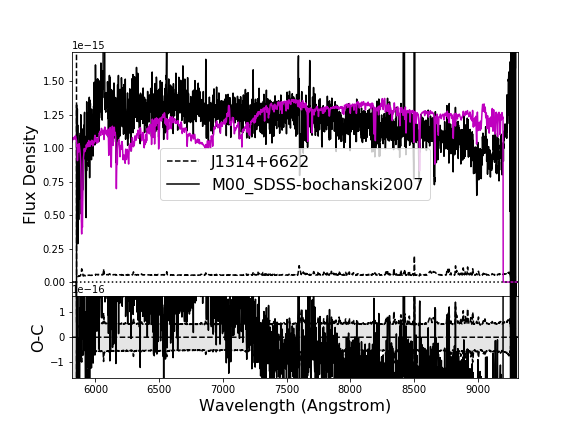

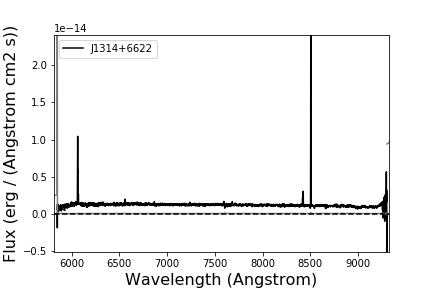

kastRED_J1314+6622C_20200205.fits


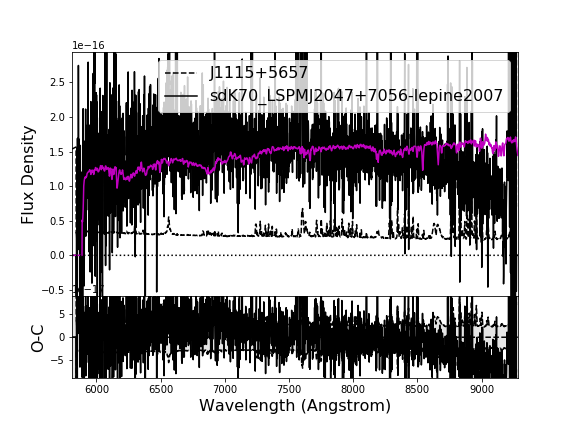

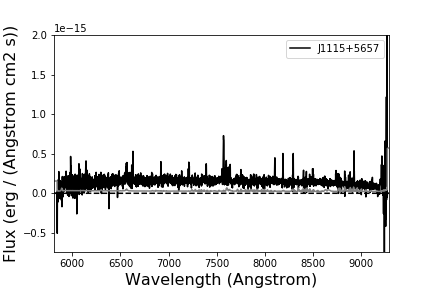

kastRED_J1115+5657B_20200206.fits


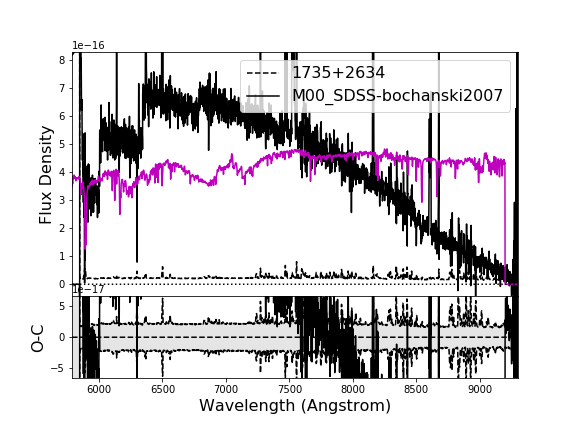

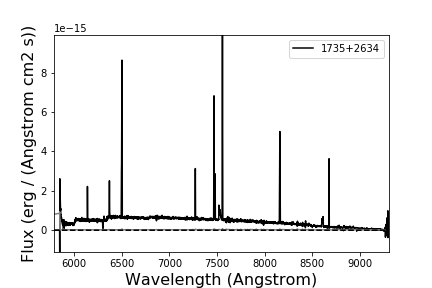

kastRED_J1735+2634B_20170813.fits


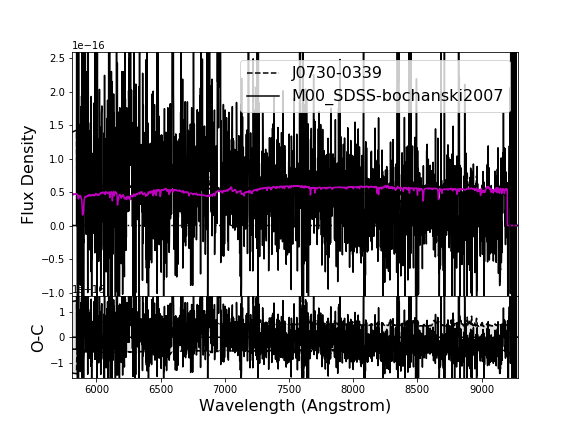

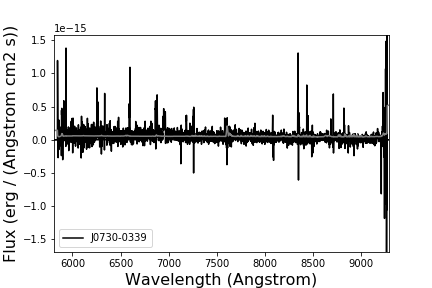

kastRED_J0730-0339B_20200206.fits


In [81]:
from IPython.display import Image, display
import glob

QA_path = '/home/ryan/projects/TestingPNGs/20200624/'


for cor_tuple in non_corr:
    fname = cor_tuple[0][:-5]
    
    fpath1 = QA_path + fname + '/*standardComparison*'

    fpath2 = QA_path + fname + '/*spec*'
    
    file1 = glob.glob(fpath1)[0]
    
    file2 = glob.glob(fpath2)[0]
    
    display(Image(filename=file1), Image(filename=file2))
    
    print(cor_tuple[0])
    

In [14]:
df[df['filename'] == 'kastRED_J0325+1300_20180308.fits']

,name,filename,tags,RA,DEC,OBSDATE,spt,subtype,spt_chi2,spt_scale,...,gizis_CaH2_spt_err,gizis_CaH3_spt,gizis_CaH3_spt_err,lepine_spt,lepine_spt_err,zeta,zeta_err,metallicity_class,L_Halpha/L_bol,L_Halpha/L_bol_err
211,J0325+1300,kastRED_J0325+1300_20180308.fits,"lto, scq, !",3:25:11,13:00:33,2018-03-08T03:05:22.04,sdM7.5,7.5,791258.2577,8.690000e-15,...,0.05803,7.922995,0.067981,5.95351,0.051165,0.940674,0.006804,Dwarf,-1.76E-05,7.89E-08


/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


About to show 2 * 58 images, proceed? (y/n)
y


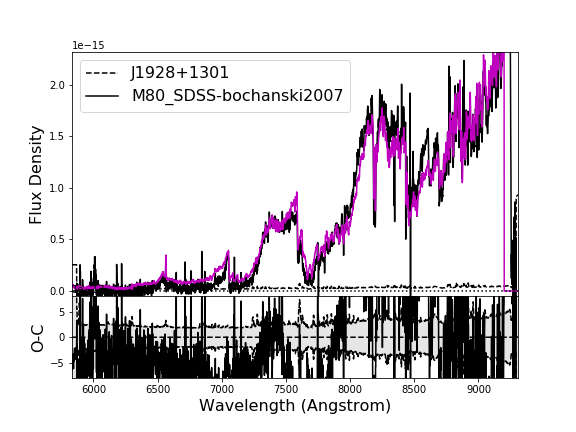

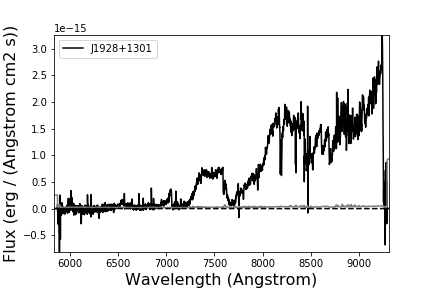

kastRED_J1928+1301_20190920.fits
nan


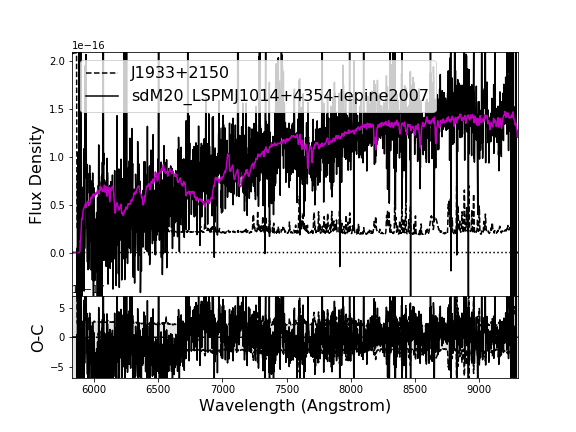

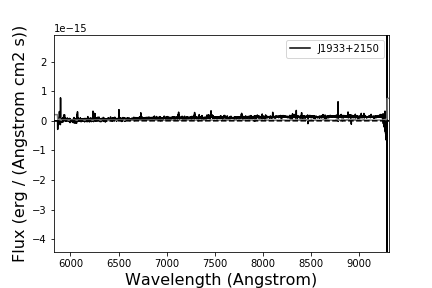

kastRED_J1933+2150C_20190918.fits
S/N


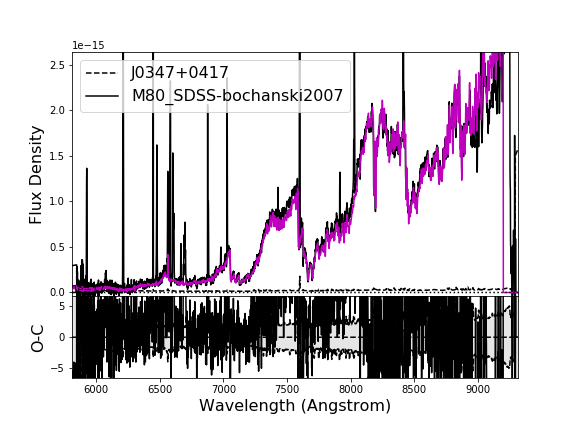

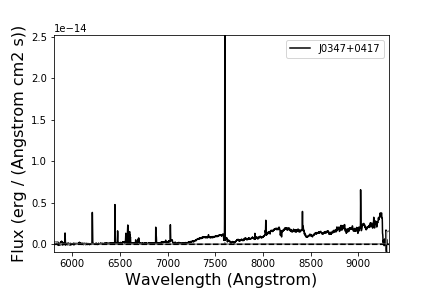

kastRED_J0347+0417_20180308.fits
nan


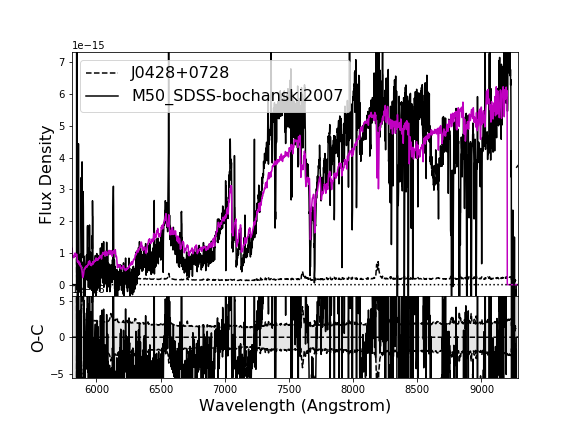

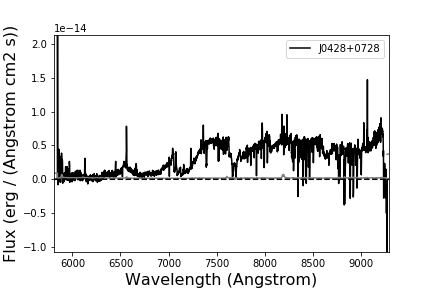

kastRED_J0428+0728_20180307.fits
nan


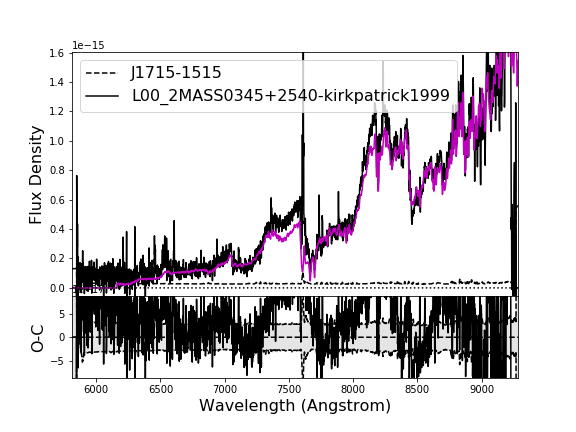

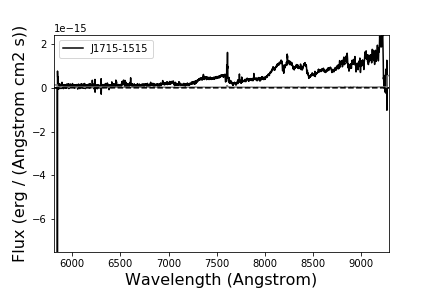

kastRED_J1715-1515_20200311.fits
lto


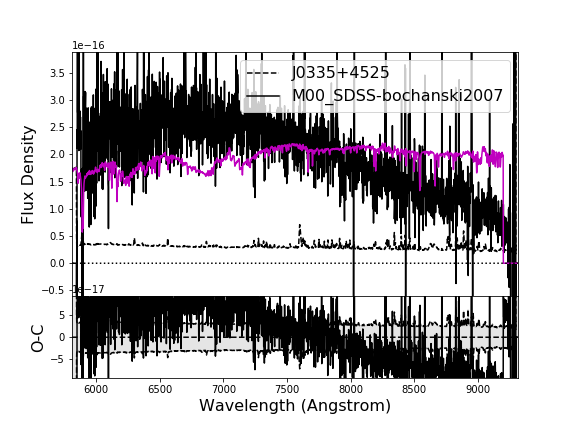

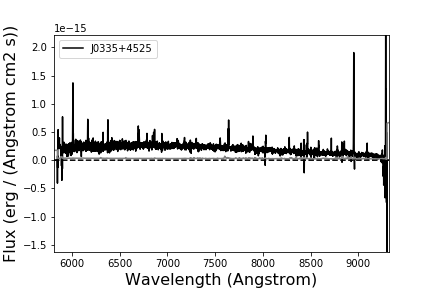

kastRED_J0355+4525D_20200205.fits
nan


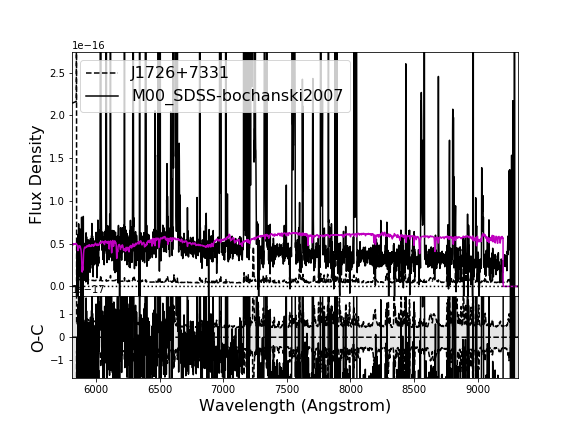

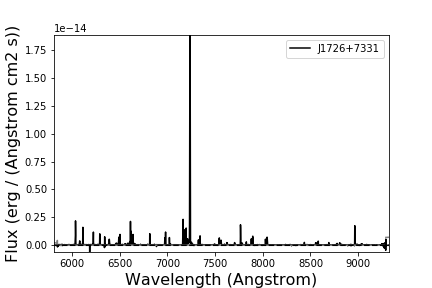

kastRED_J1726+7331B_20180716.fits
S/N


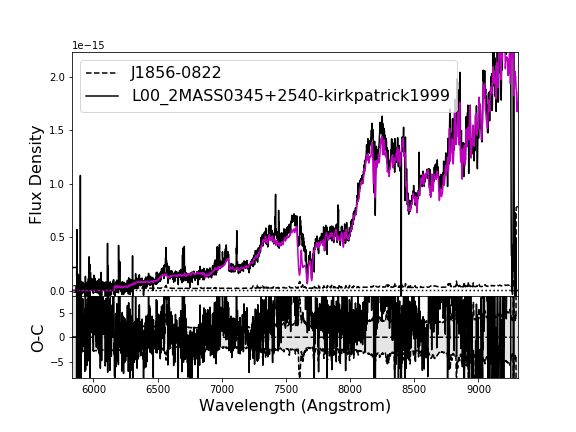

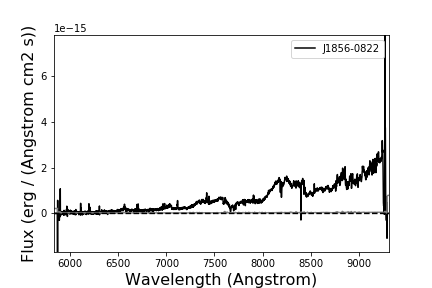

kastRED_J1856-0822_20190920.fits
lto


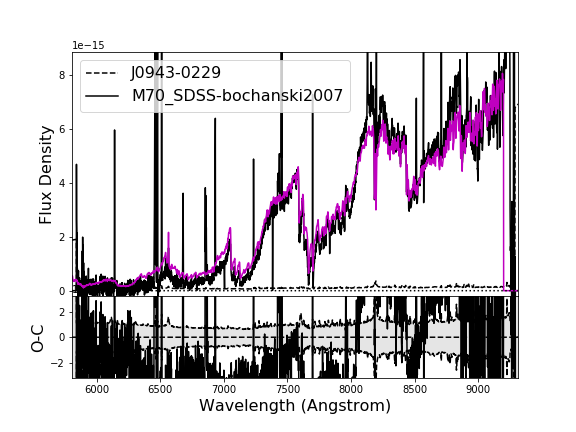

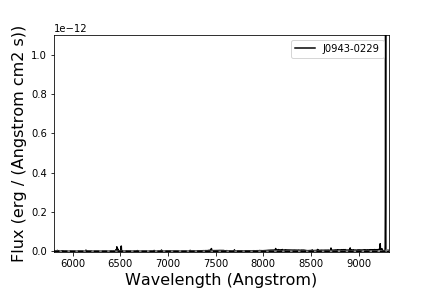

kastRED_J0943-0229_20190331.fits
nan


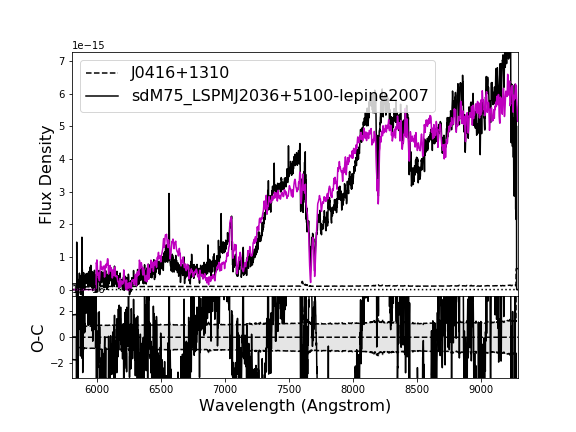

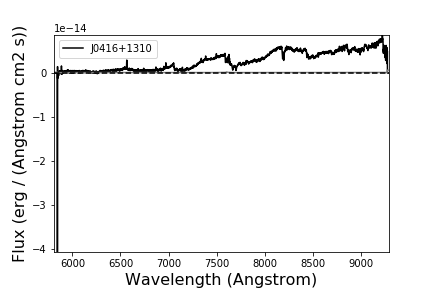

kastRED_J0416+1310_20200204.fits
lto, scq


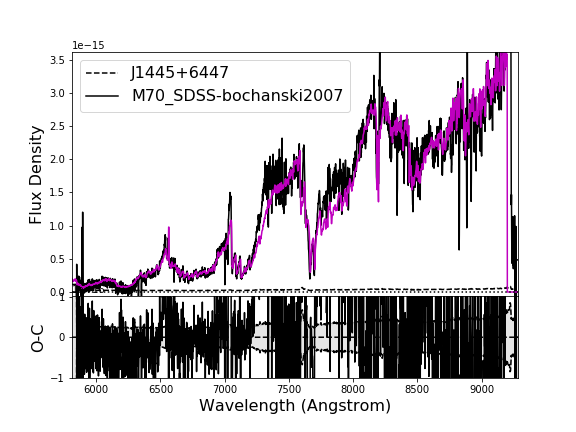

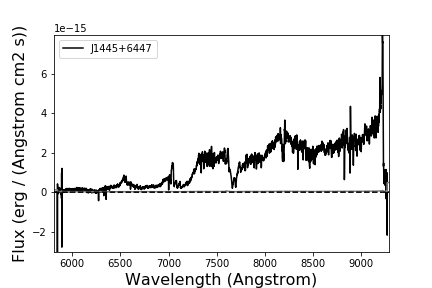

kastRED_J1445+6447_20200311.fits
nan


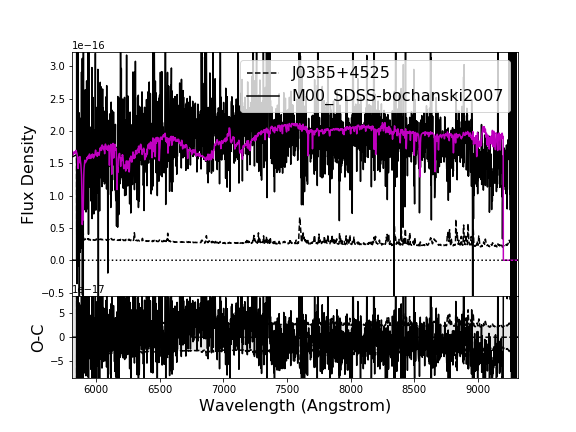

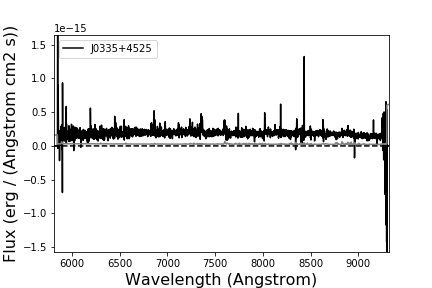

kastRED_J0355+4525E_20200205.fits
S/N


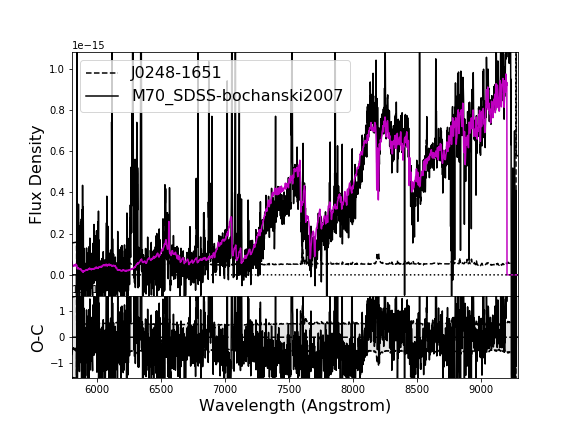

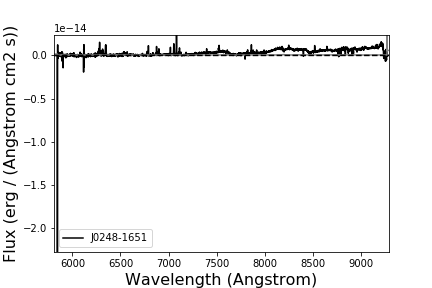

kastRED_J0248-1651_20200204.fits
lto, S/N


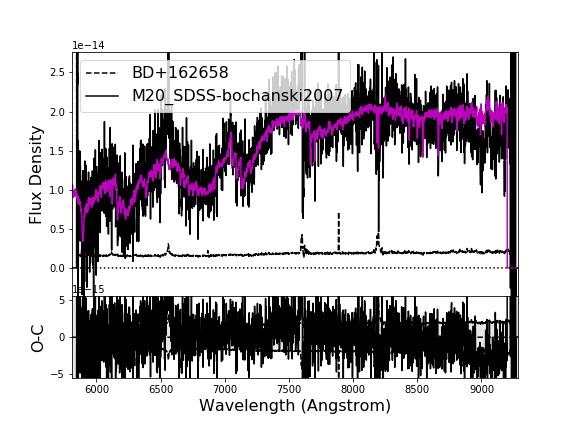

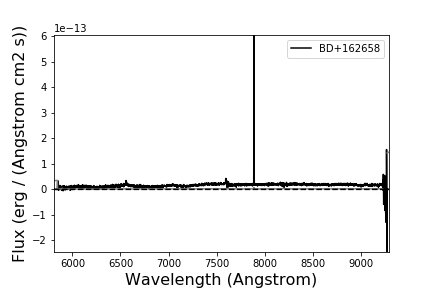

kastRED_BD162658_20180307.fits
S/N


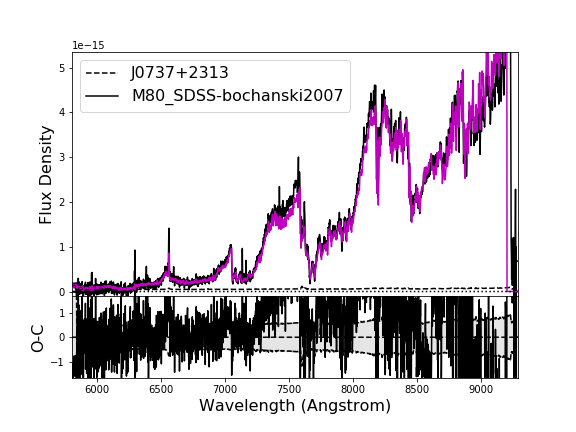

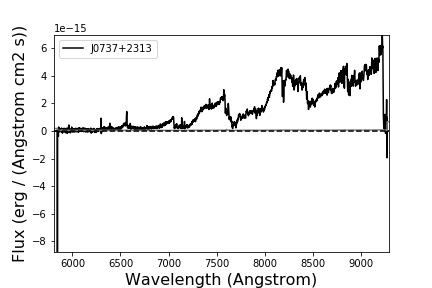

kastRED_J0737+2313_20200204.fits
nan


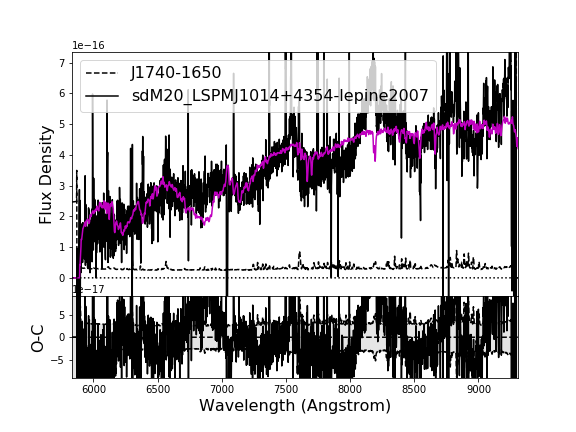

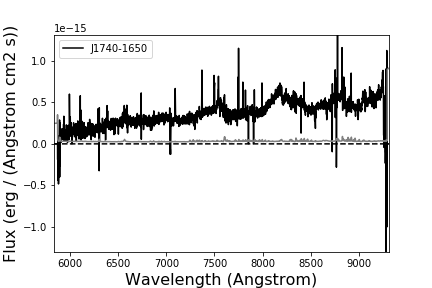

kastRED_J1740-1650B_20190920.fits
S/N


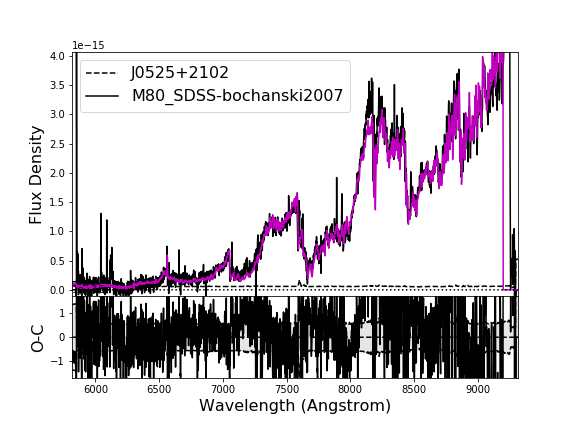

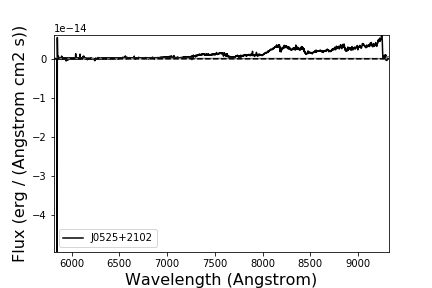

kastRED_J0525+2102_20200205.fits
nan


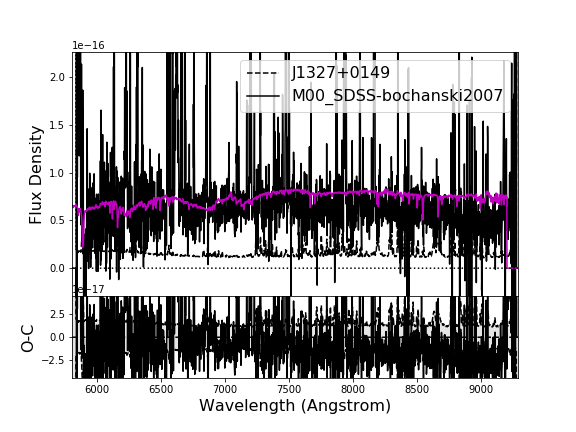

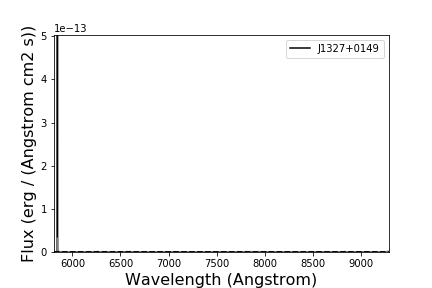

kastRED_J1327+0149B_20200204.fits
S/N


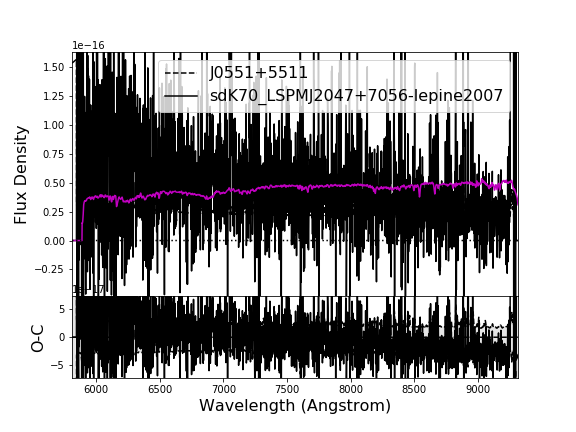

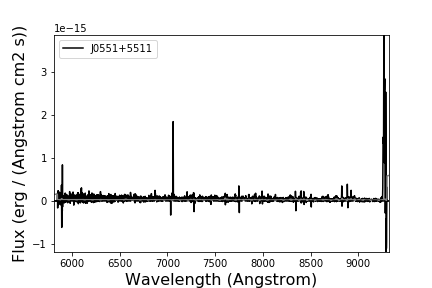

kastRED_J0551+5511D_20200205.fits
S/N


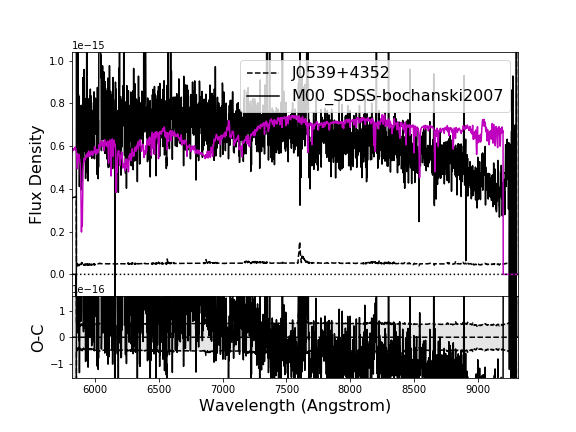

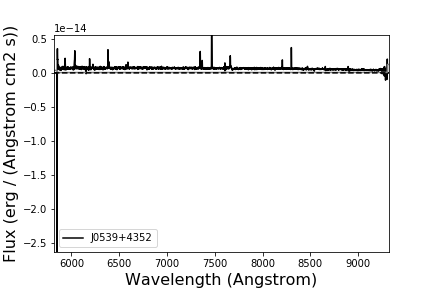

kastRED_J0539+4352B_20200110.fits
S/N


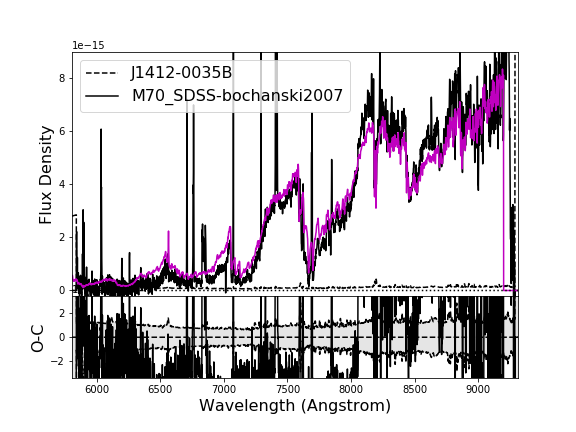

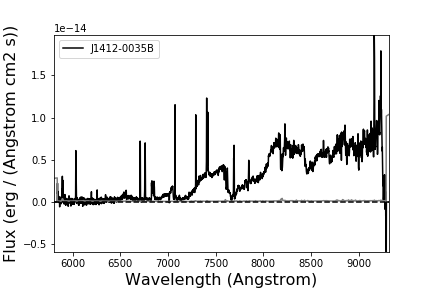

kastRED_J1412-0035B_20190331.fits
nan


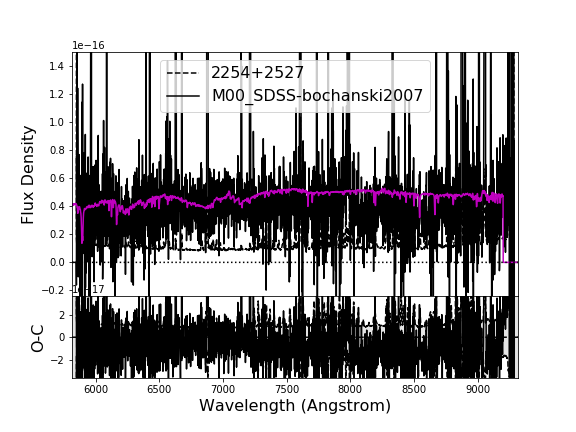

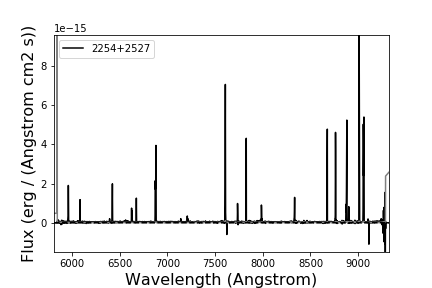

kastRED_J2254+2527B_20180622.fits
S/N


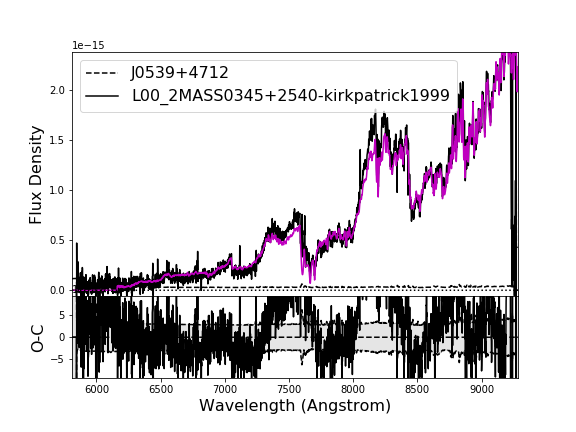

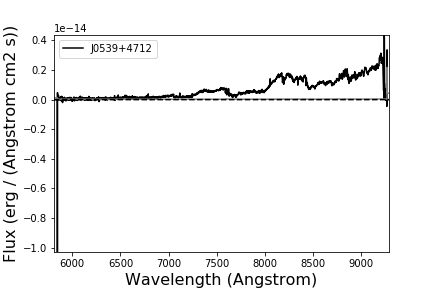

kastRED_J0539+4712_20200206.fits
lto


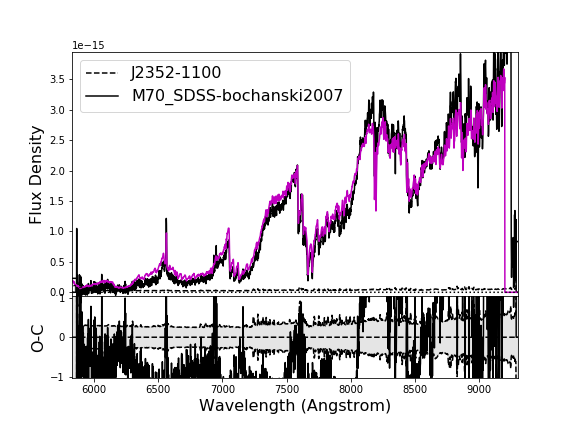

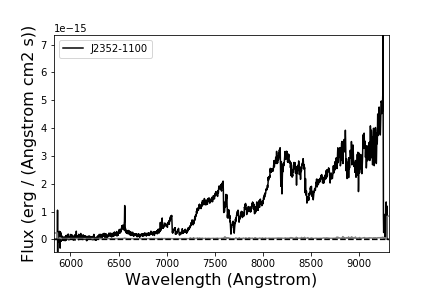

kastRED_J2352-1100_20190918.fits
nan


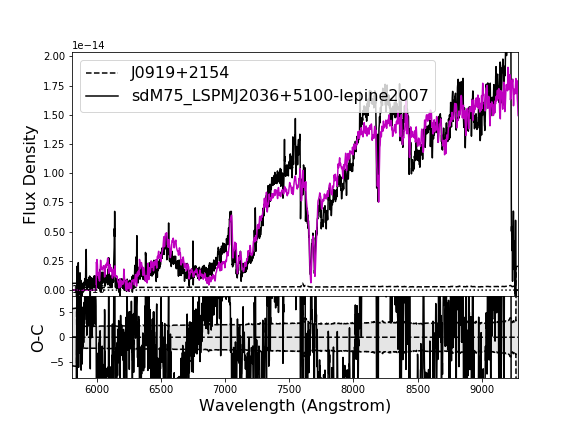

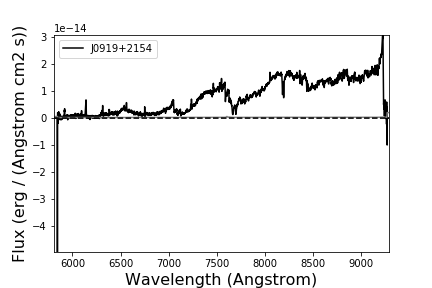

kastRED_J0919+2154_20200305.fits
lto, scq


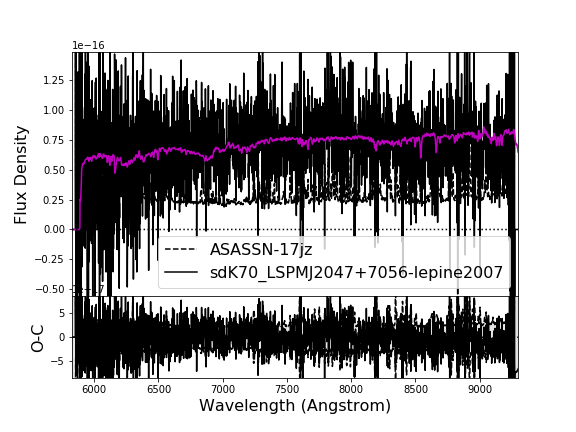

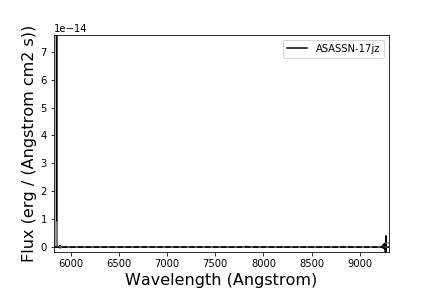

kastRED_ASASSN-17JZ-B_20170817.fits
S/N


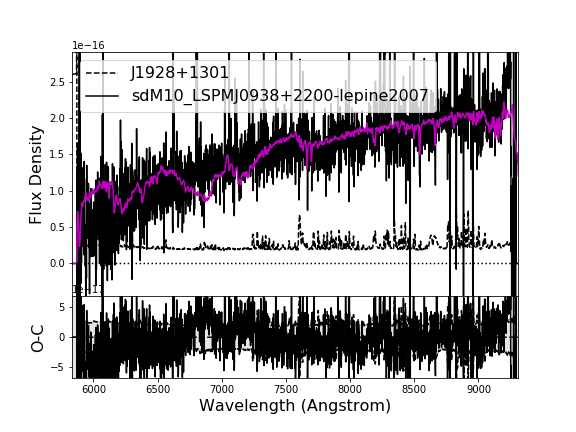

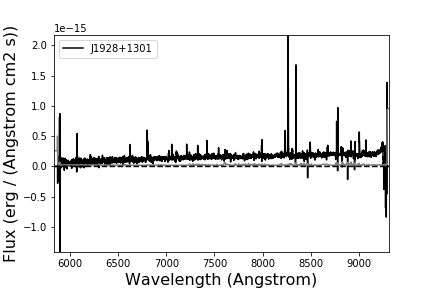

kastRED_J1928+1301B_20190920.fits
S/N


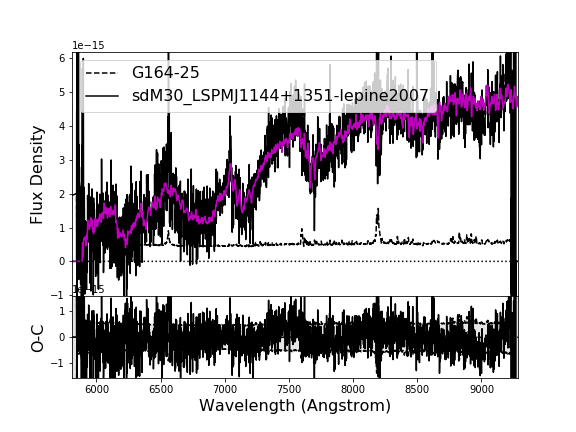

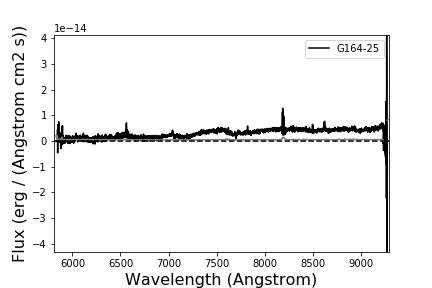

kastRED_G164-25_20180307.fits
lto, S/N


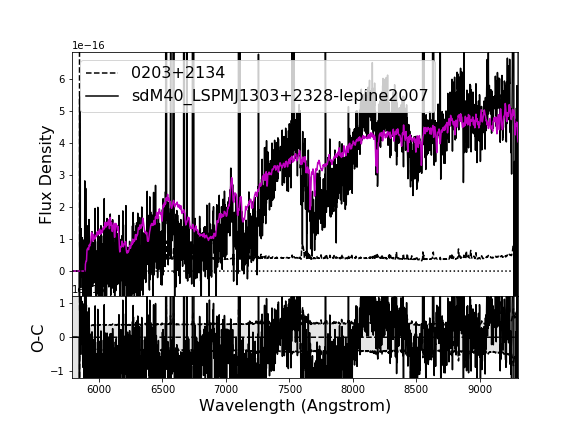

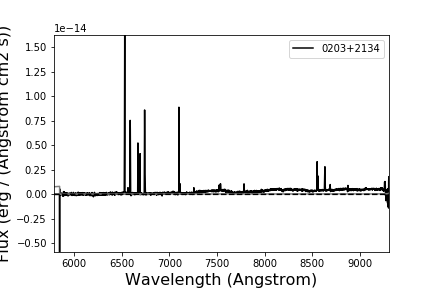

kastRED_J0203+2134_20170813.fits
lto, S/N


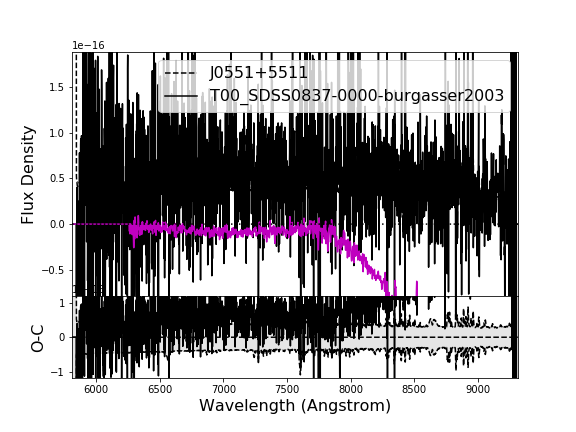

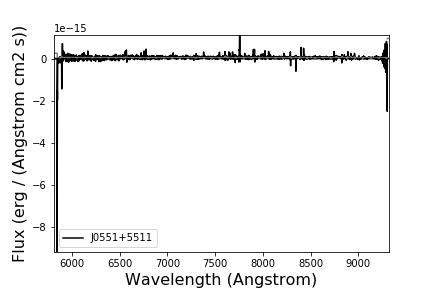

kastRED_J0551+5511C_20200205.fits
S/N


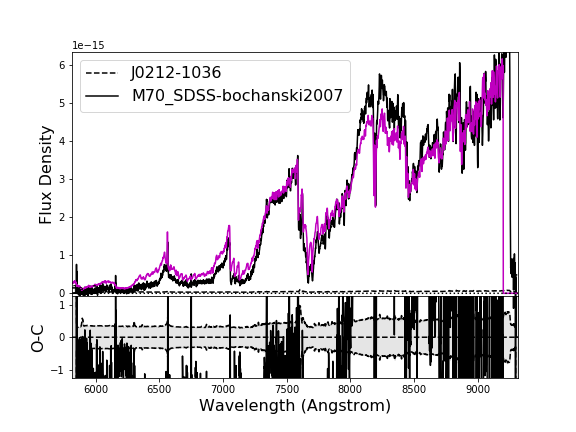

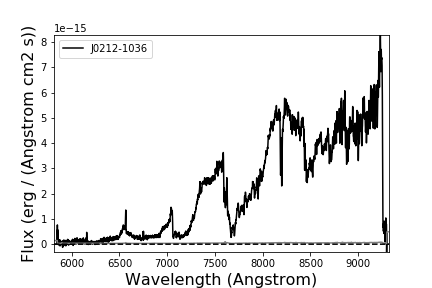

kastRED_J0212-1036_20200110.fits
nan


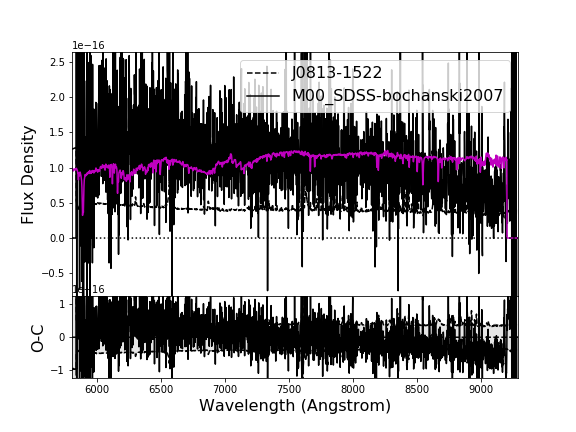

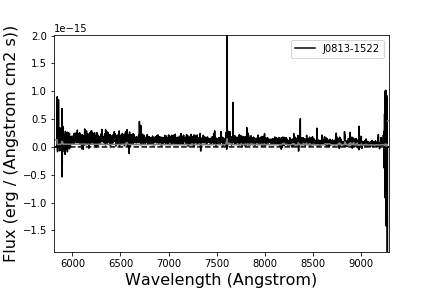

kastRED_J0813-1522C_20200204.fits
S/N


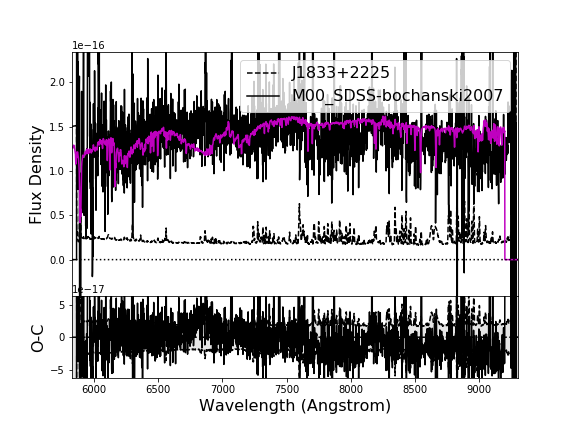

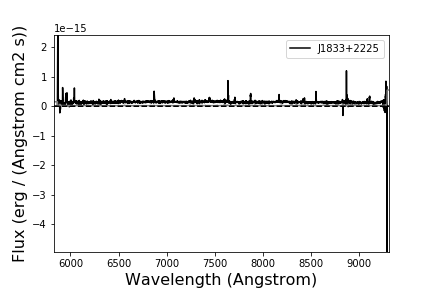

kastRED_J1833+2225B_20190918.fits
S/N


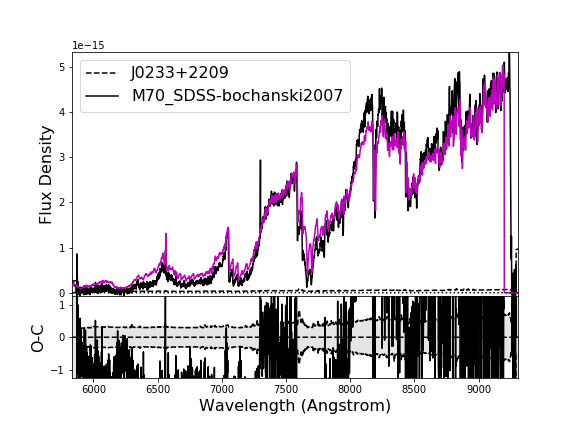

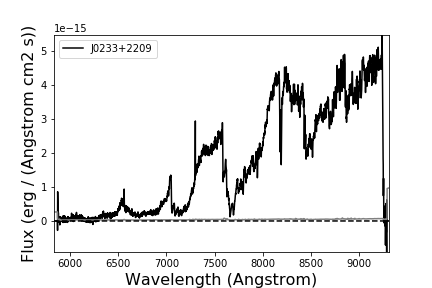

kastRED_J0233+2209_20190920.fits
nan


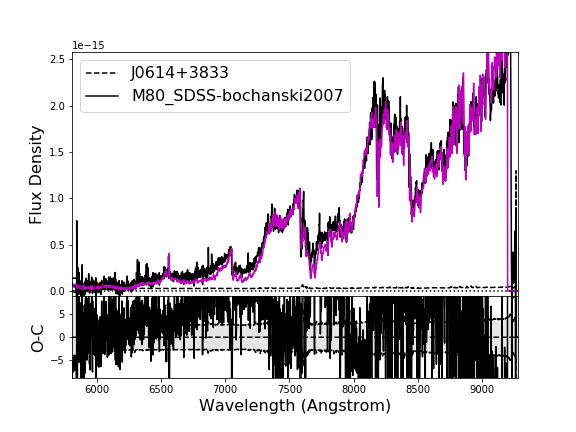

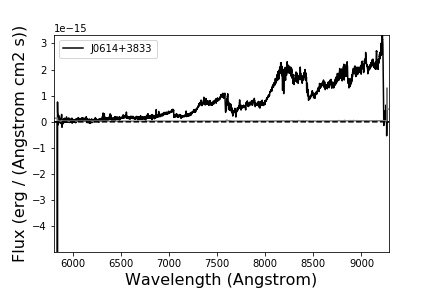

kastRED_J0614+3833_20200304.fits
nan


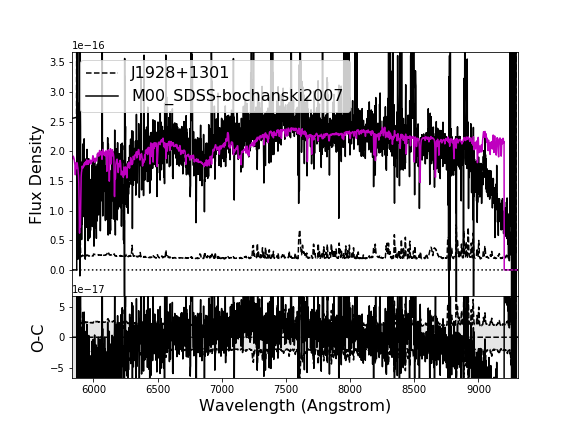

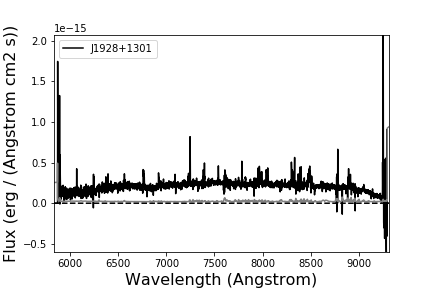

kastRED_J1928+1301C_20190920.fits
nan


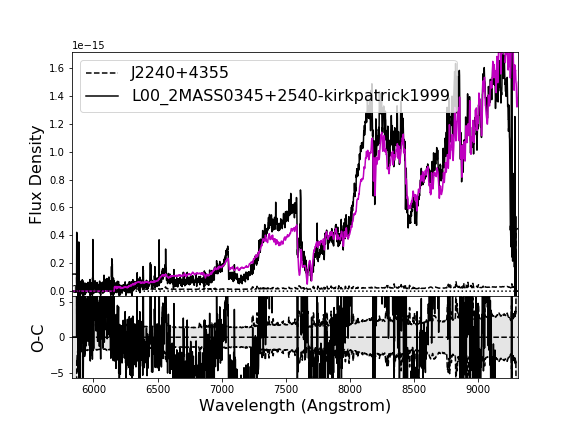

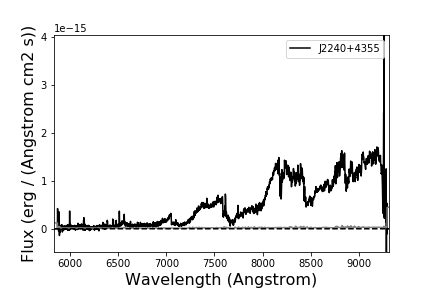

kastRED_J2240+4355_20190920.fits
lto


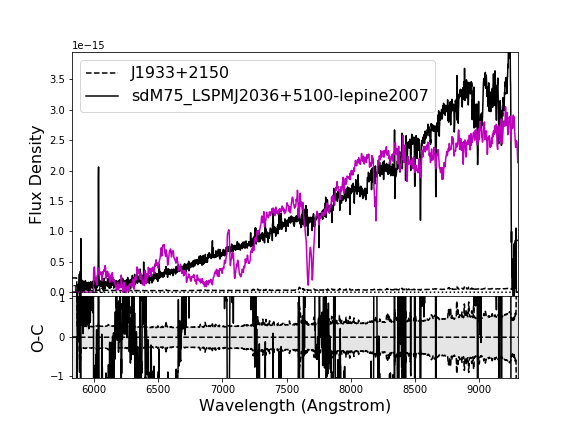

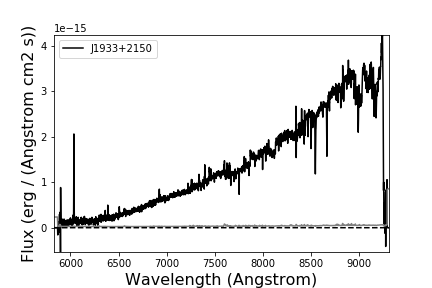

kastRED_J1933+2150B_20190918.fits
OO


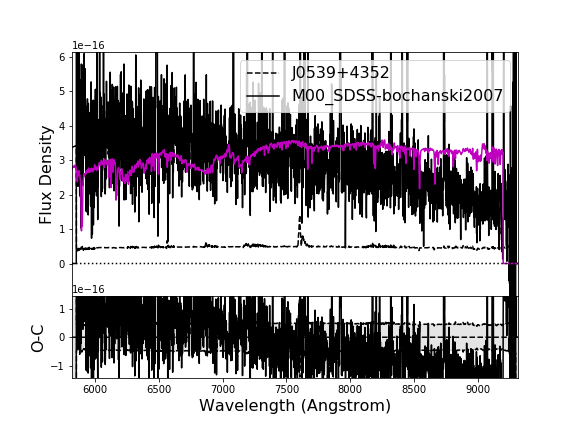

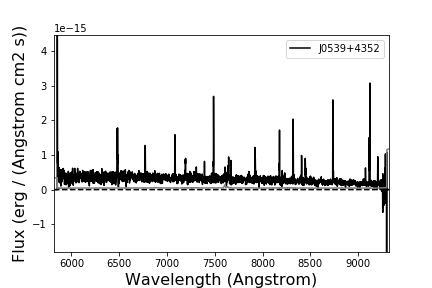

kastRED_J0539+4352_20200110.fits
S/N


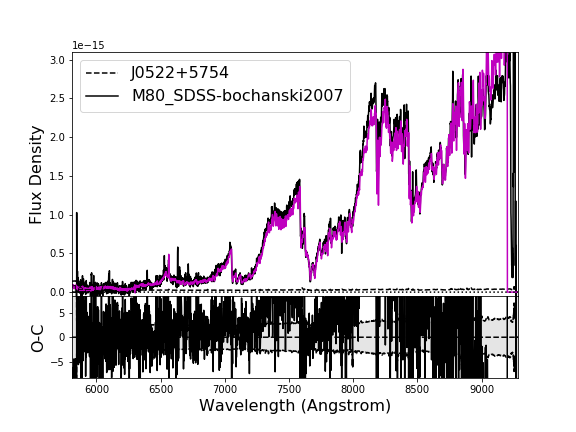

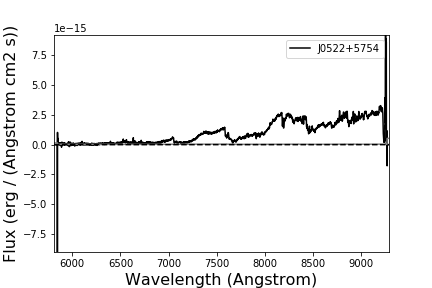

kastRED_J0522+5724_20200206.fits
nan


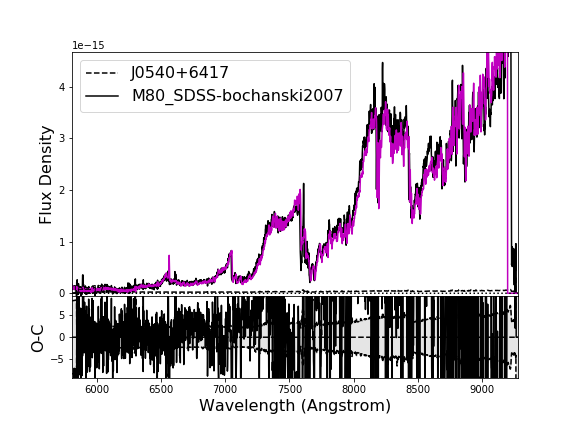

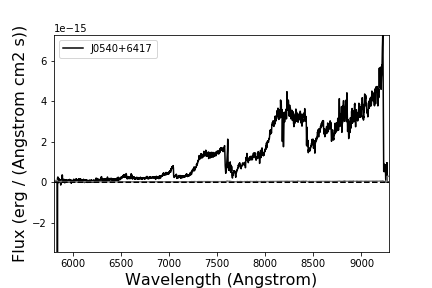

kastRED_J0540+6417_20200304.fits
nan


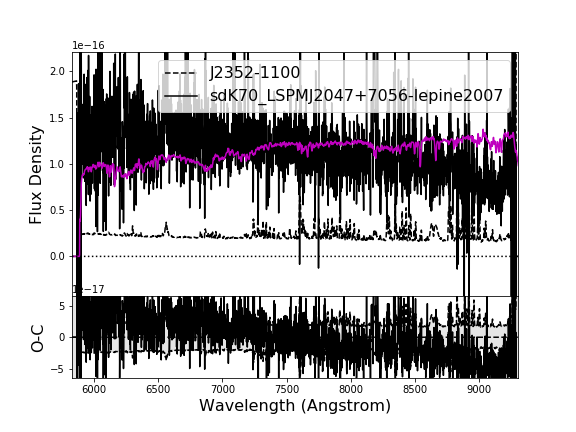

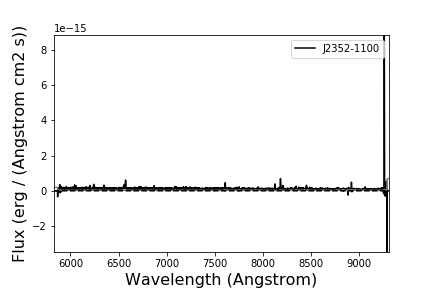

kastRED_J2352-1100B_20190918.fits
S/N


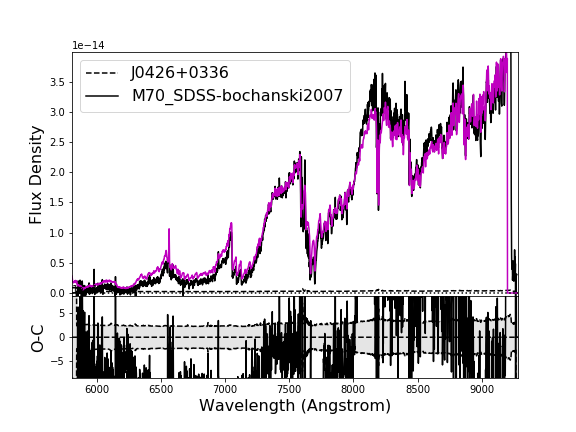

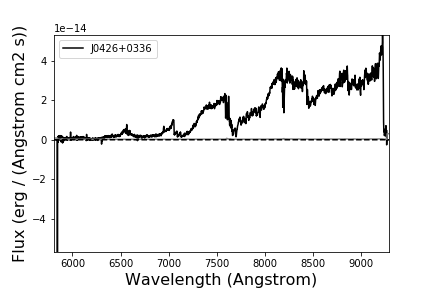

kastRED_J0426+0336_20200305.fits
nan


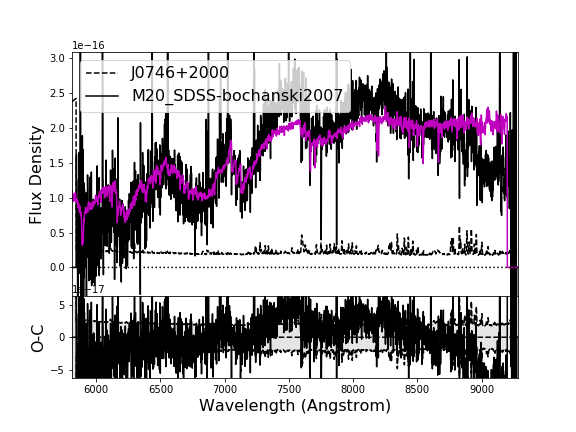

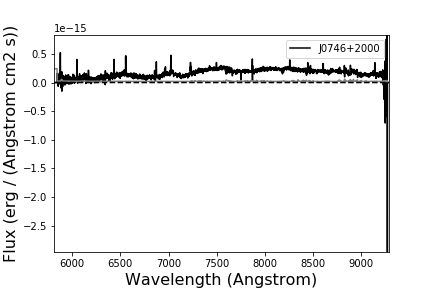

kastRED_J0746+2000B_20200311.fits
nan


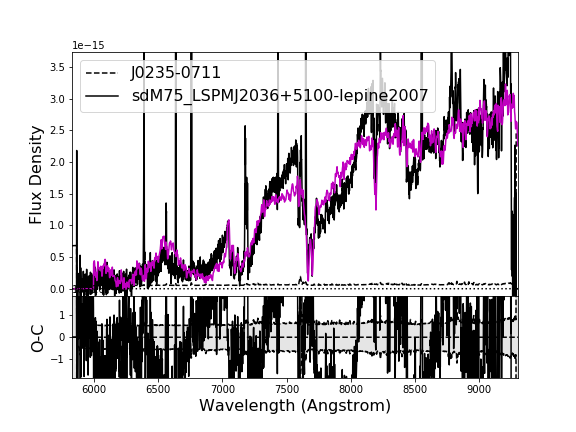

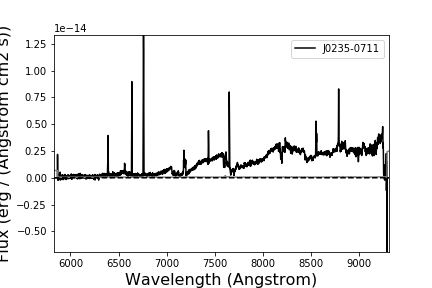

kastRED_J0235-0711_20190918.fits
lto, S/N


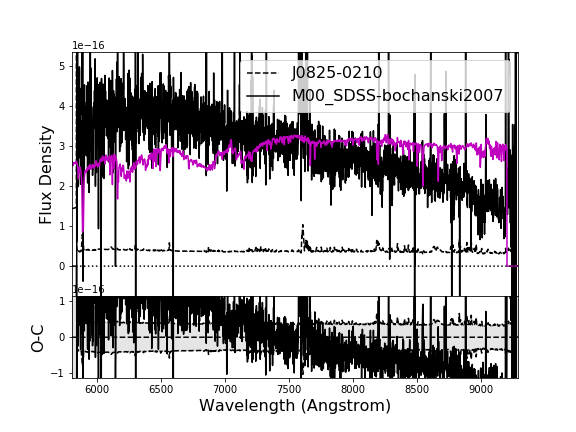

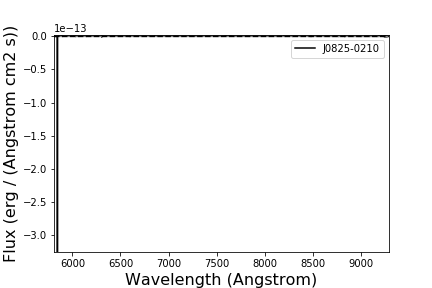

kastRED_J0825-0210_20200204.fits
S/N


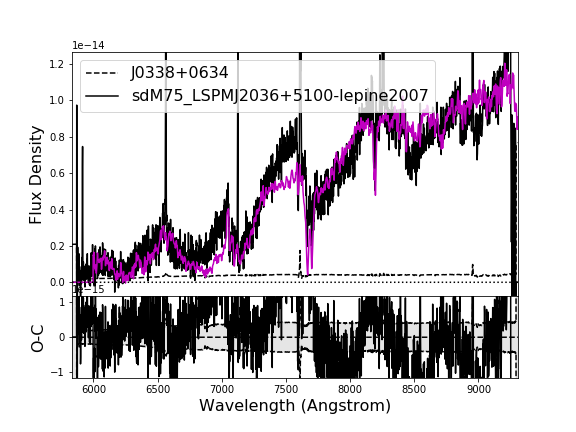

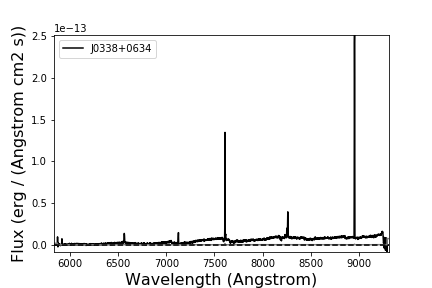

kastRED_J0338+0634_20190920.fits
nan


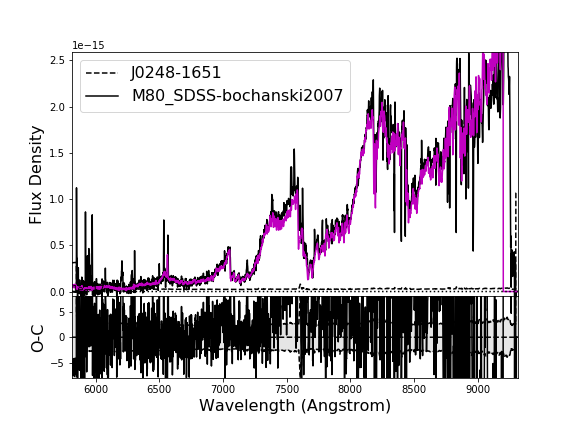

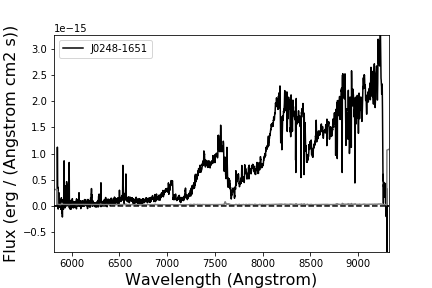

kastRED_J0248-1651_20200110.fits
nan


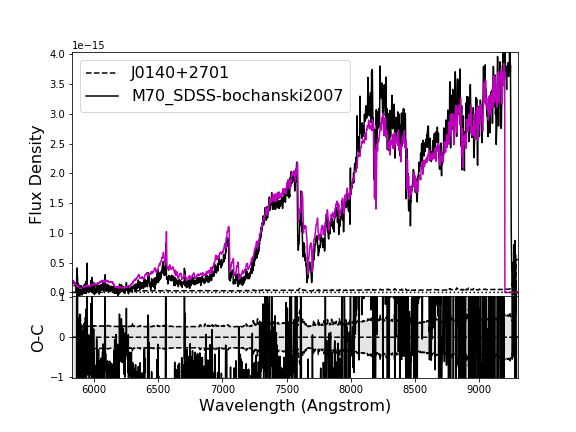

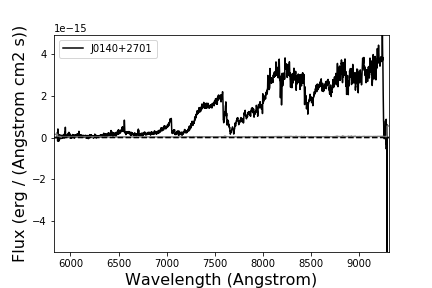

kastRED_J0140+2701_20190918.fits
nan


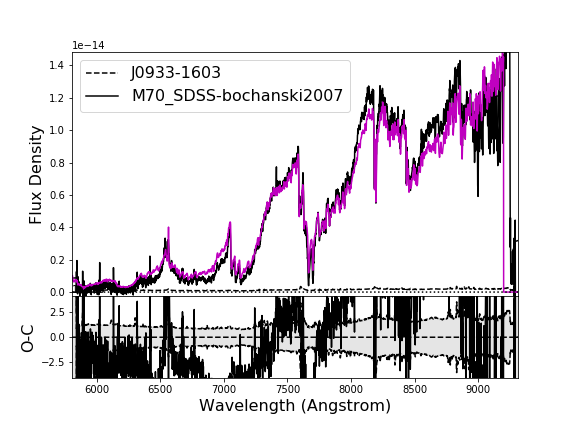

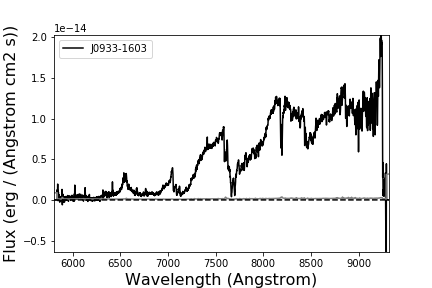

kastRED_J0933-1603_20190331.fits
nan


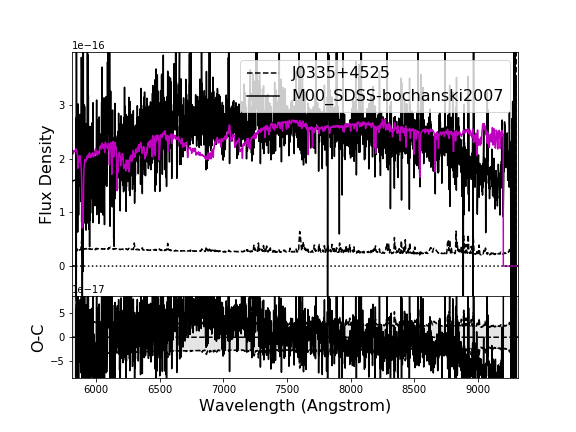

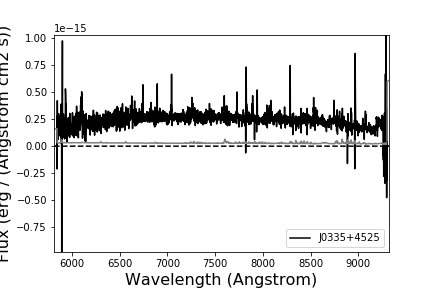

kastRED_J0355+4525C_20200205.fits
nan


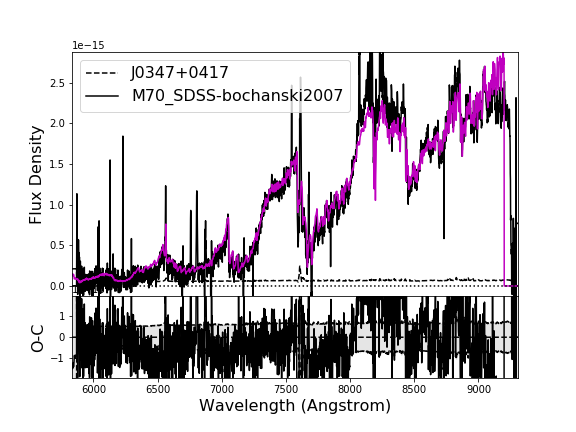

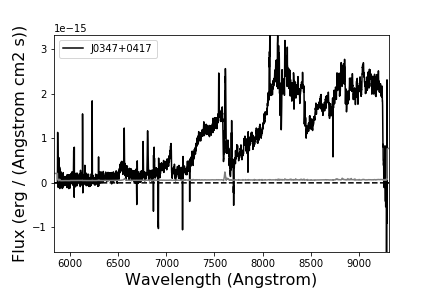

kastRED_J0347+0417_20190920.fits
nan


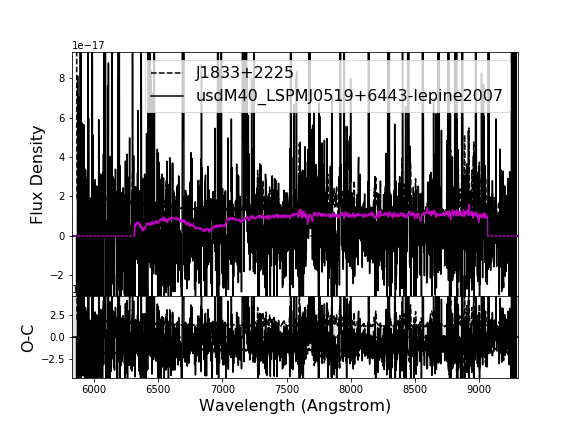

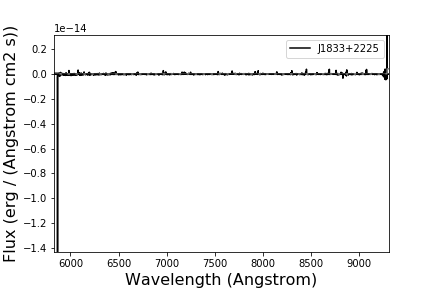

kastRED_J1833+2225C_20190918.fits
nan


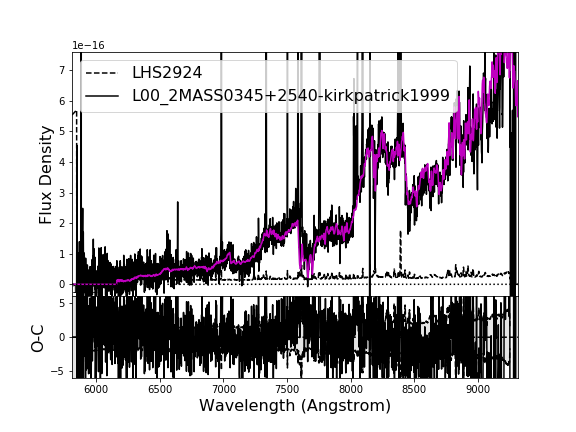

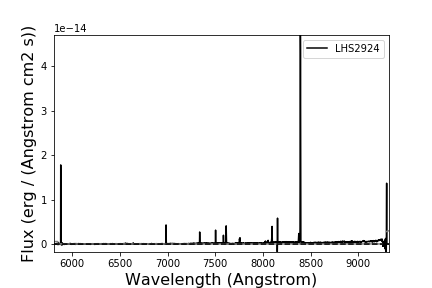

kastRED_LHS2924_20180308.fits
lto, S/N


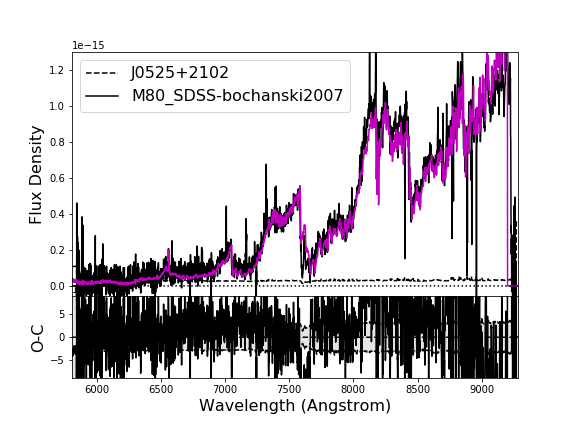

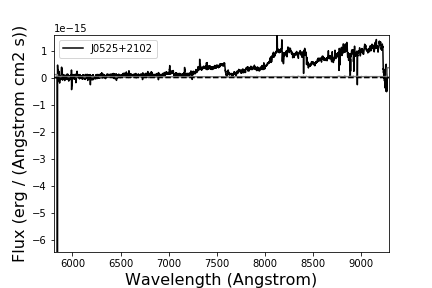

kastRED_J0525+2102_20200111.fits
nan


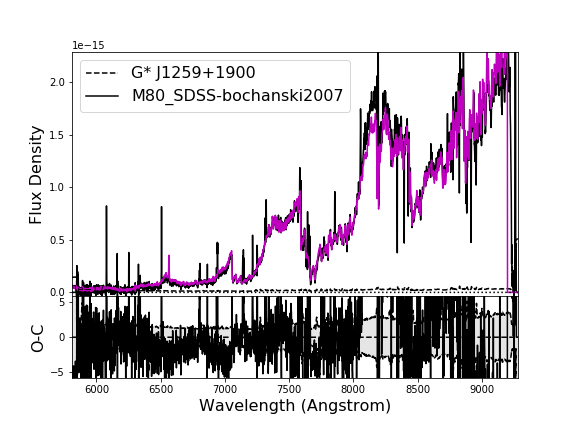

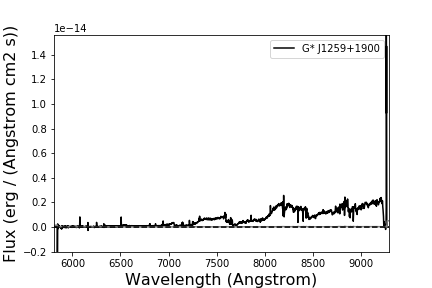

kastRED_J1259+1900_20200303.fits
nan


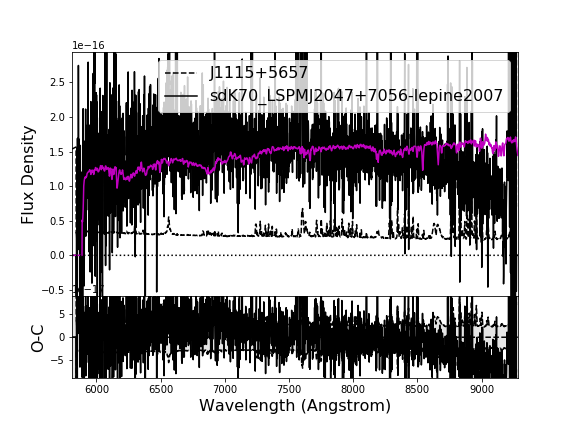

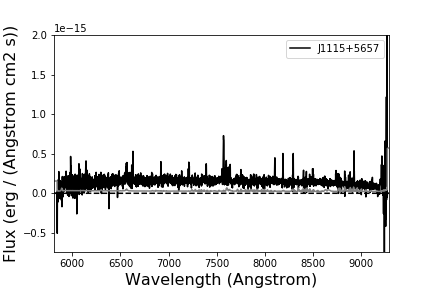

kastRED_J1115+5657B_20200206.fits
S/N


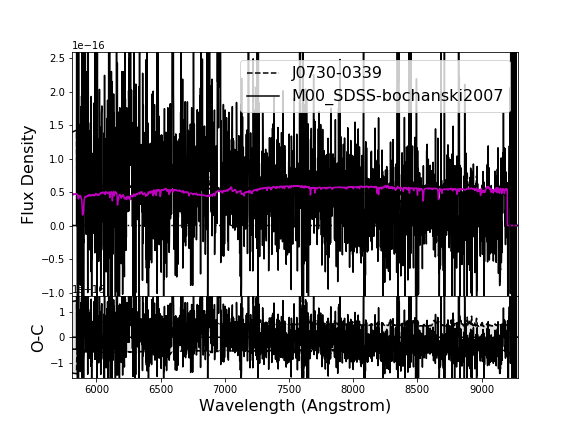

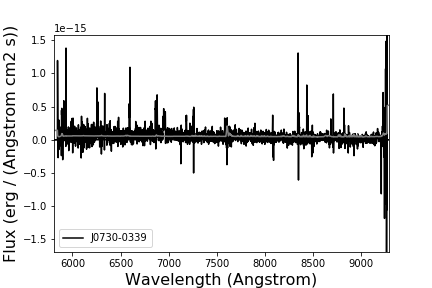

kastRED_J0730-0339B_20200206.fits
S/N


In [24]:
df1 = dfa[ CaH1_mod_err > 3 * med_CaH1_err]

display_images(df1, '/home/ryan/projects/TestingPNGs/20200624/')

In [16]:
arr = find_in_tag_arr(dfa, '!')
arr1 = ~find_in_tag_arr(dfa, 'NO')

dfa[arr & arr1]

,name,filename,tags,RA,DEC,OBSDATE,spt,subtype,spt_chi2,spt_scale,...,gizis_CaH2_spt_err,gizis_CaH3_spt,gizis_CaH3_spt_err,lepine_spt,lepine_spt_err,zeta,zeta_err,metallicity_class,L_Halpha/L_bol,L_Halpha/L_bol_err
28,1735+2634,kastRED_J1735+2634_20170813.fits,!,17:35:13,26:34:46,2017-08-13T05:02:20.76,M8.0,8.0,1.446902e+06,2.670000e-14,...,0.031211,5.923110,0.048341,5.055954,0.025452,0.999556,0.004506,Dwarf,-2.14E-05,1.39E-07
34,J0551+5511,kastRED_J0551+5511_20200304.fits,!,5:51:25,55:11:21,2020-03-05T02:59:31.08,M7.0,7.0,1.655981e+05,1.680000e-14,...,0.052614,4.948854,0.123956,4.646073,0.054996,1.050785,0.009355,Dwarf,-4.69E-05,2.87E-07
37,J0906-0848 A,kastRED_J0906-0848A_20191209.fits,"lto, scq, !",9:06:45,-8:48:26,2019-12-09T12:33:42.38,M0.0,0.0,1.003279e+06,4.100000e-12,...,0.010984,0.336186,0.027121,0.127442,0.010799,1.104392,0.010000,Dwarf,-8.03E-05,4.11E-08
80,0024-0158,kastRED_J0024-0158_20170817.fits,"lto, mcq, !",0:24:25,-1:58:18,2017-08-17T10:33:33.05,L0.0,10.0,1.504471e+05,9.650000e-15,...,0.135657,2.825620,0.255097,1.928638,0.118000,0.647333,0.041708,sd,-2.07E-05,1.16E-07
81,J0815+1030,kastRED_J0815+1030_20200203.fits,"lto, scq, spt_fixed, !",8:15:14,10:30:13,2020-02-04T06:29:03.88,M7.0,7.0,6.283615e+04,3.450000e-15,...,0.068019,5.810233,0.116082,5.108947,0.070206,0.982964,0.012064,Dwarf,-5.65E-05,1.66E-07
85,J0551+5511,kastRED_J0551+5511B_20200205.fits,"OO, !",5:51:25,55:11:21,2020-02-06T09:02:13.65,M0.0,0.0,6.286963e+05,4.880000e-15,...,0.025960,-2.081886,0.125444,-2.157847,0.033692,-0.196752,0.069730,usd,-1.85E-05,9.07E-08
129,J0551+5511,kastRED_J0551+5511_20200205.fits,!,5:51:25,55:11:21,2020-02-06T09:02:13.65,M7.0,7.0,9.025626e+04,1.530000e-14,...,0.031854,4.969160,0.077920,4.578491,0.033336,1.054975,0.006220,Dwarf,-3.21E-05,1.70E-07
141,J2044+1517,kastRED_J2044+1517_20190918.fits,!,20:44:37,15:17:35,2019-09-18T06:57:02.76,M9.0,9.0,2.624542e+05,2.530000e-14,...,0.038230,5.396599,0.069006,5.059280,0.038480,1.012240,0.005791,Dwarf,-3.08E-05,1.66E-07
178,J1741+0940,kastRED_J1741+0940_20200305.fits,"lto, scq, spt_fixed, !",17:41:54,9:40:53,2020-03-06T12:58:03.03,M7.0,7.0,1.638298e+05,8.240000e-15,...,0.070229,6.161942,0.109922,5.532182,0.058030,1.030452,0.008734,Dwarf,-3.76E-05,1.09E-07
180,J0540+6417,kastRED_J0540+6417_20200304.fits,"lto, !",5:40:23,64:17:02,2020-03-05T03:53:27.04,L0.0,10.0,9.605533e+04,3.640000e-15,...,0.132438,6.085902,0.190531,5.027451,0.107572,0.873624,0.018673,Dwarf,-6.44E-06,8.13E-08


About to show 4 * 14 images, proceed? (y/n)
y


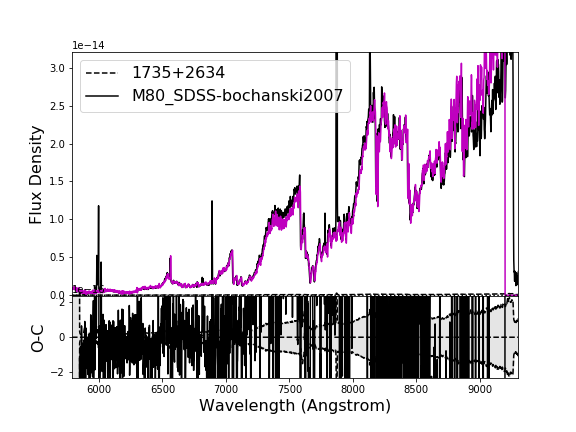

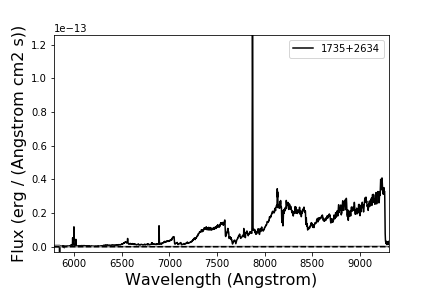

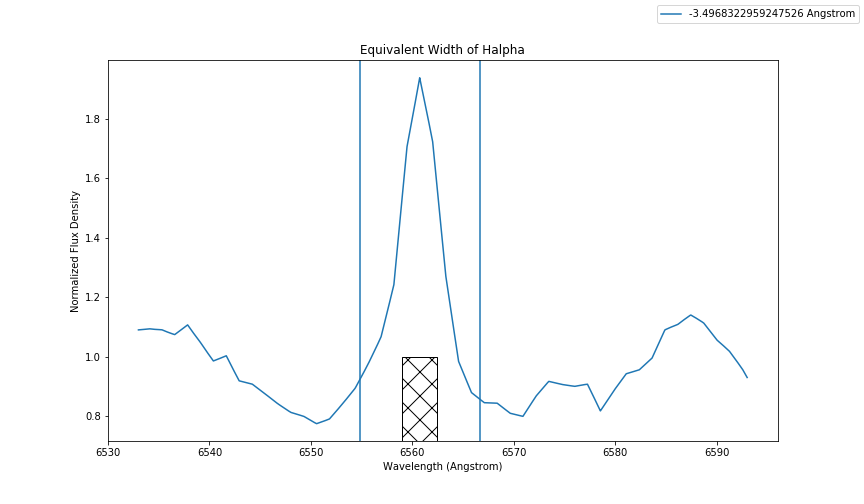

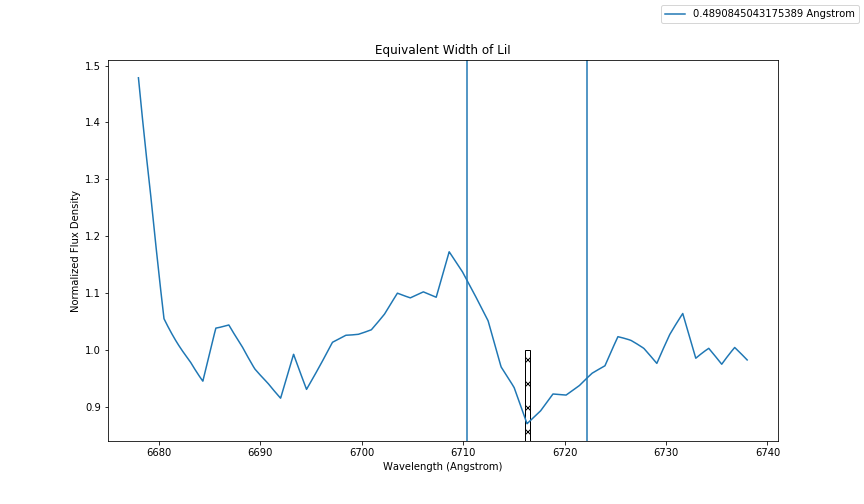

kastRED_J1735+2634_20170813.fits
!


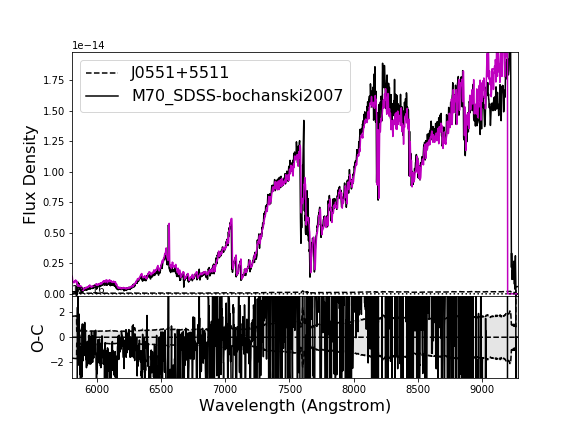

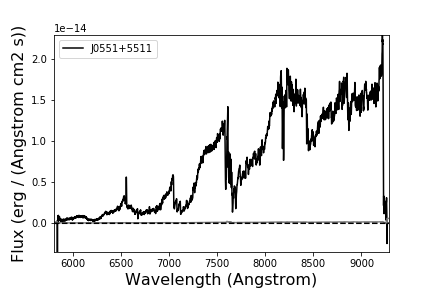

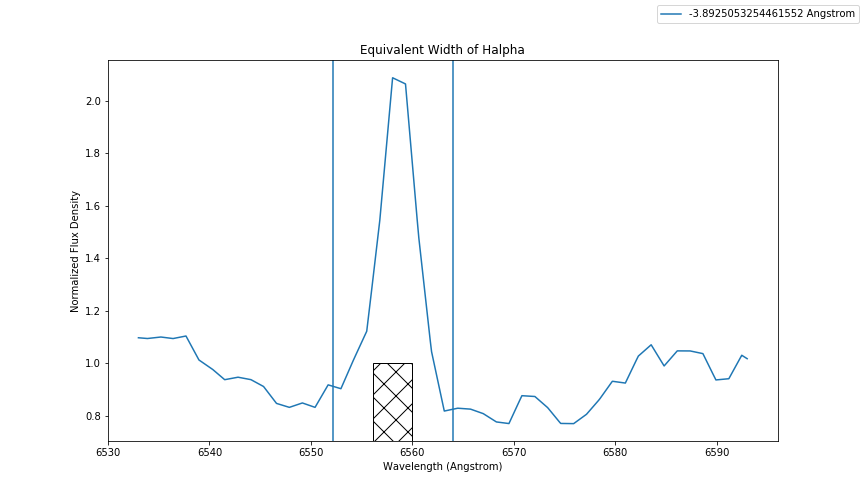

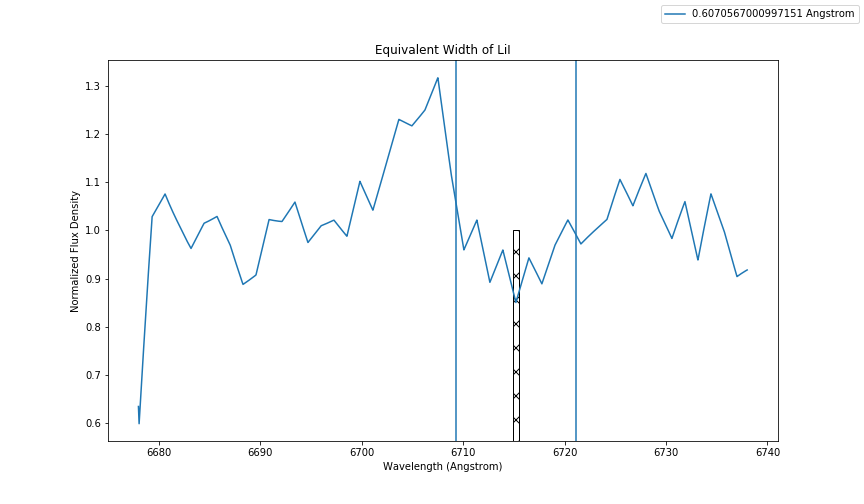

kastRED_J0551+5511_20200304.fits
!


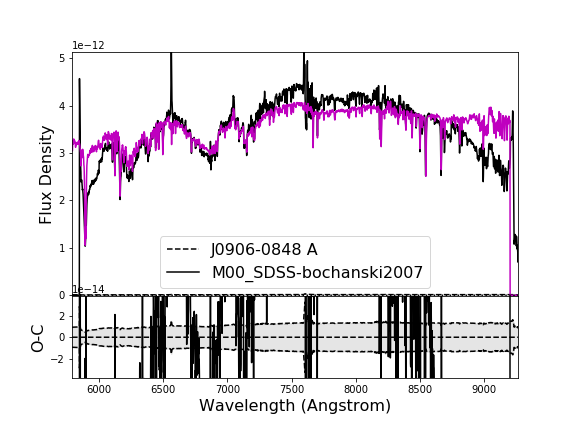

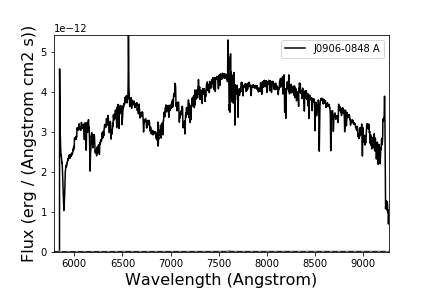

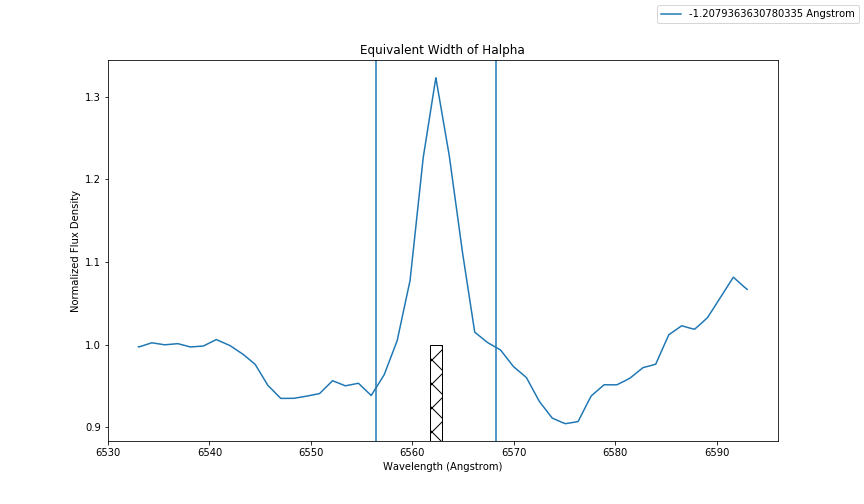

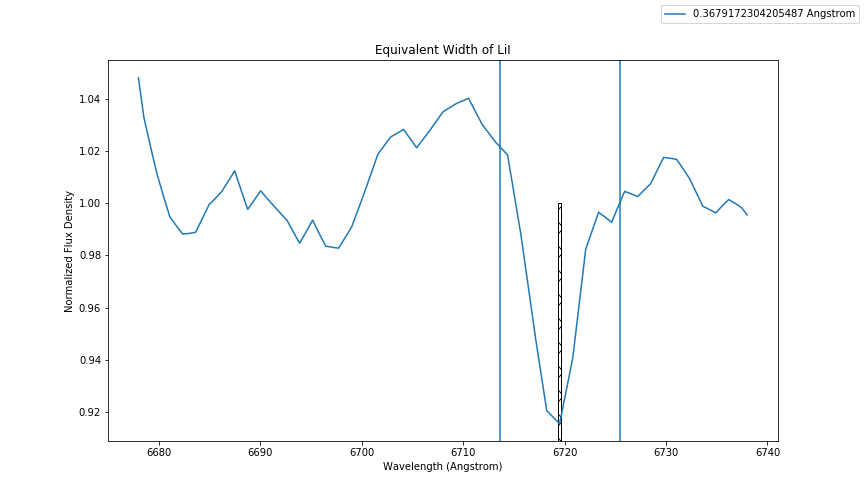

kastRED_J0906-0848A_20191209.fits
lto, scq, !


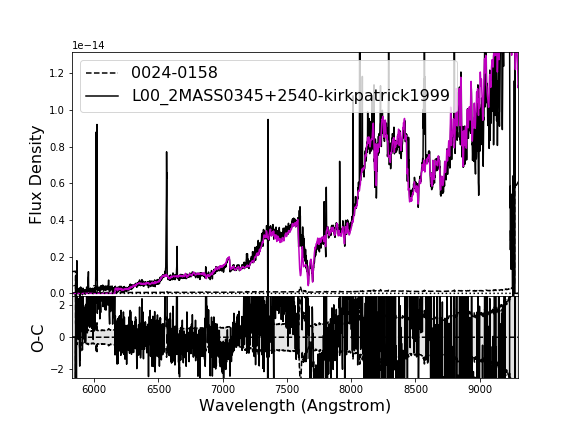

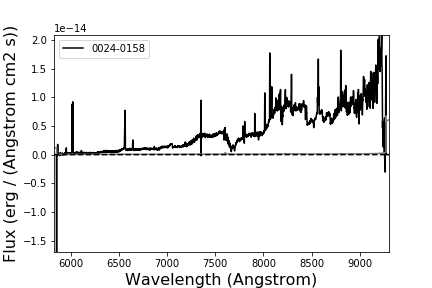

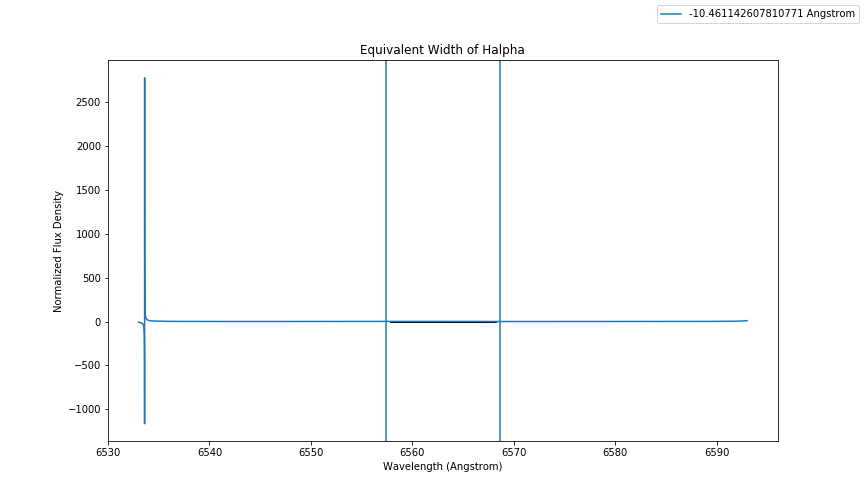

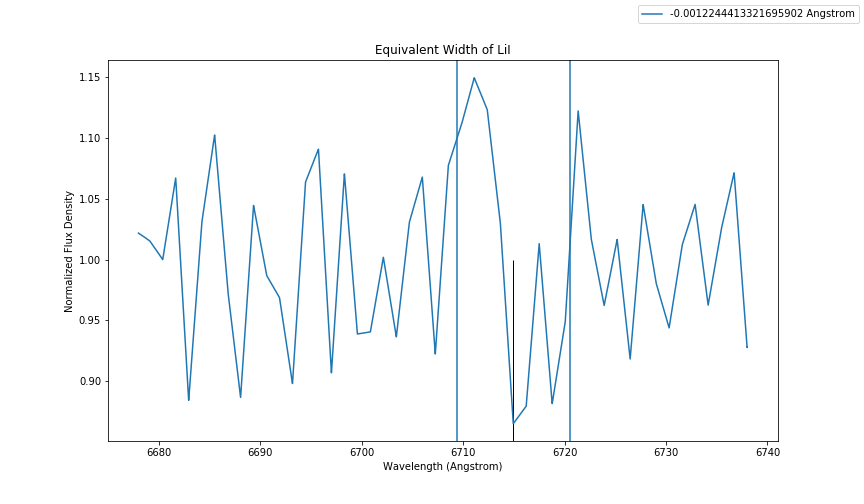

kastRED_J0024-0158_20170817.fits
lto, mcq, !


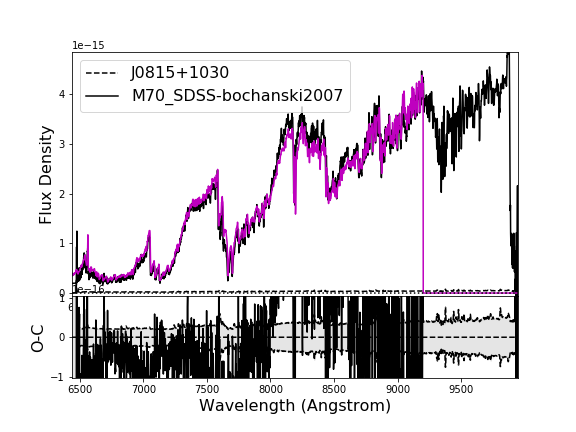

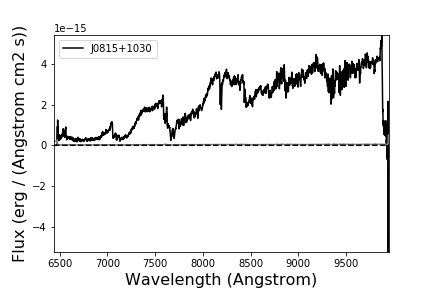

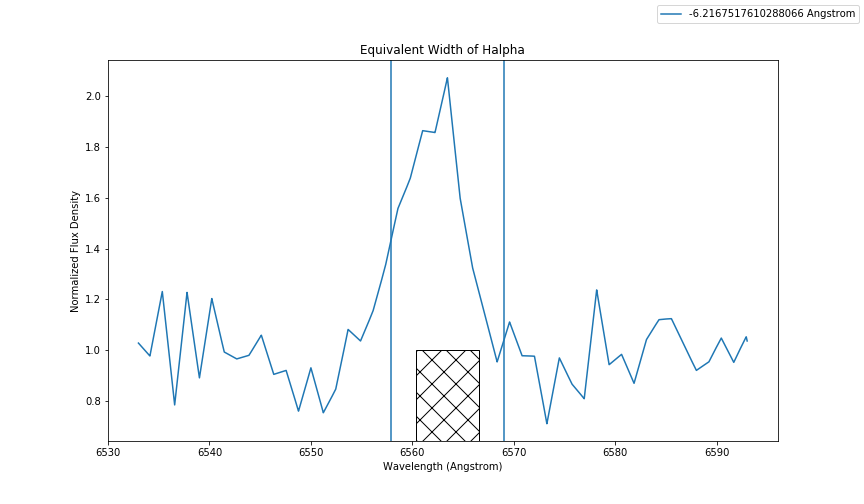

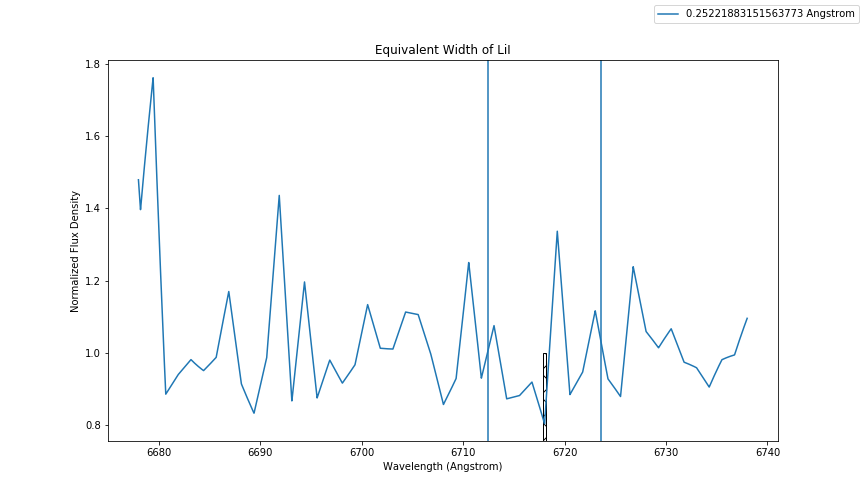

kastRED_J0815+1030_20200203.fits
lto, scq, spt_fixed, !


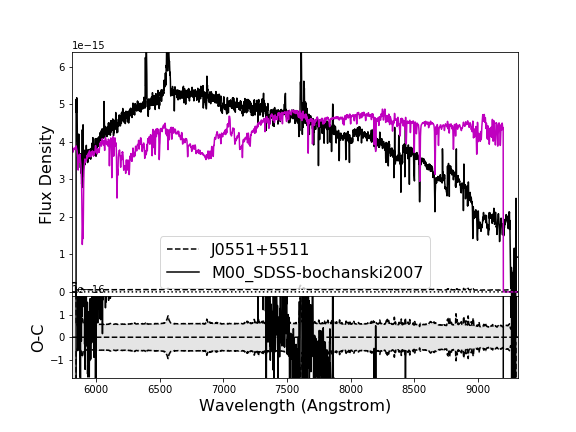

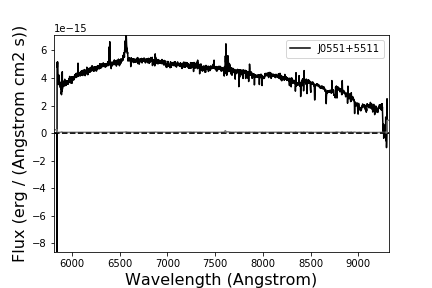

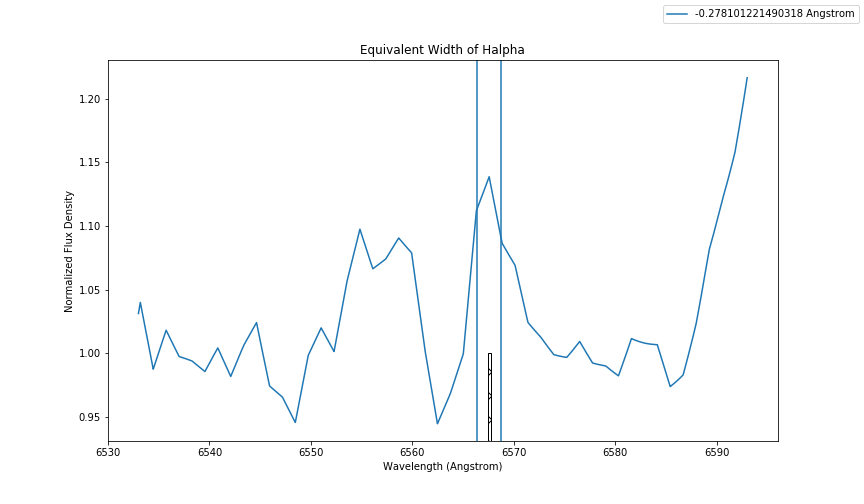

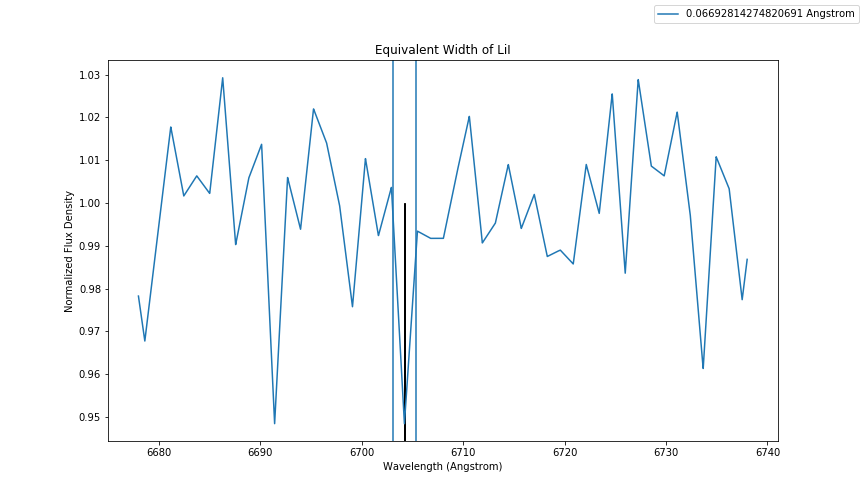

kastRED_J0551+5511B_20200205.fits
OO, !


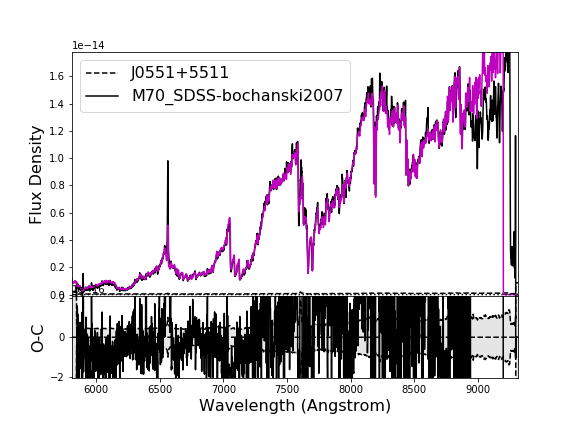

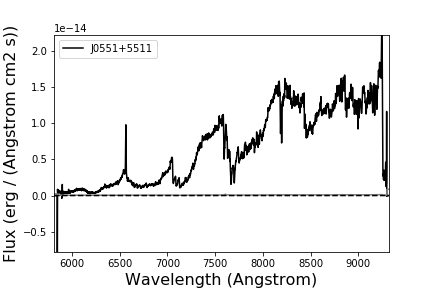

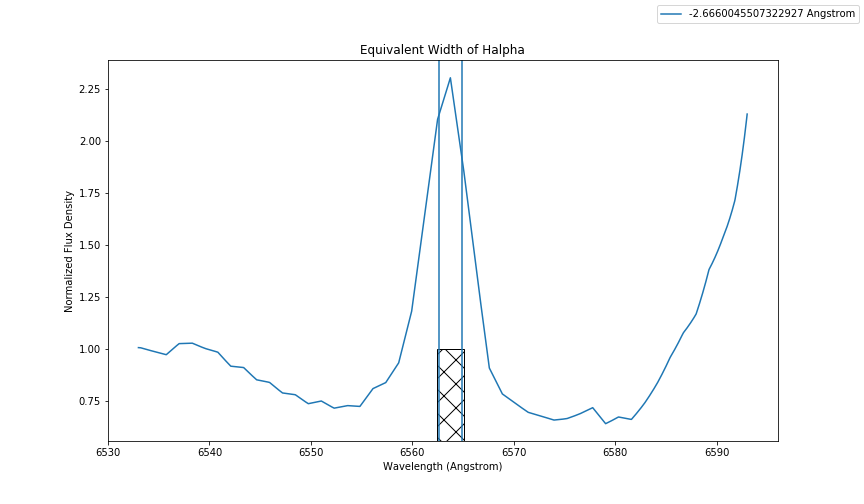

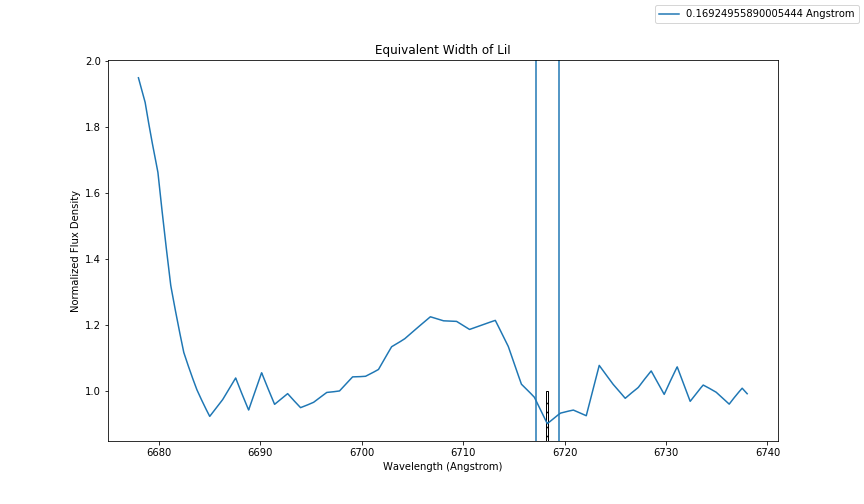

kastRED_J0551+5511_20200205.fits
!


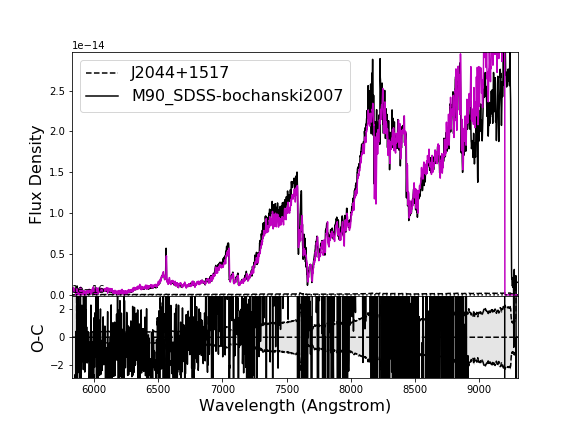

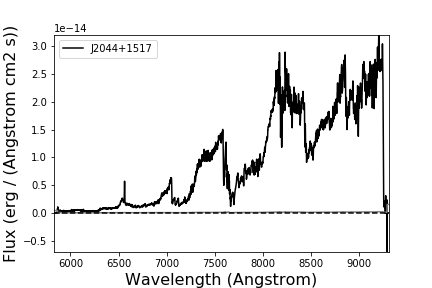

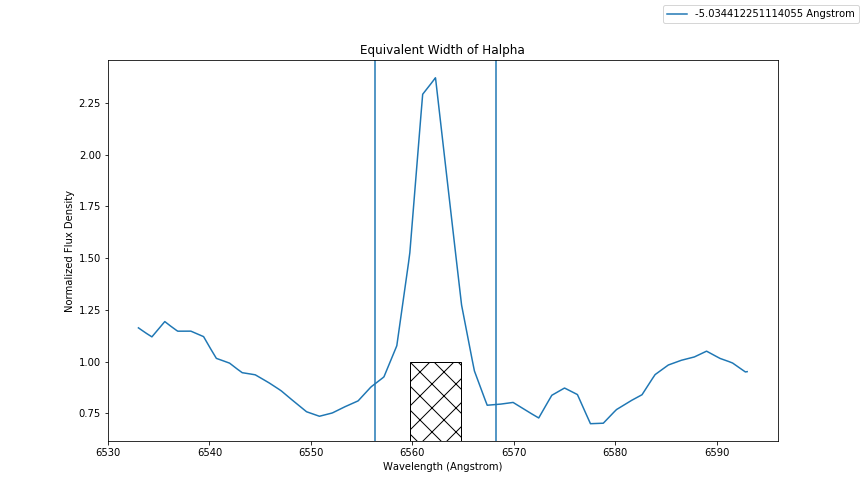

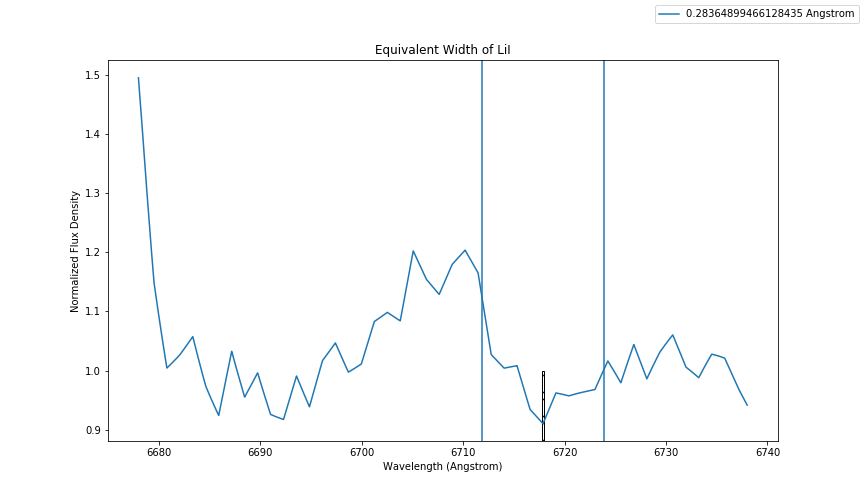

kastRED_J2044+1517_20190918.fits
!


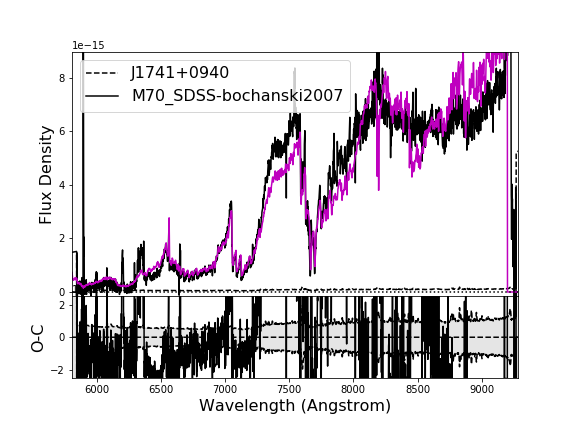

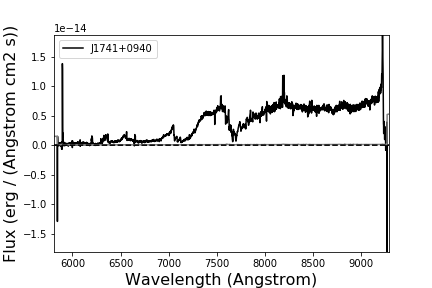

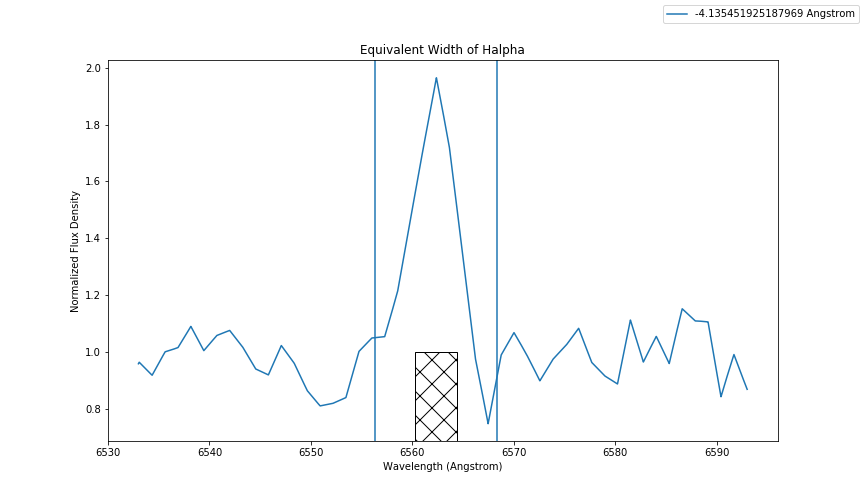

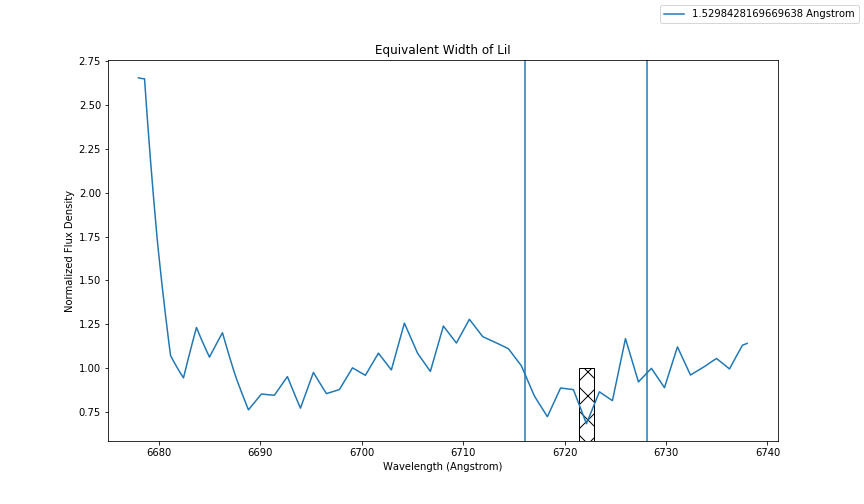

kastRED_J1741+0940_20200305.fits
lto, scq, spt_fixed, !


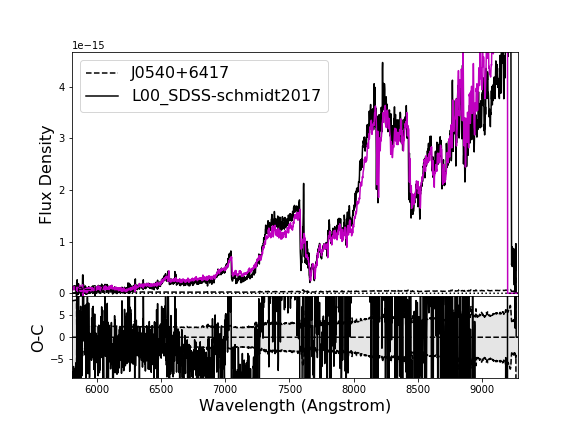

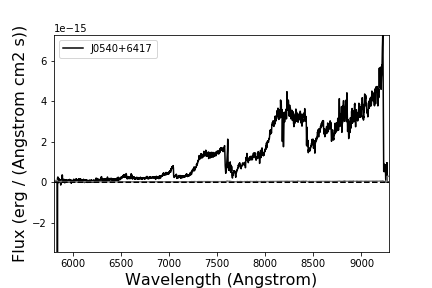

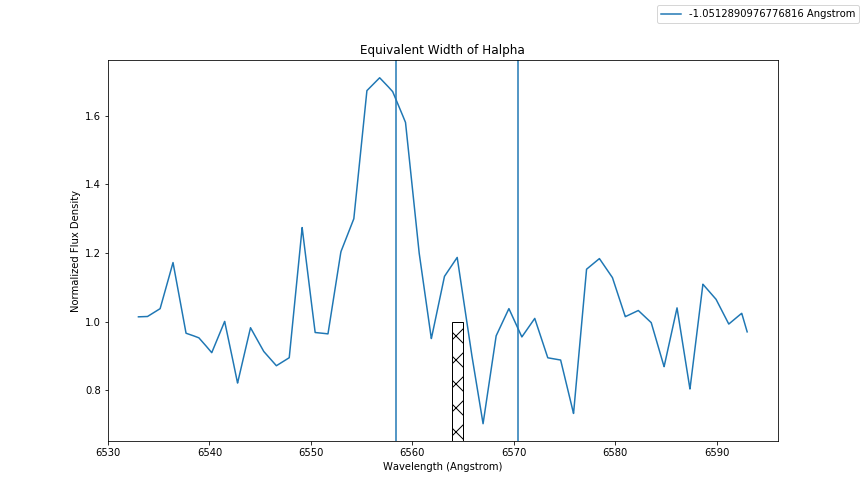

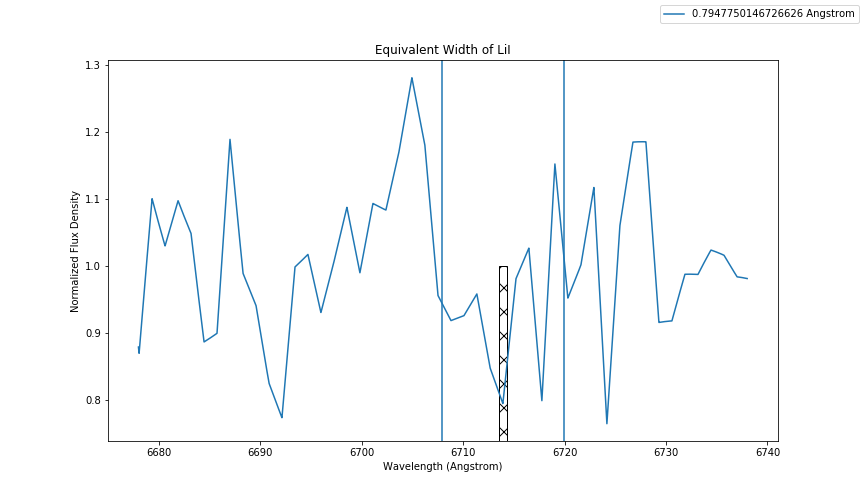

kastRED_J0540+6417_20200304.fits
lto, !


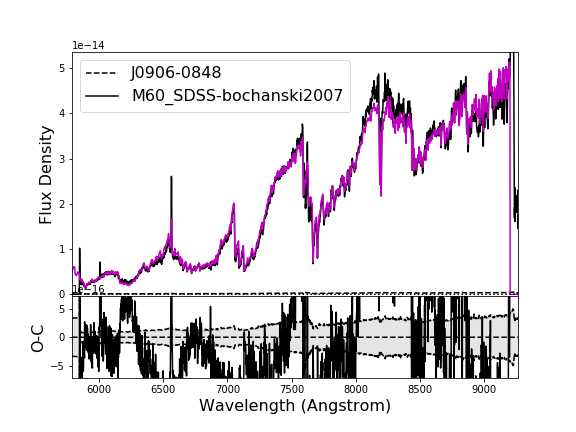

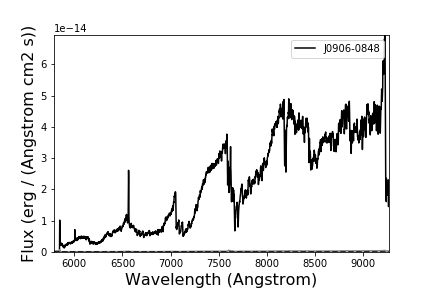

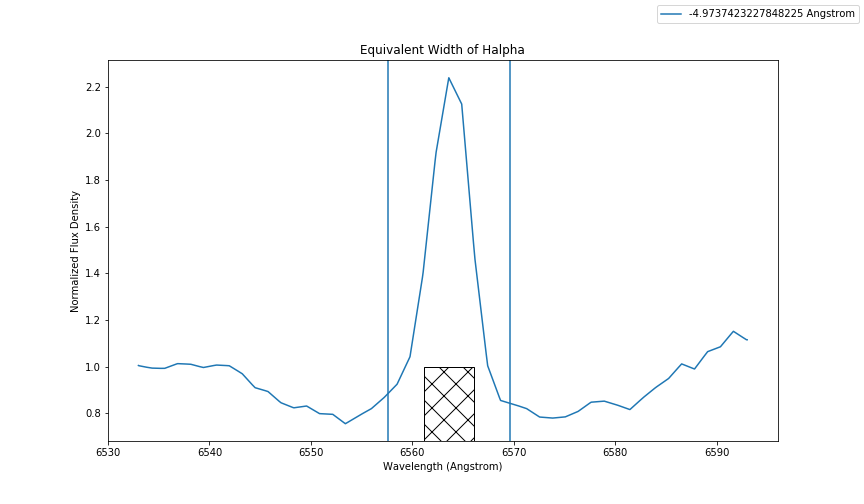

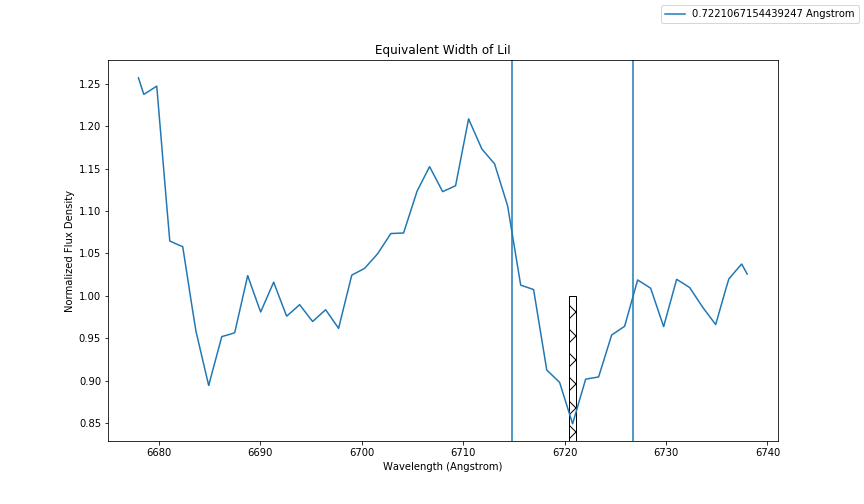

kastRED_J0906-0848B_20191209.fits
lto, !


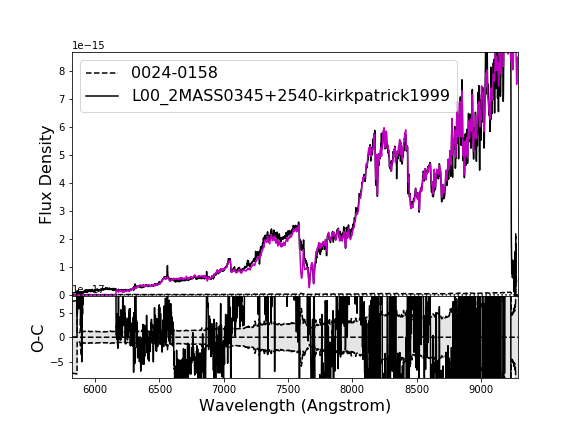

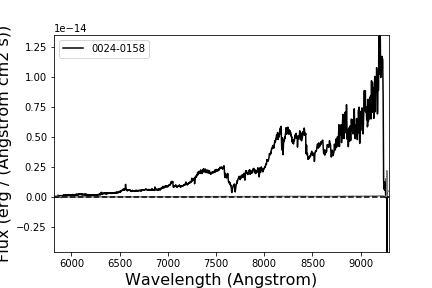

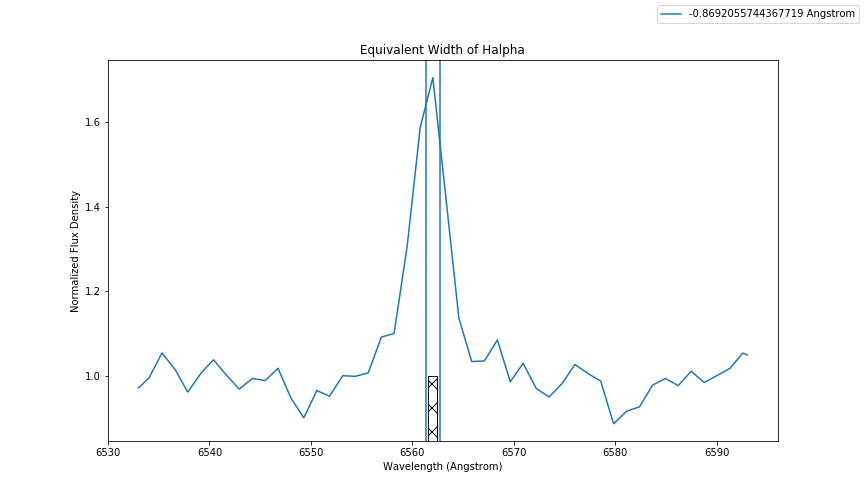

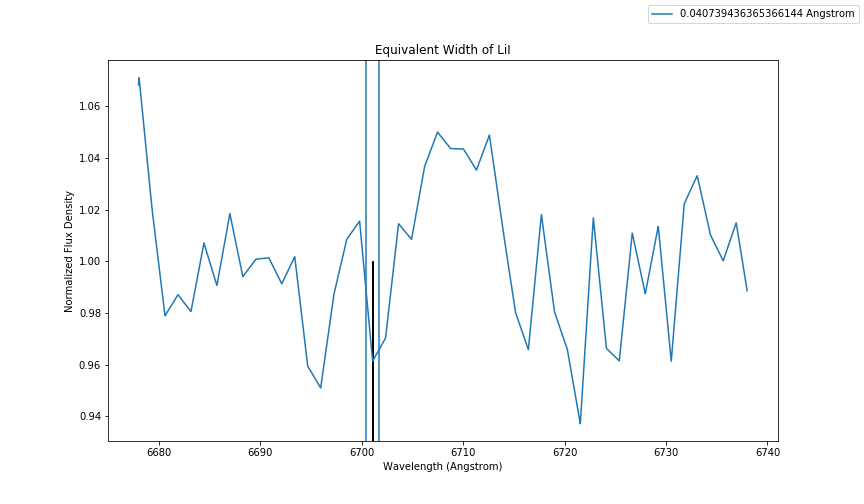

kastRED_J0024-0158_20170823.fits
lto, mcq, !


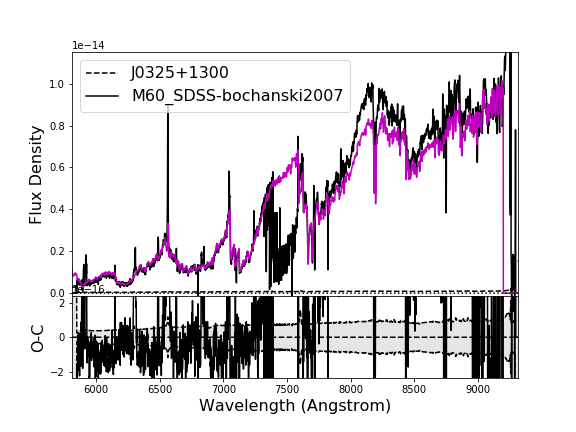

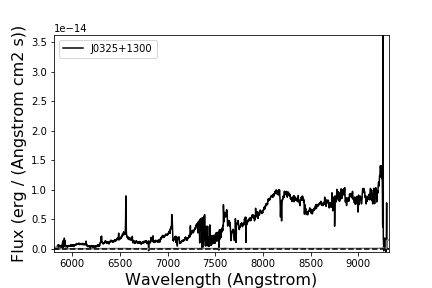

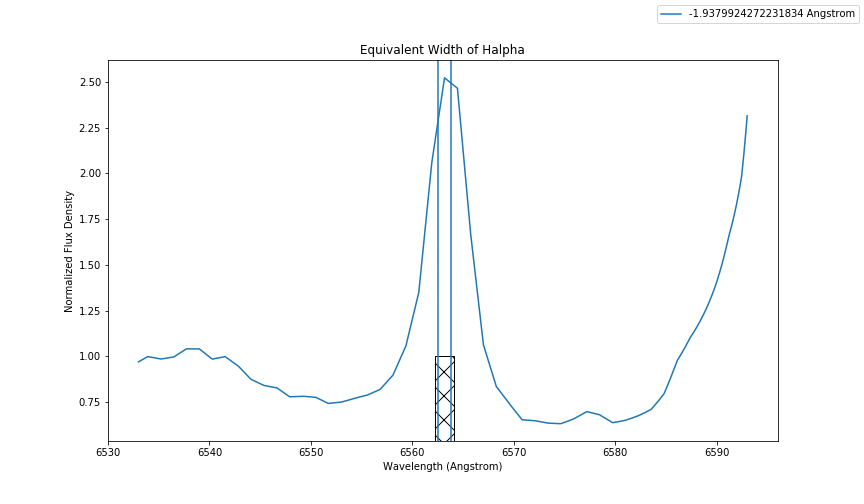

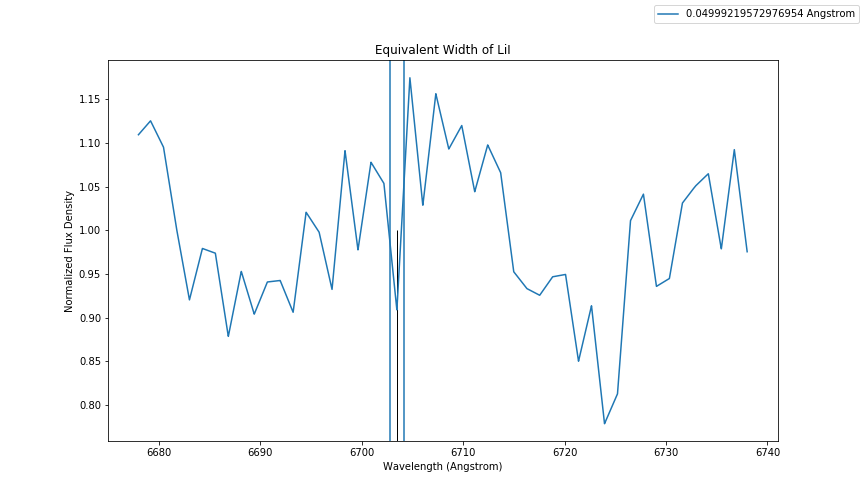

kastRED_J0325+1300_20180308.fits
lto, scq, !, spt_fixed


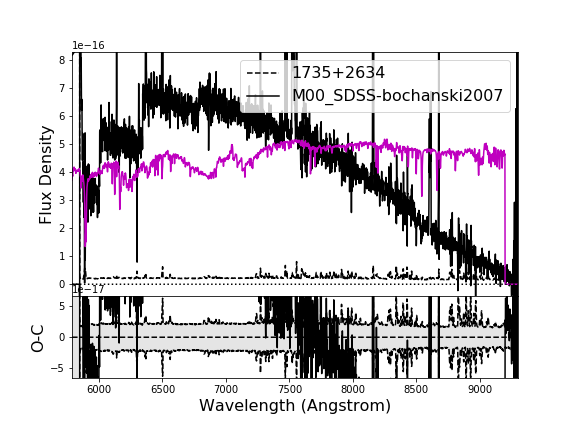

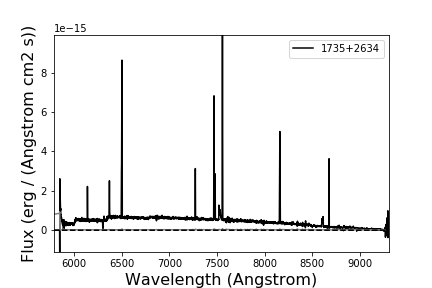

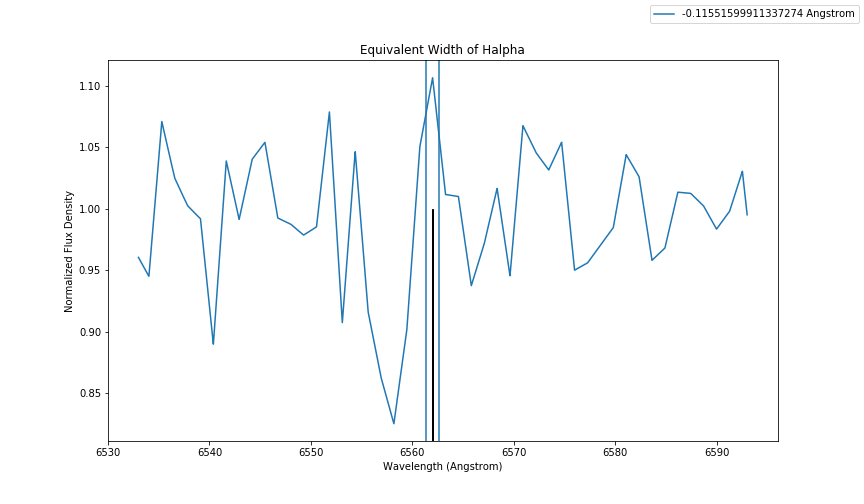

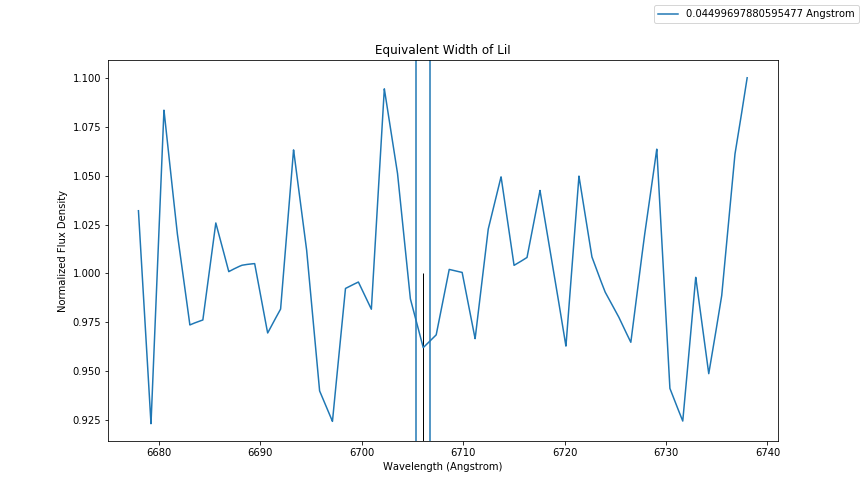

kastRED_J1735+2634B_20170813.fits
OO, S/N, !


In [17]:
display_images(dfa[arr & arr1], QA_path)